<a href="https://colab.research.google.com/github/ashishrajbanshi/park-and-ride/blob/Mehdi_Branch/Park_and_ride.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
from google.colab import drive

# Mount drive
drive.mount('/content/drive')



Mounted at /content/drive


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import zipfile
import os
from google.colab import drive

# Mount drive
drive.mount('/content/drive')

# Path to your GTFS file
gtfs_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/GTFS.zip'

# Method 1: Using zipfile to extract and read individual files
with zipfile.ZipFile(gtfs_path, 'r') as zip_ref:
    # List all files in the zip
    print("Files in GTFS archive:")
    for file in zip_ref.namelist():
        print(f"  - {file}")

    # Read individual GTFS files
    # Core GTFS files typically include:
    stops = pd.read_csv(zip_ref.open('stops.txt'))
    routes = pd.read_csv(zip_ref.open('routes.txt'))
    trips = pd.read_csv(zip_ref.open('trips.txt'))
    stop_times = pd.read_csv(zip_ref.open('stop_times.txt'))

    # Optional files (check if they exist first)
    if 'shapes.txt' in zip_ref.namelist():
        shapes = pd.read_csv(zip_ref.open('shapes.txt'))
    if 'calendar.txt' in zip_ref.namelist():
        calendar = pd.read_csv(zip_ref.open('calendar.txt'))
    if 'calendar_dates.txt' in zip_ref.namelist():
        calendar_dates = pd.read_csv(zip_ref.open('calendar_dates.txt'))
    if 'agency.txt' in zip_ref.namelist():
        agency = pd.read_csv(zip_ref.open('agency.txt'))

# Display basic information about each dataset
print("\n=== STOPS ===")
print(f"Number of stops: {len(stops)}")
print(stops.head())

print("\n=== ROUTES ===")
print(f"Number of routes: {len(routes)}")
print(routes.head())

print("\n=== TRIPS ===")
print(f"Number of trips: {len(trips)}")
print(trips.head())

print("\n=== STOP TIMES ===")
print(f"Number of stop times: {len(stop_times)}")
print(stop_times.head())

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Files in GTFS archive:
  - shapes.txt
  - stop_times.txt
  - stops.txt
  - transfers.txt
  - trips.txt
  - agency.txt
  - calendar.txt
  - calendar_dates.txt
  - fare_attributes.txt
  - fare_rules.txt
  - feed_info.txt
  - frequencies.txt
  - routes.txt

=== STOPS ===
Number of stops: 1246
   stop_id  stop_code                 stop_name  stop_desc   stop_lat  \
0       12       2201  Market & Family Dollar-1        NaN  35.050430   
1       17       2164           Market & 11th 0        NaN  35.043764   
2       18       3074           Market & 12TH-1        NaN  35.042069   
3       19       2204         Market & Cowart 0        NaN  35.040950   
4       21       2217             MARKET + MAIN        NaN  35.036400   

    stop_lon  zone_id  stop_url  location_type  parent_station  stop_timezone  \
0 -85.309610      NaN       NaN            NaN             N

In [ ]:
# 1. BASIC SYSTEM OVERVIEW
print("="*60)
print("CARTA TRANSIT SYSTEM OVERVIEW")
print("="*60)

# Agency info
print("\n📍 AGENCY INFORMATION:")
print(agency[['agency_name', 'agency_url', 'agency_timezone']].to_string())

# System size
print(f"\n📊 SYSTEM STATISTICS:")
print(f"  • Total Stops: {len(stops)}")
print(f"  • Total Routes: {len(routes)}")
print(f"  • Total Trips: {len(trips)}")
print(f"  • Total Stop Times: {len(stop_times)}")
print(f"  • Total Shape Points: {len(shapes)}")

# Route types
route_type_map = {
    0: 'Tram/Light rail', 1: 'Subway/Metro', 2: 'Rail',
    3: 'Bus', 4: 'Ferry', 5: 'Cable car', 6: 'Gondola', 7: 'Funicular'
}
routes['route_type_name'] = routes['route_type'].map(route_type_map)
print("\n🚌 ROUTES BY TYPE:")
print(routes['route_type_name'].value_counts())

# 2. EMPLOYMENT CENTER ANALYSIS
print("\n" + "="*60)
print("EMPLOYMENT CENTER ACCESSIBILITY ANALYSIS")
print("="*60)

# Define major employment centers with actual coordinates
employment_centers = {
    'VW Chattanooga': {'lat': 35.0744, 'lon': -85.1247, 'employees': 4500},
    'BlueCross BlueShield': {'lat': 35.0458, 'lon': -85.3085, 'employees': 4899},
    'Erlanger Hospital': {'lat': 35.0553, 'lon': -85.3096, 'employees': 3500},
    'TVA Downtown': {'lat': 35.0456, 'lon': -85.3097, 'employees': 3786},
    'Amazon Fulfillment': {'lat': 35.0744, 'lon': -85.1247, 'employees': 3312},
    'Hamilton Place Mall Area': {'lat': 35.0867, 'lon': -85.1963, 'employees': 2500}
}

# Function to calculate distance between two points
def calculate_distance(lat1, lon1, lat2, lon2):
    """Calculate distance in miles between two coordinates"""
    from math import radians, cos, sin, asin, sqrt
    R = 3959  # Radius of earth in miles
    lat1, lon1, lat2, lon2 = map(radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a))
    return R * c

# Analyze stops near employment centers
employment_accessibility = []

for center_name, center_info in employment_centers.items():
    # Find stops within 0.5 miles
    nearby_stops = []
    for idx, stop in stops.iterrows():
        dist = calculate_distance(
            center_info['lat'], center_info['lon'],
            stop['stop_lat'], stop['stop_lon']
        )
        if dist <= 0.5:  # Within 0.5 miles
            nearby_stops.append({
                'stop_id': stop['stop_id'],
                'stop_name': stop['stop_name'],
                'distance': round(dist, 3)
            })

    employment_accessibility.append({
        'Employment Center': center_name,
        'Employees': center_info['employees'],
        'Transit Stops (0.5mi)': len(nearby_stops),
        'Nearest Stop': min(nearby_stops, key=lambda x: x['distance'])['stop_name'] if nearby_stops else 'None',
        'Distance to Nearest': min(nearby_stops, key=lambda x: x['distance'])['distance'] if nearby_stops else 'N/A'
    })

emp_df = pd.DataFrame(employment_accessibility)
print("\n🏢 EMPLOYMENT CENTER TRANSIT ACCESSIBILITY:")
print(emp_df.to_string(index=False))

# 3. SERVICE FREQUENCY ANALYSIS
print("\n" + "="*60)
print("SERVICE FREQUENCY ANALYSIS")
print("="*60)

# Analyze service patterns
stop_times['arrival_hour'] = pd.to_datetime(stop_times['arrival_time'].str[:2] + ':00:00', format='%H:%M:%S', errors='coerce').dt.hour

# Peak hour analysis (6-9 AM and 4-7 PM)
morning_peak = stop_times[(stop_times['arrival_hour'] >= 6) & (stop_times['arrival_hour'] < 9)]
evening_peak = stop_times[(stop_times['arrival_hour'] >= 16) & (stop_times['arrival_hour'] < 19)]

print(f"\n⏰ PEAK HOUR SERVICE:")
print(f"  • Morning Peak (6-9 AM): {len(morning_peak)} stop events")
print(f"  • Evening Peak (4-7 PM): {len(evening_peak)} stop events")
print(f"  • Morning Peak Routes: {morning_peak.merge(trips)['route_id'].nunique()}")
print(f"  • Evening Peak Routes: {evening_peak.merge(trips)['route_id'].nunique()}")

# 4. IDENTIFY POTENTIAL PARK-AND-RIDE LOCATIONS
print("\n" + "="*60)
print("POTENTIAL PARK-AND-RIDE ANALYSIS")
print("="*60)

# Identify terminal and major transfer stops
stop_frequency = stop_times.groupby('stop_id').size().reset_index(name='daily_services')
stops_enhanced = stops.merge(stop_frequency, on='stop_id')

# Identify high-service stops
high_service_stops = stops_enhanced[stops_enhanced['daily_services'] > stops_enhanced['daily_services'].quantile(0.9)]

print(f"\n🚉 HIGH-SERVICE STOPS (Top 10%):")
print(f"  • Total: {len(high_service_stops)} stops")
print(f"  • Average daily services: {high_service_stops['daily_services'].mean():.0f}")

# Find stops good for park-and-ride (peripheral high-service stops)
downtown_lat, downtown_lon = 35.0456, -85.3097
stops_enhanced['dist_from_downtown'] = stops_enhanced.apply(
    lambda x: calculate_distance(downtown_lat, downtown_lon, x['stop_lat'], x['stop_lon']), axis=1
)

# Potential park-and-ride: high service, 3-8 miles from downtown
potential_pr = stops_enhanced[
    (stops_enhanced['daily_services'] > stops_enhanced['daily_services'].quantile(0.75)) &
    (stops_enhanced['dist_from_downtown'] >= 3) &
    (stops_enhanced['dist_from_downtown'] <= 8)
].sort_values('daily_services', ascending=False)

print(f"\n🅿️ POTENTIAL PARK-AND-RIDE LOCATIONS:")
print(f"  • Identified {len(potential_pr)} potential locations")
print("\nTop 5 candidates:")
for idx, stop in potential_pr.head().iterrows():
    print(f"  • {stop['stop_name']}: {stop['daily_services']} daily services, {stop['dist_from_downtown']:.1f} mi from downtown")

CARTA TRANSIT SYSTEM OVERVIEW

📍 AGENCY INFORMATION:
  agency_name              agency_url   agency_timezone
0       CARTA  http://www.gocarta.org  America/New_York

📊 SYSTEM STATISTICS:
  • Total Stops: 1246
  • Total Routes: 16
  • Total Trips: 1922
  • Total Stop Times: 83567
  • Total Shape Points: 77923

🚌 ROUTES BY TYPE:
route_type_name
Bus    16
Name: count, dtype: int64

EMPLOYMENT CENTER ACCESSIBILITY ANALYSIS

🏢 EMPLOYMENT CENTER TRANSIT ACCESSIBILITY:
       Employment Center  Employees  Transit Stops (0.5mi)               Nearest Stop  Distance to Nearest
          VW Chattanooga       4500                      4              VOLKSWAGEN DR                0.218
    BlueCross BlueShield       4899                    133     Market & M.L. King Blv                0.052
       Erlanger Hospital       3500                     61 Market & West Aquarium Way                0.035
            TVA Downtown       3786                    133             Market & epb-1                0.02

In [ ]:
# 5. VISUALIZATION
import folium
from folium import plugins

# Create interactive map
map_center = [35.0456, -85.2672]  # Chattanooga center
m = folium.Map(location=map_center, zoom_start=11, tiles='OpenStreetMap')

# Add employment centers
for name, info in employment_centers.items():
    folium.Marker(
        [info['lat'], info['lon']],
        popup=f"<b>{name}</b><br>Employees: {info['employees']:,}",
        tooltip=name,
        icon=folium.Icon(color='red', icon='briefcase', prefix='fa')
    ).add_to(m)

# Add transit stops (color by service frequency)
for idx, stop in stops_enhanced.iterrows():
    if stop['daily_services'] > stops_enhanced['daily_services'].quantile(0.75):
        color = 'green'
        radius = 8
    elif stop['daily_services'] > stops_enhanced['daily_services'].quantile(0.5):
        color = 'blue'
        radius = 5
    else:
        color = 'lightblue'
        radius = 3

    folium.CircleMarker(
        [stop['stop_lat'], stop['stop_lon']],
        radius=radius,
        popup=f"<b>{stop['stop_name']}</b><br>Daily services: {stop['daily_services']}",
        color=color,
        fill=True,
        fillOpacity=0.6
    ).add_to(m)

# Add potential park-and-ride locations
for idx, stop in potential_pr.head(10).iterrows():
    folium.Marker(
        [stop['stop_lat'], stop['stop_lon']],
        popup=f"<b>P+R Candidate: {stop['stop_name']}</b><br>Daily services: {stop['daily_services']}<br>Distance from downtown: {stop['dist_from_downtown']:.1f} mi",
        tooltip="Potential Park & Ride",
        icon=folium.Icon(color='purple', icon='parking', prefix='fa')
    ).add_to(m)

# Add legend
legend_html = '''
<div style="position: fixed;
     bottom: 50px; right: 50px; width: 200px; height: 150px;
     background-color: white; z-index:9999; font-size:14px;
     border:2px solid grey; padding: 10px">
     <p style="margin: 0;"><b>Legend</b></p>
     <p style="margin: 5px;"><span style="color: red;">●</span> Employment Centers</p>
     <p style="margin: 5px;"><span style="color: green;">●</span> High Frequency Stops</p>
     <p style="margin: 5px;"><span style="color: blue;">●</span> Medium Frequency Stops</p>
     <p style="margin: 5px;"><span style="color: purple;">●</span> P+R Candidates</p>
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

# Display map
print("\n📍 Interactive Map Created")
m


📍 Interactive Map Created


In [ ]:
# 6. RURAL CONNECTIVITY ANALYSIS
print("\n" + "="*60)
print("RURAL AREA CONNECTIVITY ANALYSIS")
print("="*60)

# Identify stops in rural counties (based on distance from downtown)
rural_stops = stops_enhanced[stops_enhanced['dist_from_downtown'] > 10]
print(f"\n🌾 RURAL AREA STOPS (>10 miles from downtown):")
print(f"  • Total stops: {len(rural_stops)}")
print(f"  • Average daily services: {rural_stops['daily_services'].mean():.1f}")

# Analyze routes serving both rural and employment areas
routes_analysis = []
for route_id in routes['route_id'].unique():
    route_trips = trips[trips['route_id'] == route_id]['trip_id']
    route_stops = stop_times[stop_times['trip_id'].isin(route_trips)]['stop_id'].unique()
    route_stop_info = stops[stops['stop_id'].isin(route_stops)]

    # Check if route connects rural to employment centers
    serves_rural = any(route_stop_info['stop_id'].isin(rural_stops['stop_id']))

    # Check proximity to employment centers
    serves_employment = False
    for center_name, center_info in employment_centers.items():
        for idx, stop in route_stop_info.iterrows():
            dist = calculate_distance(
                center_info['lat'], center_info['lon'],
                stop['stop_lat'], stop['stop_lon']
            )
            if dist <= 0.5:
                serves_employment = True
                break
        if serves_employment:
            break

    if serves_rural and serves_employment:
        route_name = routes[routes['route_id'] == route_id]['route_short_name'].values[0]
        routes_analysis.append({
            'Route': route_name,
            'Route ID': route_id,
            'Connects Rural to Employment': 'Yes'
        })

if routes_analysis:
    rural_routes_df = pd.DataFrame(routes_analysis)
    print(f"\n🚌 ROUTES CONNECTING RURAL AREAS TO EMPLOYMENT CENTERS:")
    print(rural_routes_df.to_string(index=False))
else:
    print("\n⚠️ No direct routes found connecting rural areas to employment centers")
    print("   This indicates a need for park-and-ride facilities!")

# Summary recommendations
print("\n" + "="*60)
print("RECOMMENDATIONS FOR PARK-AND-RIDE DEVELOPMENT")
print("="*60)
print("""
Based on the GTFS analysis:
1. Focus on high-service stops 3-8 miles from downtown
2. Priority employment centers with limited transit access
3. Consider rural connectivity gaps for new P+R facilities
4. Coordinate with existing high-frequency routes
""")


RURAL AREA CONNECTIVITY ANALYSIS

🌾 RURAL AREA STOPS (>10 miles from downtown):
  • Total stops: 7
  • Average daily services: 17.9

🚌 ROUTES CONNECTING RURAL AREAS TO EMPLOYMENT CENTERS:
Route Route ID Connects Rural to Employment
    3        3                          Yes
    4        4                          Yes

RECOMMENDATIONS FOR PARK-AND-RIDE DEVELOPMENT

Based on the GTFS analysis:
1. Focus on high-service stops 3-8 miles from downtown
2. Priority employment centers with limited transit access
3. Consider rural connectivity gaps for new P+R facilities
4. Coordinate with existing high-frequency routes



In [ ]:
import pandas as pd
import numpy as np
import folium
from folium import plugins
import zipfile
import warnings
warnings.filterwarnings('ignore')

# Read GTFS data
gtfs_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/GTFS.zip'

with zipfile.ZipFile(gtfs_path, 'r') as zip_ref:
    stops = pd.read_csv(zip_ref.open('stops.txt'))
    routes = pd.read_csv(zip_ref.open('routes.txt'))
    trips = pd.read_csv(zip_ref.open('trips.txt'))
    stop_times = pd.read_csv(zip_ref.open('stop_times.txt'))
    shapes = pd.read_csv(zip_ref.open('shapes.txt'))

print(f"✅ Loaded {len(stops)} stops and {len(routes)} routes")

# VW Chattanooga actual location (Enterprise South Industrial Park)
vw_location = {
    'name': 'Volkswagen Chattanooga Assembly Plant',
    'lat': 35.0744,
    'lon': -85.1447,
    'address': '8001 Volkswagen Dr, Chattanooga, TN 37416'
}

# Other major employers for reference
employment_centers = {
    'VW Chattanooga': {'lat': 35.0744, 'lon': -85.1447, 'employees': 4500},
    'Amazon Fulfillment': {'lat': 35.0764, 'lon': -85.1827, 'employees': 3312},
    'Enterprise South Industrial Park': {'lat': 35.0720, 'lon': -85.1550, 'employees': 8000},
    'BlueCross BlueShield': {'lat': 35.0458, 'lon': -85.3085, 'employees': 4899},
    'Downtown Chattanooga': {'lat': 35.0456, 'lon': -85.3097, 'employees': 10000}
}

✅ Loaded 1246 stops and 16 routes


In [ ]:
# CREATE COMPREHENSIVE MAP WITH ALL STOPS AND ROUTES

# Initialize map centered on VW
map_vw = folium.Map(
    location=[vw_location['lat'], vw_location['lon']],
    zoom_start=12,
    tiles='OpenStreetMap'
)

# Add different tile layers for better visualization
folium.TileLayer('CartoDB positron', name='Light Map').add_to(map_vw)
folium.TileLayer('CartoDB dark_matter', name='Dark Map').add_to(map_vw)

# 1. ADD ALL TRANSIT STOPS
print("Adding all transit stops to map...")

# Calculate service frequency for each stop
stop_frequency = stop_times.groupby('stop_id').size().reset_index(name='daily_services')
stops_with_freq = stops.merge(stop_frequency, on='stop_id', how='left')
stops_with_freq['daily_services'] = stops_with_freq['daily_services'].fillna(0)

# Create feature groups for better organization
all_stops_group = folium.FeatureGroup(name='All Transit Stops', show=True)
high_freq_group = folium.FeatureGroup(name='High Frequency Stops', show=True)
vw_area_group = folium.FeatureGroup(name='VW Area Stops (2mi radius)', show=True)

# Function to calculate distance
def calculate_distance(lat1, lon1, lat2, lon2):
    from math import radians, cos, sin, asin, sqrt
    R = 3959  # Earth radius in miles
    lat1, lon1, lat2, lon2 = map(radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a))
    return R * c

# Add each stop to the map
for idx, stop in stops_with_freq.iterrows():
    # Calculate distance from VW
    dist_from_vw = calculate_distance(
        vw_location['lat'], vw_location['lon'],
        stop['stop_lat'], stop['stop_lon']
    )

    # Determine stop characteristics
    is_near_vw = dist_from_vw <= 2  # Within 2 miles of VW
    is_high_freq = stop['daily_services'] > stops_with_freq['daily_services'].quantile(0.75)

    # Set color and size based on characteristics
    if is_near_vw:
        color = 'red'
        radius = 8
        opacity = 0.9
    elif is_high_freq:
        color = 'green'
        radius = 6
        opacity = 0.7
    else:
        color = 'blue'
        radius = 4
        opacity = 0.5

    # Create popup text
    popup_text = f"""
    <b>{stop['stop_name']}</b><br>
    Stop ID: {stop['stop_id']}<br>
    Daily Services: {int(stop['daily_services'])}<br>
    Distance from VW: {dist_from_vw:.2f} miles
    """

    marker = folium.CircleMarker(
        location=[stop['stop_lat'], stop['stop_lon']],
        radius=radius,
        popup=folium.Popup(popup_text, max_width=300),
        tooltip=stop['stop_name'],
        color=color,
        fill=True,
        fillColor=color,
        fillOpacity=opacity,
        weight=2
    )

    # Add to appropriate groups
    marker.add_to(all_stops_group)
    if is_high_freq:
        marker.add_to(high_freq_group)
    if is_near_vw:
        marker.add_to(vw_area_group)

# Add groups to map
all_stops_group.add_to(map_vw)
high_freq_group.add_to(map_vw)
vw_area_group.add_to(map_vw)

print(f"✅ Added {len(stops)} stops to map")

Adding all transit stops to map...
✅ Added 1246 stops to map


In [ ]:
# 2. ADD TRANSIT ROUTES (SHAPES)

print("Processing and adding transit routes...")

# Get unique routes and their colors
route_colors = {}
for idx, route in routes.iterrows():
    # Use route color if available, otherwise assign based on route type
    if 'route_color' in routes.columns and pd.notna(route['route_color']):
        route_colors[route['route_id']] = f"#{route['route_color']}"
    else:
        # Default colors by route type
        route_type_colors = {0: '#FF0000', 1: '#00FF00', 2: '#0000FF', 3: '#FFA500'}
        route_colors[route['route_id']] = route_type_colors.get(route['route_type'], '#808080')

# Group shapes by shape_id and draw routes
shapes_sorted = shapes.sort_values(['shape_id', 'shape_pt_sequence'])
unique_shapes = shapes_sorted['shape_id'].unique()

# Create route lines feature group
routes_group = folium.FeatureGroup(name='Transit Routes', show=True)
vw_routes_group = folium.FeatureGroup(name='Routes Near VW', show=True)

# For each shape, check if it passes near VW
routes_near_vw = set()
for shape_id in unique_shapes[:50]:  # Limit for performance, remove [:50] for all routes
    shape_points = shapes_sorted[shapes_sorted['shape_id'] == shape_id]

    # Create list of coordinates
    route_coords = [[row['shape_pt_lat'], row['shape_pt_lon']]
                   for idx, row in shape_points.iterrows()]

    # Check if route passes near VW (within 2 miles)
    near_vw = False
    for coord in route_coords:
        dist = calculate_distance(vw_location['lat'], vw_location['lon'],
                                coord[0], coord[1])
        if dist <= 2:
            near_vw = True
            # Find which route this shape belongs to
            trip_with_shape = trips[trips['shape_id'] == shape_id].iloc[0] if len(trips[trips['shape_id'] == shape_id]) > 0 else None
            if trip_with_shape is not None:
                routes_near_vw.add(trip_with_shape['route_id'])
            break

    # Get route info for this shape
    trip_with_shape = trips[trips['shape_id'] == shape_id].iloc[0] if len(trips[trips['shape_id'] == shape_id]) > 0 else None
    if trip_with_shape is not None:
        route_info = routes[routes['route_id'] == trip_with_shape['route_id']].iloc[0]
        route_name = route_info.get('route_short_name', 'Unknown')
        route_color = route_colors.get(trip_with_shape['route_id'], '#0000FF')

        # Create polyline
        route_line = folium.PolyLine(
            locations=route_coords,
            color=route_color if not near_vw else '#FF0000',
            weight=4 if near_vw else 2,
            opacity=0.8 if near_vw else 0.5,
            popup=f"Route: {route_name}",
            tooltip=f"Route {route_name}"
        )

        route_line.add_to(routes_group)
        if near_vw:
            route_line.add_to(vw_routes_group)

routes_group.add_to(map_vw)
vw_routes_group.add_to(map_vw)

print(f"✅ Added transit routes to map")
print(f"📍 Found {len(routes_near_vw)} routes serving VW area")

Processing and adding transit routes...
✅ Added transit routes to map
📍 Found 1 routes serving VW area


In [ ]:
import pandas as pd
import numpy as np
import folium
import zipfile
import warnings
warnings.filterwarnings('ignore')

# Read GTFS data
gtfs_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/GTFS.zip'

with zipfile.ZipFile(gtfs_path, 'r') as zip_ref:
    stops = pd.read_csv(zip_ref.open('stops.txt'))
    routes = pd.read_csv(zip_ref.open('routes.txt'))
    trips = pd.read_csv(zip_ref.open('trips.txt'))
    stop_times = pd.read_csv(zip_ref.open('stop_times.txt'))
    shapes = pd.read_csv(zip_ref.open('shapes.txt'))

print(f"✅ Loaded {len(stops)} stops and {len(routes)} routes")

# VW Chattanooga location
vw_location = {
    'name': 'Volkswagen Chattanooga Assembly Plant',
    'lat': 35.0744,
    'lon': -85.1447
}

# Calculate distance function
def calculate_distance(lat1, lon1, lat2, lon2):
    from math import radians, cos, sin, asin, sqrt
    R = 3959  # Earth radius in miles
    lat1, lon1, lat2, lon2 = map(radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a))
    return R * c


    # CREATE A SIMPLE, WORKING MAP

# Create map with default OpenStreetMap tiles (most reliable)
m = folium.Map(
    location=[35.0456, -85.2672],  # Chattanooga center
    zoom_start=11
)

print("Adding stops to map...")

# Calculate stop frequencies
stop_frequency = stop_times.groupby('stop_id').size().reset_index(name='daily_services')
stops_with_freq = stops.merge(stop_frequency, on='stop_id', how='left')
stops_with_freq['daily_services'] = stops_with_freq['daily_services'].fillna(0)

# Add VW location FIRST with a big red marker
folium.Marker(
    location=[vw_location['lat'], vw_location['lon']],
    popup="<b>VW Chattanooga Plant</b><br>4,500 employees",
    tooltip="VW Plant",
    icon=folium.Icon(color='red', icon='car', prefix='fa', icon_color='white')
).add_to(m)

# Add a circle around VW to make it more visible
folium.Circle(
    location=[vw_location['lat'], vw_location['lon']],
    radius=805,  # 0.5 miles in meters
    popup='0.5 mile radius from VW',
    color='red',
    fill=True,
    fillOpacity=0.2
).add_to(m)

# Add all stops
stop_count = 0
for idx, stop in stops_with_freq.iterrows():
    # Calculate distance from VW
    dist_from_vw = calculate_distance(
        vw_location['lat'], vw_location['lon'],
        stop['stop_lat'], stop['stop_lon']
    )

    # Color based on distance from VW
    if dist_from_vw <= 2:
        color = 'red'
        radius = 8
    elif dist_from_vw <= 5:
        color = 'orange'
        radius = 6
    else:
        color = 'blue'
        radius = 4

    folium.CircleMarker(
        location=[stop['stop_lat'], stop['stop_lon']],
        radius=radius,
        popup=f"{stop['stop_name']}<br>Distance from VW: {dist_from_vw:.1f} mi<br>Daily services: {int(stop['daily_services'])}",
        tooltip=stop['stop_name'],
        color=color,
        fill=True,
        fillOpacity=0.7
    ).add_to(m)

    stop_count += 1

print(f"✅ Added {stop_count} stops to map")
print("🔴 Red = Stops within 2 miles of VW")
print("🟠 Orange = Stops 2-5 miles from VW")
print("🔵 Blue = Stops >5 miles from VW")

# Display the map
m

✅ Loaded 1246 stops and 16 routes
Adding stops to map...
✅ Added 1246 stops to map
🔴 Red = Stops within 2 miles of VW
🟠 Orange = Stops 2-5 miles from VW
🔵 Blue = Stops >5 miles from VW


In [ ]:
# DETAILED VW AREA TRANSIT ANALYSIS

print("\n" + "="*60)
print("VW CHATTANOOGA TRANSIT ACCESSIBILITY ANALYSIS")
print("="*60)

# Find all stops within different radii of VW
radii = [0.5, 1.0, 2.0, 3.0]
vw_accessibility = {}

for radius in radii:
    nearby_stops = []
    for idx, stop in stops_with_freq.iterrows():
        dist = calculate_distance(
            vw_location['lat'], vw_location['lon'],
            stop['stop_lat'], stop['stop_lon']
        )
        if dist <= radius:
            nearby_stops.append({
                'stop_id': stop['stop_id'],
                'stop_name': stop['stop_name'],
                'distance': round(dist, 2),
                'daily_services': int(stop['daily_services'])
            })

    vw_accessibility[radius] = nearby_stops

# Print analysis
print(f"\n📍 VW PLANT LOCATION:")
print(f"   Address: {vw_location['address']}")
print(f"   Coordinates: ({vw_location['lat']:.4f}, {vw_location['lon']:.4f})")

print(f"\n🚌 TRANSIT STOPS BY DISTANCE FROM VW:")
for radius, stops_list in vw_accessibility.items():
    print(f"\n   Within {radius} miles: {len(stops_list)} stops")
    if stops_list and radius <= 1.0:  # Show details for close stops
        print("   Top stops by service frequency:")
        sorted_stops = sorted(stops_list, key=lambda x: x['daily_services'], reverse=True)[:3]
        for stop in sorted_stops:
            print(f"     • {stop['stop_name']}: {stop['distance']} mi, {stop['daily_services']} daily services")

# Analyze routes serving VW area
print(f"\n🚍 ROUTES SERVING VW AREA:")
if routes_near_vw:
    for route_id in list(routes_near_vw)[:10]:  # Show first 10
        route_info = routes[routes['route_id'] == route_id].iloc[0]
        print(f"   • Route {route_info['route_short_name']}: {route_info.get('route_long_name', 'N/A')}")
else:
    print("   ⚠️ No direct routes found within 2 miles of VW")

# Recommendations
print(f"\n💡 PARK-AND-RIDE RECOMMENDATIONS FOR VW:")
if len(vw_accessibility[0.5]) == 0:
    print("   ⚠️ No stops within walking distance (0.5 mi) - CRITICAL GAP")
    print("   → Recommend shuttle service or new stop placement")
if len(vw_accessibility[2.0]) < 5:
    print("   ⚠️ Limited transit access within 2 miles")
    print("   → Establish park-and-ride facilities at nearest high-frequency stops")

# Find nearest high-frequency stops for park-and-ride
high_freq_stops = stops_with_freq[stops_with_freq['daily_services'] > stops_with_freq['daily_services'].quantile(0.75)]
high_freq_stops['dist_from_vw'] = high_freq_stops.apply(
    lambda x: calculate_distance(vw_location['lat'], vw_location['lon'], x['stop_lat'], x['stop_lon']),
    axis=1
)
nearest_high_freq = high_freq_stops.nsmallest(5, 'dist_from_vw')

print(f"\n🅿️ NEAREST HIGH-FREQUENCY STOPS FOR PARK-AND-RIDE:")
for idx, stop in nearest_high_freq.iterrows():
    print(f"   • {stop['stop_name']}: {stop['dist_from_vw']:.1f} mi, {int(stop['daily_services'])} daily services")

print("\n" + "="*60)


VW CHATTANOOGA TRANSIT ACCESSIBILITY ANALYSIS

📍 VW PLANT LOCATION:
   Address: 8001 Volkswagen Dr, Chattanooga, TN 37416
   Coordinates: (35.0744, -85.1447)

🚌 TRANSIT STOPS BY DISTANCE FROM VW:

   Within 0.5 miles: 3 stops
   Top stops by service frequency:
     • Discovery Dr & Integrated Dr: 0.38 mi, 22 daily services
     • Volkswagen Dr & Amazon-SS: 0.33 mi, 17 daily services
     • Volkswagen Dr & Amazon NS-1: 0.3 mi, 17 daily services

   Within 1.0 miles: 13 stops
   Top stops by service frequency:
     • Hickory Valley & Bonny Oaks Drive-1: 0.66 mi, 22 daily services
     • Discovery Dr & Integrated Dr: 0.38 mi, 22 daily services
     • Hickory Valley Rd & Discovery Dr-1: 0.58 mi, 22 daily services

   Within 2.0 miles: 26 stops

   Within 3.0 miles: 71 stops

🚍 ROUTES SERVING VW AREA:
   • Route 3: Enterprise South

💡 PARK-AND-RIDE RECOMMENDATIONS FOR VW:

🅿️ NEAREST HIGH-FREQUENCY STOPS FOR PARK-AND-RIDE:
   • Shallowford Rd. & Center-1: 2.3 mi, 102 daily services
   • Sh

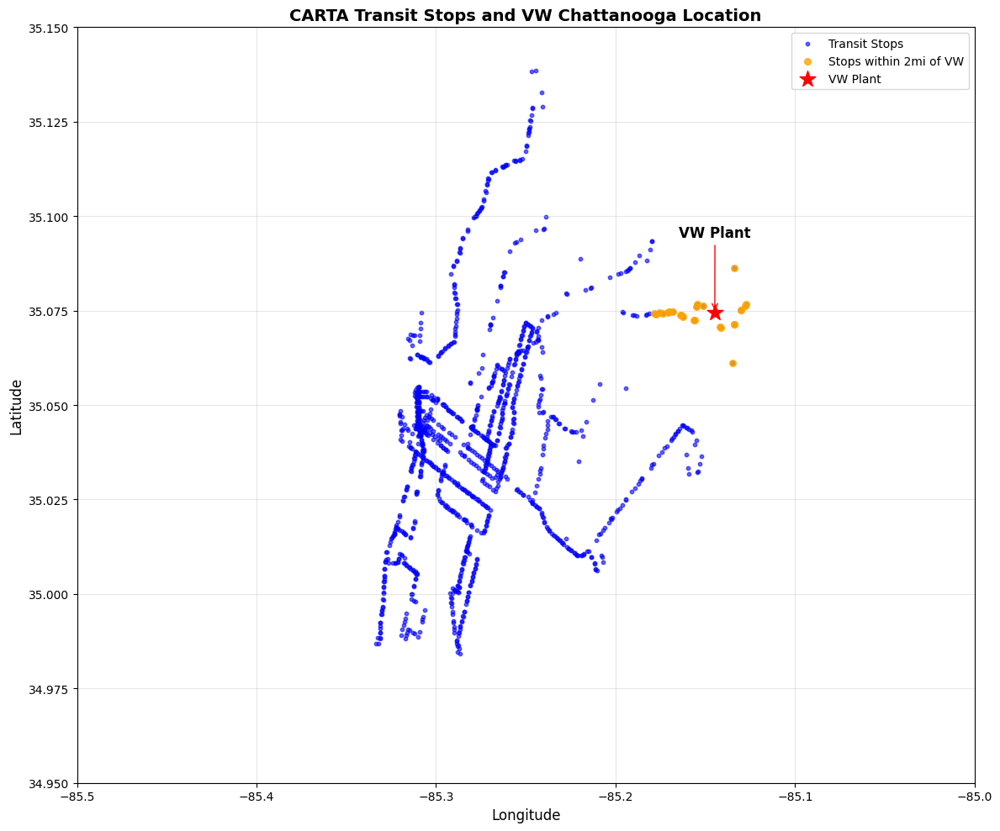


VW TRANSIT ACCESSIBILITY ANALYSIS
Total stops in system: 1246
Stops within 0.5 miles of VW: 3
Stops within 1 mile of VW: 13
Stops within 2 miles of VW: 26

Nearest stops to VW:
  • Volkswagen Dr & Amazon NS-1: 0.30 miles
  • Volkswagen Dr & Amazon-SS: 0.33 miles
  • Discovery Dr & Integrated Dr: 0.38 miles
  • Hickory Valley & Discovery Dr NB-1: 0.57 miles
  • Hickory Valley Rd & Discovery Dr-1: 0.58 miles


In [ ]:
# STATIC MAP USING MATPLOTLIB (Alternative if Folium isn't working)

import matplotlib.pyplot as plt

# Create figure
fig, ax = plt.subplots(figsize=(12, 10))

# Plot all stops
ax.scatter(stops['stop_lon'], stops['stop_lat'],
           c='blue', s=10, alpha=0.6, label='Transit Stops')

# Calculate distances and highlight stops near VW
stops['dist_from_vw'] = stops.apply(
    lambda x: calculate_distance(vw_location['lat'], vw_location['lon'],
                                x['stop_lat'], x['stop_lon']), axis=1
)

# Highlight stops near VW
vw_nearby = stops[stops['dist_from_vw'] <= 2]
ax.scatter(vw_nearby['stop_lon'], vw_nearby['stop_lat'],
           c='orange', s=30, alpha=0.8, label='Stops within 2mi of VW')

# Plot VW location
ax.scatter(vw_location['lon'], vw_location['lat'],
           c='red', s=200, marker='*', label='VW Plant', zorder=5)

# Add labels for major areas
ax.annotate('VW Plant', xy=(vw_location['lon'], vw_location['lat']),
            xytext=(vw_location['lon']-0.02, vw_location['lat']+0.02),
            fontsize=12, fontweight='bold',
            arrowprops=dict(arrowstyle='->', color='red'))

# Set labels and title
ax.set_xlabel('Longitude', fontsize=12)
ax.set_ylabel('Latitude', fontsize=12)
ax.set_title('CARTA Transit Stops and VW Chattanooga Location', fontsize=14, fontweight='bold')
ax.legend()
ax.grid(True, alpha=0.3)

# Set axis limits to focus on Chattanooga area
ax.set_xlim([-85.5, -85.0])
ax.set_ylim([34.95, 35.15])

plt.tight_layout()
plt.show()

# Print analysis
print("\n" + "="*50)
print("VW TRANSIT ACCESSIBILITY ANALYSIS")
print("="*50)
print(f"Total stops in system: {len(stops)}")
print(f"Stops within 0.5 miles of VW: {len(stops[stops['dist_from_vw'] <= 0.5])}")
print(f"Stops within 1 mile of VW: {len(stops[stops['dist_from_vw'] <= 1])}")
print(f"Stops within 2 miles of VW: {len(stops[stops['dist_from_vw'] <= 2])}")

# Show nearest stops
nearest_stops = stops.nsmallest(5, 'dist_from_vw')[['stop_name', 'dist_from_vw']]
print("\nNearest stops to VW:")
for idx, stop in nearest_stops.iterrows():
    print(f"  • {stop['stop_name']}: {stop['dist_from_vw']:.2f} miles")

# 🎈 **All the valuable data  can be extracted: from GTFS files and how they're useful for your park-and-ride project:**

In [ ]:
import pandas as pd
import zipfile
import warnings
warnings.filterwarnings('ignore')

# Read all GTFS files
gtfs_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/GTFS.zip'

with zipfile.ZipFile(gtfs_path, 'r') as zip_ref:
    # Read all files into a dictionary for easy access
    gtfs_data = {}
    for file_name in zip_ref.namelist():
        if file_name.endswith('.txt'):
            table_name = file_name.replace('.txt', '')
            gtfs_data[table_name] = pd.read_csv(zip_ref.open(file_name))
            print(f"✅ Loaded {table_name}: {len(gtfs_data[table_name])} records")

✅ Loaded shapes: 77923 records
✅ Loaded stop_times: 83567 records
✅ Loaded stops: 1246 records
✅ Loaded transfers: 0 records
✅ Loaded trips: 1922 records
✅ Loaded agency: 1 records
✅ Loaded calendar: 3 records
✅ Loaded calendar_dates: 5 records
✅ Loaded fare_attributes: 2 records
✅ Loaded fare_rules: 16 records
✅ Loaded feed_info: 1 records
✅ Loaded frequencies: 0 records
✅ Loaded routes: 16 records


1. AGENCY.TXT - Transit Agency Information

In [ ]:
print("\n" + "="*60)
print("1. AGENCY DATA - Who operates the transit system")
print("="*60)

agency = gtfs_data['agency']
print("\nColumns:", agency.columns.tolist())
print("\nSample data:")
print(agency)

print("\n📊 What you can learn:")
print("• Agency name, website, timezone")
print("• Contact information")
print("• Service area")


1. AGENCY DATA - Who operates the transit system

Columns: ['agency_id', 'agency_name', 'agency_url', 'agency_timezone', 'agency_lang', 'agency_phone', 'agency_fare_url', 'agency_email']

Sample data:
   agency_id agency_name              agency_url   agency_timezone  \
0          1       CARTA  http://www.gocarta.org  America/New_York   

  agency_lang  agency_phone  agency_fare_url  agency_email  
0          EN  423-629-1473              NaN           NaN  

📊 What you can learn:
• Agency name, website, timezone
• Contact information
• Service area


# 2- STOPS.TXT - All Transit Stops

In [ ]:
print("\n" + "="*60)
print("2. STOPS DATA - Where people can board/exit")
print("="*60)

stops = gtfs_data['stops']
print("\nColumns:", stops.columns.tolist())
print(f"\nTotal stops: {len(stops)}")
print("\nSample stops:")
print(stops[['stop_id', 'stop_name', 'stop_lat', 'stop_lon']].head())

print("\n📊 What you can analyze:")
print("• Geographic distribution of stops")
print("• Stop accessibility (wheelchair access)")
print("• Stop types (bus stop, station, etc.)")
print("• Coverage gaps in the network")
print("• Distance to employment centers")

# Example analysis
if 'stop_lat' in stops.columns:
    lat_range = stops['stop_lat'].max() - stops['stop_lat'].min()
    lon_range = stops['stop_lon'].max() - stops['stop_lon'].min()
    print(f"\n📍 Geographic coverage:")
    print(f"   Latitude range: {lat_range:.2f}° (~{lat_range*69:.1f} miles)")
    print(f"   Longitude range: {lon_range:.2f}° (~{lon_range*54:.1f} miles)")


2. STOPS DATA - Where people can board/exit

Columns: ['stop_id', 'stop_code', 'stop_name', 'stop_desc', 'stop_lat', 'stop_lon', 'zone_id', 'stop_url', 'location_type', 'parent_station', 'stop_timezone', 'wheelchair_boarding']

Total stops: 1246

Sample stops:
   stop_id                 stop_name   stop_lat   stop_lon
0       12  Market & Family Dollar-1  35.050430 -85.309610
1       17           Market & 11th 0  35.043764 -85.309437
2       18           Market & 12TH-1  35.042069 -85.308932
3       19         Market & Cowart 0  35.040950 -85.308360
4       21             MARKET + MAIN  35.036400 -85.307406

📊 What you can analyze:
• Geographic distribution of stops
• Stop accessibility (wheelchair access)
• Stop types (bus stop, station, etc.)
• Coverage gaps in the network
• Distance to employment centers

📍 Geographic coverage:
   Latitude range: 0.15° (~10.7 miles)
   Longitude range: 0.21° (~11.1 miles)


ROUTES.TXT - Transit Routes

In [ ]:
print("\n" + "="*60)
print("3. ROUTES DATA - Different transit lines/services")
print("="*60)

routes = gtfs_data['routes']
print("\nColumns:", routes.columns.tolist())
print(f"\nTotal routes: {len(routes)}")

# Route types (GTFS standard)
route_types = {
    0: 'Tram/Streetcar/Light rail',
    1: 'Subway/Metro',
    2: 'Rail',
    3: 'Bus',
    4: 'Ferry',
    5: 'Cable car',
    6: 'Gondola',
    7: 'Funicular'
}

if 'route_type' in routes.columns:
    routes['route_type_name'] = routes['route_type'].map(route_types)
    print("\nRoutes by type:")
    print(routes['route_type_name'].value_counts())

print("\nSample routes:")
print(routes[['route_id', 'route_short_name', 'route_long_name']].head(10))

print("\n📊 What you can analyze:")
print("• Types of services (bus, rail, etc.)")
print("• Route names and descriptions")
print("• Route colors for mapping")
print("• Express vs local services")


3. ROUTES DATA - Different transit lines/services

Columns: ['route_id', 'agency_id', 'route_short_name', 'route_long_name', 'route_desc', 'route_type', 'route_url', 'route_color', 'route_text_color']

Total routes: 16

Routes by type:
route_type_name
Bus    16
Name: count, dtype: int64

Sample routes:
  route_id route_short_name             route_long_name
0        1                1                  Alton Park
1      10A              10A                    Avondale
2      10C              10C  Campbell Street/Highway 58
3      10G              10G                    Glenwood
4       13               13                   Rossville
5       15               15            St. Elmo/Incline
6       16               16              Northgate Mall
7        2                2                 North Shore
8       21               21              Golden Gateway
9       28               28                    Amnicola

📊 What you can analyze:
• Types of services (bus, rail, etc.)
• Route names an

4. TRIPS.TXT - Individual Transit Trips

In [ ]:
print("\n" + "="*60)
print("4. TRIPS DATA - Individual vehicle journeys")
print("="*60)

trips = gtfs_data['trips']
print("\nColumns:", trips.columns.tolist())
print(f"\nTotal trips: {len(trips)}")

# Analyze trips by route
trips_per_route = trips.groupby('route_id').size().sort_values(ascending=False)
print(f"\nRoutes by number of trips:")
print(trips_per_route.head())

# Direction analysis
if 'direction_id' in trips.columns:
    print("\nTrips by direction:")
    print(trips['direction_id'].value_counts())
    print("(0=outbound/south/east, 1=inbound/north/west)")

print("\n📊 What you can analyze:")
print("• Service frequency by route")
print("• Direction patterns (inbound/outbound)")
print("• Service patterns (weekday/weekend)")
print("• Trip headsigns (destination signs)")


4. TRIPS DATA - Individual vehicle journeys

Columns: ['trip_id', 'route_id', 'service_id', 'trip_headsign', 'trip_short_name', 'direction_id', 'block_id', 'shape_id', 'wheelchair_accessible', 'bikes_allowed']

Total trips: 1922

Routes by number of trips:
route_id
33    600
4     203
1     150
15    134
21    126
dtype: int64

Trips by direction:
direction_id
1    972
0    950
Name: count, dtype: int64
(0=outbound/south/east, 1=inbound/north/west)

📊 What you can analyze:
• Service frequency by route
• Direction patterns (inbound/outbound)
• Service patterns (weekday/weekend)
• Trip headsigns (destination signs)


5. STOP_TIMES.TXT - Schedule Data (MOST IMPORTANT!)

In [ ]:
print("\n" + "="*60)
print("5. STOP_TIMES DATA - When vehicles arrive/depart (CRITICAL!)")
print("="*60)

stop_times = gtfs_data['stop_times']
print("\nColumns:", stop_times.columns.tolist())
print(f"\nTotal stop events: {len(stop_times)}")

print("\nSample schedule:")
print(stop_times[['trip_id', 'stop_id', 'arrival_time', 'departure_time', 'stop_sequence']].head(10))

# Analyze service frequency
stop_frequency = stop_times.groupby('stop_id').size().reset_index(name='daily_services')
print(f"\n📊 Service frequency statistics:")
print(stop_frequency['daily_services'].describe())

print("\n📊 What you can analyze:")
print("• Service frequency at each stop")
print("• First/last service times")
print("• Peak vs off-peak service levels")
print("• Travel times between stops")
print("• Dwell times at stops")
print("• Transfer opportunities")

# Example: Find busiest stops
busiest_stops = stop_frequency.nlargest(10, 'daily_services')
print("\n🚌 Top 10 busiest stops:")
for idx, row in busiest_stops.iterrows():
    stop_name = stops[stops['stop_id'] == row['stop_id']]['stop_name'].values[0] if len(stops[stops['stop_id'] == row['stop_id']]) > 0 else 'Unknown'
    print(f"   {stop_name}: {row['daily_services']} daily services")


5. STOP_TIMES DATA - When vehicles arrive/depart (CRITICAL!)

Columns: ['trip_id', 'arrival_time', 'departure_time', 'stop_id', 'stop_sequence', 'stop_headsign', 'pickup_type', 'drop_off_type', 'shape_dist_traveled', 'timepoint']

Total stop events: 83567

Sample schedule:
   trip_id  stop_id arrival_time departure_time  stop_sequence
0     1020     1878     14:45:00       14:45:00              1
1     1020      923     14:49:06       14:49:06              2
2     1020     2148     14:49:15       14:49:15              3
3     1020      924     14:49:49       14:49:49              4
4     1020      925     14:50:23       14:50:23              5
5     1020      926     14:53:07       14:53:07              6
6     1020      927     14:53:43       14:53:43              7
7     1020      928     14:54:26       14:54:26              8
8     1020      929     14:55:04       14:55:04              9
9     1020      930     14:55:25       14:55:25             10

📊 Service frequency statistics:

6. CALENDAR.TXT - Service Schedules

In [ ]:
print("\n" + "="*60)
print("6. CALENDAR DATA - When services operate")
print("="*60)

calendar = gtfs_data['calendar']
print("\nColumns:", calendar.columns.tolist())
print("\nService patterns:")
print(calendar)

print("\n📊 What you can analyze:")
print("• Weekday vs weekend service")
print("• Service start/end dates")
print("• Days of operation patterns")
print("• Holiday schedules")


6. CALENDAR DATA - When services operate

Columns: ['service_id', 'monday', 'tuesday', 'wednesday', 'thursday', 'friday', 'saturday', 'sunday', 'start_date', 'end_date']

Service patterns:
   service_id  monday  tuesday  wednesday  thursday  friday  saturday  sunday  \
0           1       1        1          1         1       1         0       0   
1           2       0        0          0         0       0         0       1   
2           3       0        0          0         0       0         1       0   

   start_date  end_date  
0    20250504  20250816  
1    20250504  20250816  
2    20250504  20250816  

📊 What you can analyze:
• Weekday vs weekend service
• Service start/end dates
• Days of operation patterns
• Holiday schedules


7. SHAPES.TXT - Route Geometries

In [ ]:
print("\n" + "="*60)
print("7. SHAPES DATA - Actual path vehicles follow")
print("="*60)

shapes = gtfs_data['shapes']
print("\nColumns:", shapes.columns.tolist())
print(f"\nTotal shape points: {len(shapes)}")
print(f"Unique shapes: {shapes['shape_id'].nunique()}")

print("\n📊 What you can analyze:")
print("• Exact route paths for mapping")
print("• Route lengths")
print("• Service coverage areas")
print("• Overlap between routes")
print("• Detours and route variations")


7. SHAPES DATA - Actual path vehicles follow

Columns: ['shape_id', 'shape_pt_lat', 'shape_pt_lon', 'shape_pt_sequence', 'shape_dist_traveled']

Total shape points: 77923
Unique shapes: 73

📊 What you can analyze:
• Exact route paths for mapping
• Route lengths
• Service coverage areas
• Overlap between routes
• Detours and route variations


8. ADDITIONAL FILES and Their Uses

In [ ]:
print("\n" + "="*60)
print("8. OTHER GTFS FILES")
print("="*60)

# TRANSFERS.TXT
if 'transfers' in gtfs_data:
    transfers = gtfs_data['transfers']
    print(f"\n📄 TRANSFERS ({len(transfers)} records)")
    print("   • Transfer points between routes")
    print("   • Minimum transfer times")
    print("   • Transfer types (recommended, timed, etc.)")

# FARE_ATTRIBUTES.TXT & FARE_RULES.TXT
if 'fare_attributes' in gtfs_data:
    print(f"\n📄 FARE_ATTRIBUTES ({len(gtfs_data['fare_attributes'])} records)")
    print("   • Ticket prices")
    print("   • Payment methods")
    print("   • Transfer rules")

if 'fare_rules' in gtfs_data:
    print(f"\n📄 FARE_RULES ({len(gtfs_data['fare_rules'])} records)")
    print("   • Zone-based fares")
    print("   • Route-specific pricing")

# FREQUENCIES.TXT
if 'frequencies' in gtfs_data:
    frequencies = gtfs_data['frequencies']
    print(f"\n📄 FREQUENCIES ({len(frequencies)} records)")
    print("   • Headway-based service (e.g., 'every 10 minutes')")
    print("   • Used for frequent services without fixed schedules")

# CALENDAR_DATES.TXT
if 'calendar_dates' in gtfs_data:
    calendar_dates = gtfs_data['calendar_dates']
    print(f"\n📄 CALENDAR_DATES ({len(calendar_dates)} records)")
    print("   • Service exceptions (holidays, special events)")
    print("   • Added or removed service dates")

# FEED_INFO.TXT
if 'feed_info' in gtfs_data:
    feed_info = gtfs_data['feed_info']
    print(f"\n📄 FEED_INFO")
    print("   • Dataset publisher")
    print("   • Version information")
    print("   • Valid date ranges")
    print(feed_info.T)


8. OTHER GTFS FILES

📄 TRANSFERS (0 records)
   • Transfer points between routes
   • Minimum transfer times
   • Transfer types (recommended, timed, etc.)

📄 FARE_ATTRIBUTES (2 records)
   • Ticket prices
   • Payment methods
   • Transfer rules

📄 FARE_RULES (16 records)
   • Zone-based fares
   • Route-specific pricing

📄 FREQUENCIES (0 records)
   • Headway-based service (e.g., 'every 10 minutes')
   • Used for frequent services without fixed schedules

📄 CALENDAR_DATES (5 records)
   • Service exceptions (holidays, special events)
   • Added or removed service dates

📄 FEED_INFO
   • Dataset publisher
   • Version information
   • Valid date ranges
                                          0
feed_publisher_name                   CARTA
feed_publisher_url   http://www.gocarta.org
feed_lang                                EN
feed_start_date                    20250504
feed_end_date                      20250816
feed_version                       S1000115


Key Analysis for Your Park-and-Ride Project:

In [ ]:
print("\n" + "="*60)
print("KEY ANALYSES FOR PARK-AND-RIDE PLANNING")
print("="*60)

print("""
From GTFS data, you can determine:

1. SERVICE GAPS
   • Areas with no stops (analyze stop coordinates)
   • Low-frequency corridors (stop_times analysis)
   • Limited service hours (first/last trips)

2. DEMAND INDICATORS
   • High-frequency stops (potential P+R locations)
   • Transfer hubs (from transfers.txt)
   • Route convergence points

3. ACCESSIBILITY METRICS
   • Travel times to employment centers
   • Service frequency during commute hours
   • Walking distance to stops (stop locations)

4. NETWORK ANALYSIS
   • Route overlap and redundancy
   • Express vs local service patterns
   • Coverage of rural areas

5. TEMPORAL PATTERNS
   • Peak hour service levels
   • Weekend vs weekday differences
   • Seasonal variations

6. COST ANALYSIS
   • Fare zones and pricing
   • Transfer costs
   • Distance-based pricing

7. OPTIMIZATION OPPORTUNITIES
   • Underserved employment centers
   • Missing connections
   • Potential express routes
   • Ideal P+R locations based on service patterns
""")


KEY ANALYSES FOR PARK-AND-RIDE PLANNING

From GTFS data, you can determine:

1. SERVICE GAPS
   • Areas with no stops (analyze stop coordinates)
   • Low-frequency corridors (stop_times analysis)
   • Limited service hours (first/last trips)

2. DEMAND INDICATORS
   • High-frequency stops (potential P+R locations)
   • Transfer hubs (from transfers.txt)
   • Route convergence points

3. ACCESSIBILITY METRICS
   • Travel times to employment centers
   • Service frequency during commute hours
   • Walking distance to stops (stop locations)

4. NETWORK ANALYSIS
   • Route overlap and redundancy
   • Express vs local service patterns
   • Coverage of rural areas

5. TEMPORAL PATTERNS
   • Peak hour service levels
   • Weekend vs weekday differences
   • Seasonal variations

6. COST ANALYSIS
   • Fare zones and pricing
   • Transfer costs
   • Distance-based pricing

7. OPTIMIZATION OPPORTUNITIES
   • Underserved employment centers
   • Missing connections
   • Potential express routes
   

Practical Example: Finding Park-and-Ride Opportunities

In [ ]:
print("\n" + "="*60)
print("PRACTICAL EXAMPLE: IDENTIFYING P+R OPPORTUNITIES")
print("="*60)

# Combine data for analysis
# 1. Find peripheral stops with good service
stop_times_count = stop_times.groupby('stop_id').size().reset_index(name='services')
stops_with_service = stops.merge(stop_times_count, on='stop_id')

# 2. Calculate distance from city center (assuming downtown Chattanooga)
downtown_lat, downtown_lon = 35.0456, -85.3097

def calc_distance(lat, lon):
    from math import radians, cos, sin, asin, sqrt
    lat1, lon1, lat2, lon2 = map(radians, [downtown_lat, downtown_lon, lat, lon])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a))
    return 3959 * c  # miles

stops_with_service['dist_from_downtown'] = stops_with_service.apply(
    lambda x: calc_distance(x['stop_lat'], x['stop_lon']), axis=1
)

# 3. Find good P+R candidates
# Criteria: 3-10 miles from downtown, high service frequency
pr_candidates = stops_with_service[
    (stops_with_service['dist_from_downtown'] >= 3) &
    (stops_with_service['dist_from_downtown'] <= 10) &
    (stops_with_service['services'] >= stops_with_service['services'].quantile(0.7))
]

print(f"\nFound {len(pr_candidates)} potential P+R locations")
print("\nTop 5 candidates:")
for idx, stop in pr_candidates.nlargest(5, 'services').iterrows():
    print(f"• {stop['stop_name']}")
    print(f"  - {stop['services']} daily services")
    print(f"  - {stop['dist_from_downtown']:.1f} miles from downtown")
    print()

print("\n💡 This GTFS analysis reveals:")
print("• Service frequency patterns")
print("• Geographic coverage")
print("• Optimal P+R locations")
print("• Routes serving employment areas")
print("• Schedule coordination opportunities")


PRACTICAL EXAMPLE: IDENTIFYING P+R OPPORTUNITIES

Found 149 potential P+R locations

Top 5 candidates:
• Hamilton Mall-1-0
  - 203 daily services
  - 8.5 miles from downtown

• STATE ST + STATE LINE
  - 153 daily services
  - 4.4 miles from downtown

• HALSEY + CENTRAL
  - 150 daily services
  - 3.9 miles from downtown

• 56TH + ST ELMO AVENUE
  - 134 daily services
  - 4.3 miles from downtown

• Northgate & Mall Entrance
  - 118 daily services
  - 7.0 miles from downtown


💡 This GTFS analysis reveals:
• Service frequency patterns
• Geographic coverage
• Optimal P+R locations
• Routes serving employment areas
• Schedule coordination opportunities


In [ ]:
!pip install osmnx

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.5/101.5 kB 2.5 MB/s eta 0:00:00


In [ ]:
# First, install required packages
!pip -q install osmnx geopandas shapely pyproj fiona folium

import os
import re
import warnings
warnings.filterwarnings("ignore")

# Mount Google Drive
from google.colab import drive
drive.mount("/content/drive")

# Import libraries
import osmnx as ox
import geopandas as gpd
import pandas as pd
import folium
import numpy as np
from shapely.geometry import Point
import matplotlib.pyplot as plt

print("✅ Libraries imported successfully")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
✅ Libraries imported successfully


In [ ]:
# ================================
# EXTRACT ALL PARKING IN CHATTANOOGA
# ================================

# Configuration
BASE_DIR = "/content/drive/MyDrive/Colab Notebooks/GTFS"
OUT_DIR = os.path.join(BASE_DIR, "OSM_Parking")
os.makedirs(OUT_DIR, exist_ok=True)

# Configure OSMnx
ox.settings.use_cache = True
ox.settings.log_console = True
ox.settings.rate_limit = True
ox.settings.timeout = 180

# Define Chattanooga area
PLACE = "Chattanooga, Tennessee, USA"
print(f"📍 Fetching boundary for: {PLACE}")
aoi = ox.geocode_to_gdf(PLACE)
print(f"✅ Area of Interest obtained")

# Download parking features
print("\n🅿️ Downloading parking data from OpenStreetMap...")
tags = {"amenity": "parking"}

try:
    gdf_parking = ox.features_from_polygon(aoi.geometry.iloc[0], tags)
    print(f"✅ Downloaded {len(gdf_parking)} parking features")
except Exception as e:
    print(f"Error: {e}")
    # Try with geometries instead
    gdf_parking = ox.geometries_from_polygon(aoi.geometry.iloc[0], tags)
    print(f"✅ Downloaded {len(gdf_parking)} parking features")

# Clean and normalize
gdf = gdf_parking.reset_index()

# Handle the index properly
if isinstance(gdf.index, pd.MultiIndex):
    gdf = gdf.reset_index()

# Ensure we have an osm_id column
if 'osmid' in gdf.columns:
    gdf['osm_id'] = gdf['osmid']
elif 'element_type' in gdf.columns and 'osmid' in gdf.columns:
    gdf['osm_id'] = gdf['osmid']
else:
    gdf['osm_id'] = range(len(gdf))

# Clean geometries
gdf = gdf[gdf.geometry.notnull() & ~gdf.geometry.is_empty].copy()
gdf = gdf.to_crs(4326)

# Remove duplicate geometries
gdf["geom_wkb"] = gdf.geometry.apply(lambda geom: geom.wkb_hex)
gdf = gdf.drop_duplicates(subset="geom_wkb").drop(columns="geom_wkb")

print(f"✅ After cleaning: {len(gdf)} unique parking features")

📍 Fetching boundary for: Chattanooga, Tennessee, USA
✅ Area of Interest obtained

🅿️ Downloading parking data from OpenStreetMap...
✅ Downloaded 2391 parking features
✅ After cleaning: 2391 unique parking features


In [ ]:
# ================================
# ENHANCE PARKING DATA WITH CORRECTED PROJECTION
# ================================

# Ensure important columns exist
important_cols = [
    "name", "access", "capacity", "fee", "operator",
    "parking", "surface", "covered", "building",
    "maxheight", "opening_hours", "park_ride", "supervised"
]

for col in important_cols:
    if col not in gdf.columns:
        gdf[col] = pd.NA

# Parse capacity
def parse_capacity_advanced(x):
    """Extract numeric capacity from various formats"""
    if pd.isna(x):
        return pd.NA
    x_str = str(x).lower()

    patterns = [
        r'(\d+)\s*-\s*\d+',  # Range
        r'~\s*(\d+)',        # Approximate
        r'approx\.?\s*(\d+)', # Approximate
        r'(\d+)'             # Just a number
    ]

    for pattern in patterns:
        match = re.search(pattern, x_str)
        if match:
            return int(match.group(1))
    return pd.NA

gdf["capacity_num"] = gdf["capacity"].apply(parse_capacity_advanced)

# PROJECT TO METRIC CRS FOR AREA CALCULATION
# Use UTM zone for Chattanooga (Zone 16N)
utm_crs = "EPSG:32616"  # UTM Zone 16N for Tennessee
gdf_projected = gdf.to_crs(utm_crs)

# Calculate areas in square meters
gdf["area_m2"] = gdf_projected.geometry.area

# Estimate capacity based on area where not provided
def estimate_capacity(row):
    if pd.notna(row['capacity_num']):
        return row['capacity_num']
    if pd.notna(row['area_m2']) and row['area_m2'] > 0:
        # Standard parking space is ~25-30 m² including circulation
        return int(row['area_m2'] / 30)
    return pd.NA

gdf['capacity_estimated'] = gdf.apply(estimate_capacity, axis=1)

# Categorize parking types
def categorize_parking(row):
    """Categorize parking facilities"""
    name_lower = str(row['name']).lower() if pd.notna(row['name']) else ''

    if str(row.get('park_ride')).lower() == 'yes' or 'park and ride' in name_lower or 'p+r' in name_lower:
        return 'Park and Ride'
    elif row.get('building') == 'parking' or row.get('parking') in ['multi-storey', 'underground']:
        return 'Parking Garage'
    elif row.get('surface') in ['paved', 'asphalt', 'concrete'] or row.get('parking') == 'surface':
        return 'Surface Lot'
    elif 'garage' in name_lower or 'deck' in name_lower:
        return 'Parking Garage'
    elif row['area_m2'] > 5000:  # Large lots
        return 'Large Surface Lot'
    else:
        return 'Small Lot/Street'

gdf['parking_type'] = gdf.apply(categorize_parking, axis=1)

# Calculate centroids for point representation
centroids_projected = gdf_projected.geometry.centroid
centroids_wgs84 = centroids_projected.to_crs(4326)
gdf['lon'] = centroids_wgs84.x
gdf['lat'] = centroids_wgs84.y

print("\n📊 PARKING INVENTORY SUMMARY")
print("="*50)
print(f"Total parking facilities: {len(gdf)}")
print(f"With explicit capacity: {gdf['capacity_num'].notna().sum()}")
print(f"Total stated capacity: {gdf['capacity_num'].sum():,.0f} spaces" if gdf['capacity_num'].sum() > 0 else "No stated capacity")
print(f"Total estimated capacity: {gdf['capacity_estimated'].sum():,.0f} spaces" if gdf['capacity_estimated'].sum() > 0 else "No estimated capacity")
print("\nBy Type:")
print(gdf['parking_type'].value_counts())


📊 PARKING INVENTORY SUMMARY
Total parking facilities: 2391
With explicit capacity: 53
Total stated capacity: 1,910 spaces
Total estimated capacity: 233,899 spaces

By Type:
parking_type
Small Lot/Street     1546
Surface Lot           613
Large Surface Lot     198
Parking Garage         27
Park and Ride           7
Name: count, dtype: int64


In [ ]:
# ================================
# ANALYZE PARKING NEAR EMPLOYMENT CENTERS
# ================================

# Employment centers
employment_centers = {
    'VW Chattanooga': {'lat': 35.0744, 'lon': -85.1447},
    'Amazon Fulfillment': {'lat': 35.0764, 'lon': -85.1827},
    'BlueCross BlueShield': {'lat': 35.0458, 'lon': -85.3085},
    'Erlanger Hospital': {'lat': 35.0553, 'lon': -85.3096},
    'Downtown Chattanooga': {'lat': 35.0456, 'lon': -85.3097},
    'Hamilton Place Mall': {'lat': 35.0867, 'lon': -85.1963}
}

def calculate_distance(lat1, lon1, lat2, lon2):
    """Calculate distance in miles"""
    from math import radians, cos, sin, asin, sqrt
    R = 3959  # Earth radius in miles
    lat1, lon1, lat2, lon2 = map(radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a))
    return R * c

print("\n🏢 PARKING NEAR MAJOR EMPLOYERS")
print("="*50)

for center_name, coords in employment_centers.items():
    # Calculate distances to this employment center
    col_name = f'dist_to_{center_name.replace(" ", "_")}'
    gdf[col_name] = gdf.apply(
        lambda x: calculate_distance(coords['lat'], coords['lon'], x['lat'], x['lon']),
        axis=1
    )

    # Find parking within different radii
    within_half = gdf[gdf[col_name] <= 0.5]
    within_one = gdf[gdf[col_name] <= 1.0]
    within_two = gdf[gdf[col_name] <= 2.0]

    total_cap_half = within_half['capacity_estimated'].sum() if len(within_half) > 0 else 0
    total_cap_one = within_one['capacity_estimated'].sum() if len(within_one) > 0 else 0

    print(f"\n{center_name}:")
    print(f"  Within 0.5 mi: {len(within_half)} lots, ~{total_cap_half:,.0f} spaces")
    print(f"  Within 1.0 mi: {len(within_one)} lots, ~{total_cap_one:,.0f} spaces")
    print(f"  Within 2.0 mi: {len(within_two)} lots")

    if center_name == 'VW Chattanooga' and len(within_one) > 0:
        print("  Nearest parking lots:")
        nearest = within_one.nsmallest(3, col_name)
        for idx, lot in nearest.iterrows():
            name = lot['name'] if pd.notna(lot['name']) else 'Unnamed'
            cap = f"{lot['capacity_estimated']:,.0f}" if pd.notna(lot['capacity_estimated']) else 'Unknown'
            print(f"    • {name}: {lot[col_name]:.2f} mi, ~{cap} spaces")


🏢 PARKING NEAR MAJOR EMPLOYERS

VW Chattanooga:
  Within 0.5 mi: 9 lots, ~1,973 spaces
  Within 1.0 mi: 31 lots, ~19,688 spaces
  Within 2.0 mi: 92 lots
  Nearest parking lots:
    • Unnamed: 0.10 mi, ~75 spaces
    • Unnamed: 0.33 mi, ~34 spaces
    • Unnamed: 0.35 mi, ~71 spaces

Amazon Fulfillment:
  Within 0.5 mi: 3 lots, ~839 spaces
  Within 1.0 mi: 12 lots, ~1,978 spaces
  Within 2.0 mi: 105 lots

BlueCross BlueShield:
  Within 0.5 mi: 190 lots, ~14,347 spaces
  Within 1.0 mi: 497 lots, ~35,081 spaces
  Within 2.0 mi: 807 lots

Erlanger Hospital:
  Within 0.5 mi: 99 lots, ~7,040 spaces
  Within 1.0 mi: 382 lots, ~28,377 spaces
  Within 2.0 mi: 772 lots

Downtown Chattanooga:
  Within 0.5 mi: 192 lots, ~14,730 spaces
  Within 1.0 mi: 483 lots, ~34,512 spaces
  Within 2.0 mi: 797 lots

Hamilton Place Mall:
  Within 0.5 mi: 6 lots, ~729 spaces
  Within 1.0 mi: 22 lots, ~2,199 spaces
  Within 2.0 mi: 63 lots


In [ ]:
# ================================
# CREATE INTERACTIVE MAP
# ================================

print("\n🗺️ Creating interactive map...")

# Create base map centered on Chattanooga
m = folium.Map(location=[35.0456, -85.2672], zoom_start=11)

# Define color scheme for parking types
parking_colors = {
    'Park and Ride': 'purple',
    'Parking Garage': 'darkblue',
    'Large Surface Lot': 'blue',
    'Surface Lot': 'lightblue',
    'Small Lot/Street': 'gray'
}

# Add parking lots
parking_added = 0
for idx, lot in gdf.iterrows():
    # Skip if no valid location
    if pd.isna(lot['lat']) or pd.isna(lot['lon']):
        continue

    # Determine marker size based on capacity
    if pd.notna(lot['capacity_estimated']):
        if lot['capacity_estimated'] > 200:
            size = 10
        elif lot['capacity_estimated'] > 100:
            size = 7
        elif lot['capacity_estimated'] > 50:
            size = 5
        else:
            size = 3
    else:
        size = 3

    # Get color based on type
    color = parking_colors.get(lot['parking_type'], 'gray')

    # Prepare popup text
    name = lot['name'] if pd.notna(lot['name']) else 'Parking Facility'
    capacity = f"{lot['capacity_estimated']:,.0f}" if pd.notna(lot['capacity_estimated']) else 'Unknown'
    access = lot['access'] if pd.notna(lot['access']) else 'Unknown'

    # Add to map
    folium.CircleMarker(
        location=[lot['lat'], lot['lon']],
        radius=size,
        popup=f"""
        <b>{name}</b><br>
        Type: {lot['parking_type']}<br>
        Capacity: ~{capacity} spaces<br>
        Access: {access}
        """,
        tooltip=f"{name}",
        color=color,
        fill=True,
        fillOpacity=0.6
    ).add_to(m)
    parking_added += 1

# Add employment centers
for name, coords in employment_centers.items():
    icon_color = 'red' if 'VW' in name else 'green'
    icon_type = 'car' if 'VW' in name else 'briefcase'

    folium.Marker(
        location=[coords['lat'], coords['lon']],
        popup=f"<b>{name}</b>",
        tooltip=name,
        icon=folium.Icon(color=icon_color, icon=icon_type, prefix='fa')
    ).add_to(m)

# Add circles around VW to show distances
vw_coords = employment_centers['VW Chattanooga']
for radius_mi, color in [(0.5, 'red'), (1.0, 'orange'), (2.0, 'yellow')]:
    folium.Circle(
        location=[vw_coords['lat'], vw_coords['lon']],
        radius=radius_mi * 1609.34,  # Convert miles to meters
        popup=f'{radius_mi} mile radius from VW',
        color=color,
        fill=False,
        weight=2,
        opacity=0.5
    ).add_to(m)

print(f"✅ Map created with {parking_added} parking locations")
print("   and {len(employment_centers)} employment centers")

# Display the map
m


🗺️ Creating interactive map...
✅ Map created with 2391 parking locations
   and {len(employment_centers)} employment centers


In [ ]:
# ================================
# SAVE RESULTS
# ================================

# Prepare data for saving
save_cols = [
    'osm_id', 'name', 'parking_type', 'capacity_num', 'capacity_estimated',
    'lat', 'lon', 'area_m2', 'access', 'fee', 'operator',
    'dist_to_VW_Chattanooga', 'dist_to_Downtown_Chattanooga'
]

# Filter to columns that exist
existing_cols = [col for col in save_cols if col in gdf.columns]
gdf_save = gdf[existing_cols].copy()

# Save to CSV
output_file = os.path.join(OUT_DIR, "chattanooga_parking_analysis.csv")
gdf_save.to_csv(output_file, index=False)

print(f"\n✅ Analysis saved to: {output_file}")
print(f"\n📊 FINAL SUMMARY:")
print(f"   Total parking facilities: {len(gdf)}")
print(f"   Total estimated spaces: {gdf['capacity_estimated'].sum():,.0f}" if gdf['capacity_estimated'].sum() > 0 else "   Capacity data limited")
print(f"   Facilities near VW (within 2 mi): {len(gdf[gdf['dist_to_VW_Chattanooga'] <= 2])}")


✅ Analysis saved to: /content/drive/MyDrive/Colab Notebooks/GTFS/OSM_Parking/chattanooga_parking_analysis.csv

📊 FINAL SUMMARY:
   Total parking facilities: 2391
   Total estimated spaces: 233,899
   Facilities near VW (within 2 mi): 92


# a map showing Large Surface Lots and CARTA bus routes/stops.

In [ ]:
import pandas as pd
import folium
import zipfile
import warnings
warnings.filterwarnings('ignore')

# Load data
print("Loading data...")

# 1. LOAD PARKING DATA
BASE_DIR = "/content/drive/MyDrive/Colab Notebooks/GTFS"
OUT_DIR = os.path.join(BASE_DIR, "OSM_Parking")

# Load parking data
try:
    parking_df = pd.read_csv(os.path.join(OUT_DIR, "chattanooga_parking_analysis.csv"))
    print(f"✅ Loaded parking data: {len(parking_df)} facilities")
except:
    print("⚠️ Using current gdf")
    parking_df = gdf

# 2. LOAD GTFS TRANSIT DATA
gtfs_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/GTFS.zip'

with zipfile.ZipFile(gtfs_path, 'r') as zip_ref:
    stops = pd.read_csv(zip_ref.open('stops.txt'))
    routes = pd.read_csv(zip_ref.open('routes.txt'))
    trips = pd.read_csv(zip_ref.open('trips.txt'))
    stop_times = pd.read_csv(zip_ref.open('stop_times.txt'))
    shapes = pd.read_csv(zip_ref.open('shapes.txt'))

print(f"✅ Loaded GTFS data: {len(stops)} stops, {len(routes)} routes")

Loading data...
✅ Loaded parking data: 2391 facilities
✅ Loaded GTFS data: 1246 stops, 16 routes


In [ ]:
# ================================
# FILTER PARKING LOTS
# ================================

print("\n🅿️ FILTERING PARKING LOTS...")

# Filter for large surface lots
large_lots = parking_df[
    (parking_df['parking_type'] == 'Large Surface Lot') |
    (parking_df['parking_type'] == 'Surface Lot')
].copy()

print(f"Surface lots before filtering: {len(large_lots)}")

# REMOVE RESTRICTED ACCESS PARKING
# Keep only public or undefined access (exclude customers and private)
restricted_access = ['customers', 'private', 'no', 'permit', 'residents']

# Filter out restricted parking
if 'access' in large_lots.columns:
    # Convert to lowercase for comparison
    large_lots['access_lower'] = large_lots['access'].fillna('').str.lower().str.strip()

    # Filter out restricted access
    large_lots = large_lots[
        ~large_lots['access_lower'].isin(restricted_access)
    ].copy()

    print(f"Removed {len(parking_df[parking_df['access'].fillna('').str.lower().isin(restricted_access)])} restricted lots")

# Further filter for truly large lots (>50 spaces or >3000 m²)
if 'capacity_estimated' in large_lots.columns and 'area_m2' in large_lots.columns:
    large_lots = large_lots[
        (large_lots['capacity_estimated'] >= 50) |
        (large_lots['area_m2'] >= 3000)
    ]

print(f"\n📊 FILTERED PARKING LOTS:")
print(f"Total large surface lots (public/unrestricted): {len(large_lots)}")
if 'access' in large_lots.columns:
    print("\nAccess types remaining:")
    access_counts = large_lots['access'].fillna('Undefined').value_counts()
    for access_type, count in access_counts.items():
        print(f"  • {access_type}: {count}")


🅿️ FILTERING PARKING LOTS...
Surface lots before filtering: 811
Removed 197 restricted lots

📊 FILTERED PARKING LOTS:
Total large surface lots (public/unrestricted): 457

Access types remaining:
  • Undefined: 417
  • yes: 34
  • permissive: 5
  • staff: 1


In [ ]:
# ================================
# CREATE FOCUSED MAP (PARKING + ROUTES ONLY)
# ================================

print("\n🗺️ Creating map with Public Parking Lots and CARTA Routes...")

# Initialize map
m = folium.Map(
    location=[35.0456, -85.2672],
    zoom_start=12,
    tiles='OpenStreetMap'  # Using default OpenStreetMap
)

# Create feature groups
parking_group = folium.FeatureGroup(name='🅿️ Public Parking Lots', show=True)
routes_group = folium.FeatureGroup(name='🚌 Bus Routes', show=True)
stops_group = folium.FeatureGroup(name='🚏 Bus Stops', show=False)  # Hidden by default

# ================================
# 1. ADD PUBLIC PARKING LOTS
# ================================

print("Adding public parking lots...")
lots_added = 0

for idx, lot in large_lots.iterrows():
    if pd.isna(lot['lat']) or pd.isna(lot['lon']):
        continue

    # Determine size and color based on capacity
    if 'capacity_estimated' in lot and pd.notna(lot['capacity_estimated']):
        capacity = lot['capacity_estimated']
        if capacity > 500:
            radius = 20
            color = 'darkred'
        elif capacity > 200:
            radius = 15
            color = 'red'
        elif capacity > 100:
            radius = 12
            color = 'orange'
        else:
            radius = 10
            color = 'yellow'
    else:
        radius = 8
        color = 'lightgray'
        capacity = 'Unknown'

    # Prepare details
    name = lot['name'] if pd.notna(lot.get('name')) else f'Public Parking #{lots_added+1}'
    area = f"{lot['area_m2']:,.0f} m²" if 'area_m2' in lot and pd.notna(lot['area_m2']) else 'Unknown'
    access = lot.get('access', 'Public/Unrestricted')
    if pd.isna(access) or access == '':
        access = 'Public/Unrestricted'

    popup_html = f"""
    <div style='width: 250px'>
        <h4>🅿️ {name}</h4>
        <b>Capacity:</b> ~{capacity} spaces<br>
        <b>Area:</b> {area}<br>
        <b>Access:</b> {access}<br>
        <hr>
        <b>Coordinates:</b><br>
        Lat: {lot['lat']:.4f}, Lon: {lot['lon']:.4f}
    </div>
    """

    # Add parking lot marker with bold border
    folium.CircleMarker(
        location=[lot['lat'], lot['lon']],
        radius=radius,
        popup=folium.Popup(popup_html, max_width=300),
        tooltip=f"{name} (~{capacity} spaces)",
        color='black',  # Black border for visibility
        weight=3,
        fill=True,
        fillColor=color,
        fillOpacity=0.7
    ).add_to(parking_group)

    # Add walking radius (0.25 miles)
    folium.Circle(
        location=[lot['lat'], lot['lon']],
        radius=402,  # 0.25 miles in meters
        color=color,
        weight=1,
        fill=False,
        opacity=0.2,
        dash_array='5,10'
    ).add_to(parking_group)

    lots_added += 1

print(f"✅ Added {lots_added} public parking lots")

# ================================
# 2. ADD ALL BUS ROUTES
# ================================

print("Adding all bus routes...")

# Get unique routes and assign colors
route_colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'darkblue', 'darkgreen']
unique_route_ids = routes['route_id'].unique()
route_color_map = {route_id: route_colors[i % len(route_colors)] for i, route_id in enumerate(unique_route_ids)}

# Group shapes by shape_id
unique_shapes = shapes['shape_id'].unique()
routes_added = 0

# Add ALL routes (remove the [:50] limit)
for shape_id in unique_shapes:
    shape_points = shapes[shapes['shape_id'] == shape_id].sort_values('shape_pt_sequence')

    # Create list of coordinates
    route_coords = [
        [row['shape_pt_lat'], row['shape_pt_lon']]
        for _, row in shape_points.iterrows()
    ]

    # Get route info
    trip_with_shape = trips[trips['shape_id'] == shape_id]
    if len(trip_with_shape) > 0:
        route_id = trip_with_shape.iloc[0]['route_id']
        route_info = routes[routes['route_id'] == route_id]

        if len(route_info) > 0:
            route_name = route_info.iloc[0].get('route_short_name', 'Unknown')
            route_long_name = route_info.iloc[0].get('route_long_name', '')
            route_color = route_color_map.get(route_id, 'gray')
        else:
            route_name = f'Route {route_id}'
            route_long_name = ''
            route_color = 'gray'
    else:
        route_name = 'Unknown Route'
        route_long_name = ''
        route_color = 'gray'

    # Add route line with higher visibility
    folium.PolyLine(
        locations=route_coords,
        color=route_color,
        weight=4,  # Thicker lines
        opacity=0.7,
        popup=f"<b>Route {route_name}</b><br>{route_long_name}",
        tooltip=f"Route {route_name}"
    ).add_to(routes_group)

    routes_added += 1

print(f"✅ Added {routes_added} bus routes")

# ================================
# 3. OPTIONALLY ADD BUS STOPS (lighter display)
# ================================

print("Adding bus stops...")

# Calculate service frequency
stop_frequency = stop_times.groupby('stop_id').size().reset_index(name='daily_services')
stops_with_freq = stops.merge(stop_frequency, on='stop_id', how='left')

for idx, stop in stops_with_freq.iterrows():
    # Simple gray dots for all stops
    folium.CircleMarker(
        location=[stop['stop_lat'], stop['stop_lon']],
        radius=2,
        popup=f"<b>{stop['stop_name']}</b><br>Services: {int(stop['daily_services'])}",
        tooltip=stop['stop_name'],
        color='gray',
        fill=True,
        fillOpacity=0.5,
        weight=0.5
    ).add_to(stops_group)

# ================================
# 4. ADD REFERENCE POINTS
# ================================

# Add VW and Downtown as reference
reference_points = {
    'VW Chattanooga': {'lat': 35.0744, 'lon': -85.1447},
    'Downtown Chattanooga': {'lat': 35.0456, 'lon': -85.3097}
}

for name, coords in reference_points.items():
    icon_color = 'red' if 'VW' in name else 'blue'

    folium.Marker(
        location=[coords['lat'], coords['lon']],
        popup=f"<b>{name}</b>",
        tooltip=name,
        icon=folium.Icon(color=icon_color, icon='star', prefix='fa')
    ).add_to(m)

# Add groups to map
parking_group.add_to(m)
routes_group.add_to(m)
stops_group.add_to(m)

# Add layer control
folium.LayerControl(position='topright', collapsed=False).add_to(m)

# Add focused legend
legend_html = '''
<div style="position: fixed;
     bottom: 50px; right: 50px; width: 220px; height: 250px;
     background-color: white; z-index:9999; font-size:12px;
     border:2px solid black; padding: 10px; border-radius: 5px;">
     <p style="margin: 0; font-weight: bold; font-size: 14px;">Map Legend</p>
     <hr style="margin: 5px 0;">

     <p style="margin: 3px; font-weight: bold;">🅿️ Public Parking:</p>
     <p style="margin: 3px;"><span style="color: darkred;">●</span> Very Large (>500)</p>
     <p style="margin: 3px;"><span style="color: red;">●</span> Large (200-500)</p>
     <p style="margin: 3px;"><span style="color: orange;">●</span> Medium (100-200)</p>
     <p style="margin: 3px;"><span style="color: yellow;">●</span> Small (50-100)</p>

     <hr style="margin: 5px 0;">
     <p style="margin: 3px;"><b>🚌 Bus Routes</b> (colored lines)</p>
     <p style="margin: 3px;"><b>⭐ Reference Points:</b></p>
     <p style="margin: 3px;">Red = VW Plant</p>
     <p style="margin: 3px;">Blue = Downtown</p>

     <p style="margin: 3px; font-style: italic; font-size: 10px;">Circles = 0.25 mi walking radius</p>
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

print("\n✅ Map created successfully!")
print(f"   • {lots_added} public/unrestricted parking lots")
print(f"   • {routes_added} bus routes")
print(f"   • Excluded: customer & private parking")

# Display the map
m


🗺️ Creating map with Public Parking Lots and CARTA Routes...
Adding public parking lots...
✅ Added 457 public parking lots
Adding all bus routes...
✅ Added 73 bus routes
Adding bus stops...

✅ Map created successfully!
   • 457 public/unrestricted parking lots
   • 73 bus routes
   • Excluded: customer & private parking


In [ ]:
# ================================
# SUMMARY OF FILTERED PARKING
# ================================

print("\n" + "="*60)
print("PARKING ANALYSIS SUMMARY")
print("="*60)

if len(large_lots) > 0:
    print(f"\n📊 PUBLIC PARKING STATISTICS:")
    print(f"• Total public/unrestricted lots: {len(large_lots)}")

    if 'capacity_estimated' in large_lots.columns:
        total_capacity = large_lots['capacity_estimated'].sum()
        avg_capacity = large_lots['capacity_estimated'].mean()
        print(f"• Total parking capacity: {total_capacity:,.0f} spaces")
        print(f"• Average lot size: {avg_capacity:.0f} spaces")

    if 'area_m2' in large_lots.columns:
        total_area = large_lots['area_m2'].sum()
        print(f"• Total parking area: {total_area:,.0f} m² ({total_area/4047:.1f} acres)")

    # Top parking lots
    if 'capacity_estimated' in large_lots.columns:
        print("\n🏆 TOP 5 LARGEST PUBLIC PARKING LOTS:")
        top_lots = large_lots.nlargest(5, 'capacity_estimated')
        for i, (idx, lot) in enumerate(top_lots.iterrows(), 1):
            name = lot['name'] if pd.notna(lot.get('name')) else f'Location ({lot["lat"]:.4f}, {lot["lon"]:.4f})'
            print(f"{i}. {name}: ~{lot['capacity_estimated']:.0f} spaces")
else:
    print("No public parking lots found after filtering")


PARKING ANALYSIS SUMMARY

📊 PUBLIC PARKING STATISTICS:
• Total public/unrestricted lots: 457
• Total parking capacity: 130,471 spaces
• Average lot size: 285 spaces
• Total parking area: 3,920,869 m² (968.8 acres)

🏆 TOP 5 LARGEST PUBLIC PARKING LOTS:
1. Location (35.0601, -85.1836): ~3246 spaces
2. Location (35.1132, -85.2471): ~3190 spaces
3. Location (35.0053, -85.3929): ~2747 spaces
4. Location (35.0168, -85.2999): ~2101 spaces
5. Location (34.9952, -85.3113): ~2097 spaces


CARTA DATA

In [ ]:
import pandas as pd
import folium
import zipfile
import warnings
import os
warnings.filterwarnings('ignore')

# ================================
# 1. CREATE CARTA PARKING DATA WITH ACCURATE COORDINATES
# ================================

print("Creating CARTA parking facilities with accurate coordinates...")

carta_parking = pd.DataFrame([
    {
        'name': 'CARTA NORTH',
        'address': '215 BROAD STREET',
        'lat': 35.053844059624886,
        'lon': -85.311333790776,
        'capacity_estimated': 600,
        'monthly_parkers': 360,
        'monthly_rate': 70.00,
        'hospitality_rate': 40.00,
        'summer_usage': 85,
        'winter_usage': 50,
        'parking_type': 'CARTA Parking Garage',
        'access': 'public',
        'operator': 'CARTA',
        'source': 'CARTA'
    },
    {
        'name': 'CARTA SOUTH',
        'address': '1352 MARKET STREET',
        'lat': 35.038257313753334,
        'lon': -85.30687454201124,
        'capacity_estimated': 543,
        'monthly_parkers': 390,
        'monthly_rate': 55.00,
        'hospitality_rate': 35.00,
        'summer_usage': 60,
        'winter_usage': 60,
        'parking_type': 'CARTA Parking Garage',
        'access': 'public',
        'operator': 'CARTA',
        'source': 'CARTA'
    },
    {
        'name': 'CARTA NORTH SHORE',
        'address': '305 FRAZIER AVENUE',
        'lat': 35.06274194492469,
        'lon': -85.30483115734854,
        'capacity_estimated': 207,
        'monthly_parkers': 74,
        'monthly_rate': 35.00,
        'summer_usage': 40,
        'winter_usage': 40,
        'parking_type': 'CARTA Parking Lot',
        'access': 'public',
        'operator': 'CARTA',
        'source': 'CARTA'
    },
    {
        'name': 'RENAISSANCE PARK',
        'address': '100 MANUFACTURERS ROAD',
        'lat': 35.06274367002973,
        'lon': -85.31112928705029,
        'capacity_estimated': 232,
        'monthly_parkers': 232,
        'monthly_rate': 35.00,
        'summer_usage': 85,
        'winter_usage': 85,
        'parking_type': 'CARTA Parking Lot',
        'access': 'public',
        'operator': 'CARTA',
        'source': 'CARTA'
    },
    {
        'name': 'RIVERFRONT LOT',
        'address': '100 RIVERFRONT LOT',
        'lat': 35.05510669576742,
        'lon': -85.3124812528106,
        'capacity_estimated': 333,
        'monthly_parkers': 170,
        'monthly_rate': 35.00,
        'summer_usage': 70,
        'winter_usage': 50,
        'parking_type': 'CARTA Parking Lot',
        'access': 'public',
        'operator': 'CARTA',
        'source': 'CARTA'
    },
    {
        'name': 'COOLIDGE PARK',
        'address': '150 RIVER STREET',
        'lat': 35.06132519675726,
        'lon': -85.30592373456271,
        'capacity_estimated': 73,
        'monthly_parkers': 22,
        'monthly_rate': 35.00,
        'summer_usage': 70,
        'winter_usage': 70,
        'parking_type': 'CARTA Parking Lot',
        'access': 'public',
        'operator': 'CARTA',
        'source': 'CARTA'
    },
    {
        'name': 'THEATRE CENTRE',
        'address': '400 RIVER STREET',
        'lat': 35.06025688584496,
        'lon': -85.30365189900873,
        'capacity_estimated': 232,
        'monthly_parkers': 61,
        'monthly_rate': 35.00,
        'summer_usage': 75,
        'winter_usage': 50,
        'parking_type': 'CARTA Parking Lot',
        'access': 'public',
        'operator': 'CARTA',
        'source': 'CARTA'
    },
    {
        'name': 'INCLINE LOT',
        'address': '3917 ST ELMO AVENUE',
        'lat': 35.009137605703415,
        'lon': -85.32915304017709,
        'capacity_estimated': 149,
        'monthly_parkers': 0,
        'monthly_rate': 0,
        'summer_usage': 95,
        'winter_usage': 45,
        'parking_type': 'CARTA Parking Lot',
        'access': 'public',
        'operator': 'CARTA',
        'source': 'CARTA'
    }
])

carta_parking['available_public_spaces'] = carta_parking['capacity_estimated'] - carta_parking['monthly_parkers'].fillna(0)
carta_parking['percent_monthly'] = (carta_parking['monthly_parkers'].fillna(0) / carta_parking['capacity_estimated'] * 100).round(1)

print(f"✅ Created {len(carta_parking)} CARTA facilities")
print(f"   Total CARTA spaces: {carta_parking['capacity_estimated'].sum():,}")

# ================================
# 2. LOAD OSM PARKING DATA
# ================================

BASE_DIR = "/content/drive/MyDrive/Colab Notebooks/GTFS"
OUT_DIR = os.path.join(BASE_DIR, "OSM_Parking")

print("\n📂 Loading OSM parking data...")

try:
    # Try to load the saved OSM parking data
    if os.path.exists(os.path.join(OUT_DIR, "chattanooga_parking_analysis.csv")):
        osm_parking = pd.read_csv(os.path.join(OUT_DIR, "chattanooga_parking_analysis.csv"))
    else:
        # Try alternative file names
        osm_parking = pd.read_csv(os.path.join(OUT_DIR, "chattanooga_parking_points.csv"))

    print(f"✅ Loaded OSM data: {len(osm_parking)} parking facilities")

    # Filter OSM data:
    # 1. Remove restricted access (private, customers, etc.)
    # 2. Keep only large lots (>200 spaces)
    restricted_access = ['customers', 'private', 'no', 'permit', 'residents']

    if 'access' in osm_parking.columns:
        osm_parking = osm_parking[~osm_parking['access'].fillna('').str.lower().isin(restricted_access)]

    # Filter for large capacity (>200 spaces)
    if 'capacity_estimated' in osm_parking.columns:
        large_osm_parking = osm_parking[osm_parking['capacity_estimated'] >= 200].copy()
    elif 'capacity_num' in osm_parking.columns:
        large_osm_parking = osm_parking[osm_parking['capacity_num'] >= 200].copy()
        large_osm_parking['capacity_estimated'] = large_osm_parking['capacity_num']
    else:
        # If no capacity data, use area as proxy (>6000 m² ~ 200 spaces)
        if 'area_m2' in osm_parking.columns:
            large_osm_parking = osm_parking[osm_parking['area_m2'] >= 6000].copy()
            large_osm_parking['capacity_estimated'] = (large_osm_parking['area_m2'] / 30).astype(int)
        else:
            large_osm_parking = pd.DataFrame()

    # Add source column
    large_osm_parking['source'] = 'OSM'

    print(f"✅ Filtered OSM data: {len(large_osm_parking)} large public parking lots (>200 spaces)")

except Exception as e:
    print(f"⚠️ Could not load OSM data: {e}")
    large_osm_parking = pd.DataFrame()

# ================================
# 3. COMBINE CARTA AND OSM DATA
# ================================

if len(large_osm_parking) > 0:
    # Ensure consistent columns
    common_cols = ['name', 'lat', 'lon', 'capacity_estimated', 'parking_type', 'access', 'operator', 'source']

    for col in common_cols:
        if col not in large_osm_parking.columns:
            large_osm_parking[col] = pd.NA

    # Combine datasets
    all_parking = pd.concat([carta_parking, large_osm_parking[common_cols]], ignore_index=True)
else:
    all_parking = carta_parking

print(f"\n📊 COMBINED PARKING DATA:")
print(f"   Total facilities: {len(all_parking)}")
print(f"   CARTA facilities: {len(carta_parking)}")
print(f"   OSM large lots (>200 spaces): {len(all_parking) - len(carta_parking)}")
print(f"   Total parking spaces: {all_parking['capacity_estimated'].sum():,.0f}")

# ================================
# 4. LOAD GTFS DATA
# ================================

gtfs_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/GTFS.zip'

with zipfile.ZipFile(gtfs_path, 'r') as zip_ref:
    stops = pd.read_csv(zip_ref.open('stops.txt'))
    routes = pd.read_csv(zip_ref.open('routes.txt'))
    trips = pd.read_csv(zip_ref.open('trips.txt'))
    stop_times = pd.read_csv(zip_ref.open('stop_times.txt'))
    shapes = pd.read_csv(zip_ref.open('shapes.txt'))

stop_frequency = stop_times.groupby('stop_id').size().reset_index(name='daily_services')
stops_with_freq = stops.merge(stop_frequency, on='stop_id', how='left')

print(f"✅ Loaded GTFS data: {len(stops)} stops, {len(routes)} routes")

Creating CARTA parking facilities with accurate coordinates...
✅ Created 8 CARTA facilities
   Total CARTA spaces: 2,369

📂 Loading OSM parking data...
✅ Loaded OSM data: 2391 parking facilities
✅ Filtered OSM data: 226 large public parking lots (>200 spaces)

📊 COMBINED PARKING DATA:
   Total facilities: 234
   CARTA facilities: 8
   OSM large lots (>200 spaces): 226
   Total parking spaces: 106,723
✅ Loaded GTFS data: 1246 stops, 16 routes


In [ ]:
# ================================
# 5. CREATE COMPREHENSIVE MAP
# ================================

print("\n🗺️ Creating comprehensive map with CARTA and large OSM parking...")

# Initialize map
m = folium.Map(
    location=[35.0456, -85.3097],
    zoom_start=12,
    tiles='OpenStreetMap'
)

# Create feature groups
carta_group = folium.FeatureGroup(name='🏢 CARTA Parking Facilities', show=True)
osm_group = folium.FeatureGroup(name='🅿️ Large Public Parking (>200 spaces)', show=True)
routes_group = folium.FeatureGroup(name='🚌 Bus Routes', show=True)
stops_group = folium.FeatureGroup(name='🚏 High Frequency Stops (>50/day)', show=False)
employment_group = folium.FeatureGroup(name='🏭 Major Employers', show=True)

# ================================
# ADD CARTA FACILITIES
# ================================

print("Adding CARTA facilities...")

for idx, lot in carta_parking.iterrows():
    # Icon based on capacity
    if lot['capacity_estimated'] >= 500:
        icon = folium.Icon(color='darkred', icon='parking', prefix='fa', icon_color='white')
    elif lot['capacity_estimated'] >= 300:
        icon = folium.Icon(color='red', icon='parking', prefix='fa', icon_color='white')
    elif lot['capacity_estimated'] >= 200:
        icon = folium.Icon(color='orange', icon='parking', prefix='fa')
    else:
        icon = folium.Icon(color='blue', icon='parking', prefix='fa')

    # Popup with CARTA details
    popup_html = f"""
    <div style='width: 350px;'>
        <h3 style='color: darkblue; margin: 5px 0;'>🏢 {lot['name']}</h3>
        <span style='background-color: darkblue; color: white; padding: 2px 5px; border-radius: 3px; font-size: 11px;'>CARTA FACILITY</span>
        <hr style='margin: 5px 0;'>

        <table style='width: 100%; font-size: 12px;'>
            <tr>
                <td><b>Address:</b></td>
                <td>{lot.get('address', 'N/A')}</td>
            </tr>
            <tr>
                <td><b>Total Spaces:</b></td>
                <td>{lot['capacity_estimated']:,}</td>
            </tr>
            <tr>
                <td><b>Available Daily:</b></td>
                <td style='color: green;'><b>{lot['available_public_spaces']:.0f} spaces</b></td>
            </tr>
            <tr>
                <td><b>Monthly Rate:</b></td>
                <td>${lot.get('monthly_rate', 0):.2f}</td>
            </tr>
            <tr>
                <td><b>Usage:</b></td>
                <td>{lot.get('summer_usage', 'N/A')}% summer, {lot.get('winter_usage', 'N/A')}% winter</td>
            </tr>
        </table>
    </div>
    """

    folium.Marker(
        location=[lot['lat'], lot['lon']],
        popup=folium.Popup(popup_html, max_width=400),
        tooltip=f"CARTA: {lot['name']} ({lot['capacity_estimated']} spaces)",
        icon=icon
    ).add_to(carta_group)

    # Add walking radius
    folium.Circle(
        location=[lot['lat'], lot['lon']],
        radius=402,  # 0.25 miles
        color='darkblue',
        weight=2,
        fill=False,
        opacity=0.3,
        dash_array='5,10'
    ).add_to(carta_group)

# ================================
# ADD LARGE OSM PARKING LOTS
# ================================

if len(all_parking) > len(carta_parking):
    print("Adding large OSM parking lots...")

    osm_lots = all_parking[all_parking['source'] == 'OSM']
    osm_added = 0

    for idx, lot in osm_lots.iterrows():
        if pd.isna(lot.get('lat')) or pd.isna(lot.get('lon')):
            continue

        # Determine size and color
        capacity = lot.get('capacity_estimated', 0)
        if capacity >= 500:
            radius = 15
            color = 'purple'
        elif capacity >= 300:
            radius = 12
            color = 'darkpurple'
        else:  # 200-300
            radius = 10
            color = '#90EE90'   # light green

        # Popup for OSM lots
        lot_name = lot.get('name', f'Parking Lot #{osm_added+1}') if pd.notna(lot.get('name')) else f'Parking Lot #{osm_added+1}'

        popup_html = f"""
        <div style='width: 300px;'>
            <h4>🅿️ {lot_name}</h4>
            <span style='background-color: gray; color: white; padding: 2px 5px; border-radius: 3px; font-size: 11px;'>OSM DATA</span>
            <hr style='margin: 5px 0;'>

            <table style='width: 100%; font-size: 12px;'>
                <tr>
                    <td><b>Estimated Capacity:</b></td>
                    <td>~{capacity:.0f} spaces</td>
                </tr>
                <tr>
                    <td><b>Access:</b></td>
                    <td>{lot.get('access', 'Public/Unrestricted')}</td>
                </tr>
                <tr>
                    <td><b>Operator:</b></td>
                    <td>{lot.get('operator', 'Unknown')}</td>
                </tr>
                <tr>
                    <td><b>Location:</b></td>
                    <td>({lot['lat']:.4f}, {lot['lon']:.4f})</td>
                </tr>
            </table>
        </div>
        """

        # Add OSM parking marker
        folium.CircleMarker(
            location=[lot['lat'], lot['lon']],
            radius=radius,
            popup=folium.Popup(popup_html, max_width=350),
            tooltip=f"OSM: {lot_name} (~{capacity:.0f} spaces)",
            color=color,
            weight=3,
            fill=True,
            fillColor=color,
            fillOpacity=0.6
        ).add_to(osm_group)

        # Add walking radius for large lots
        if capacity >= 300:
            folium.Circle(
                location=[lot['lat'], lot['lon']],
                radius=402,  # 0.25 miles
                color=color,
                weight=1,
                fill=False,
                opacity=0.2,
                dash_array='3,6'
            ).add_to(osm_group)

        osm_added += 1

    print(f"✅ Added {osm_added} large OSM parking lots")

# ================================
# ADD BUS ROUTES
# ================================

print("Adding bus routes...")

route_colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'darkblue', 'darkgreen']
unique_shapes = shapes['shape_id'].unique()

for i, shape_id in enumerate(unique_shapes[:100]):  # Limit for performance
    shape_points = shapes[shapes['shape_id'] == shape_id].sort_values('shape_pt_sequence')
    route_coords = [[row['shape_pt_lat'], row['shape_pt_lon']] for _, row in shape_points.iterrows()]

    color = route_colors[i % len(route_colors)]

    folium.PolyLine(
        locations=route_coords,
        color=color,
        weight=2.5,
        opacity=0.5
    ).add_to(routes_group)

# ================================
# ADD HIGH FREQUENCY BUS STOPS
# ================================

high_freq_stops = stops_with_freq[stops_with_freq['daily_services'] > 50]

for idx, stop in high_freq_stops.iterrows():
    color = 'darkgreen' if stop['daily_services'] > 100 else 'green'

    folium.CircleMarker(
        location=[stop['stop_lat'], stop['stop_lon']],
        radius=3,
        popup=f"<b>{stop['stop_name']}</b><br>Daily services: {int(stop['daily_services'])}",
        color=color,
        fill=True,
        fillOpacity=0.5
    ).add_to(stops_group)

# ================================
# ADD MAJOR EMPLOYERS
# ================================

employers = {
    'VW Chattanooga': {'lat': 35.0744, 'lon': -85.1447, 'employees': 4500},
    'Downtown Area': {'lat': 35.0456, 'lon': -85.3097, 'employees': 15000}
}

for name, info in employers.items():
    icon_color = 'red' if 'VW' in name else 'darkblue'

    folium.Marker(
        location=[info['lat'], info['lon']],
        popup=f"<b>{name}</b><br>Employees: {info['employees']:,}",
        tooltip=name,
        icon=folium.Icon(color=icon_color, icon='industry', prefix='fa')
    ).add_to(employment_group)

# Add all groups to map
carta_group.add_to(m)
osm_group.add_to(m)
routes_group.add_to(m)
stops_group.add_to(m)
employment_group.add_to(m)

# Add layer control
folium.LayerControl(position='topright', collapsed=False).add_to(m)

# Add comprehensive legend
legend_html = f'''
<div style="position: fixed;
     bottom: 50px; right: 50px; width: 320px; height: 450px;
     background-color: white; z-index:9999; font-size:11px;
     border:3px solid darkblue; padding: 12px; border-radius: 8px;
     box-shadow: 2px 2px 6px rgba(0,0,0,0.3);">

     <h4 style="margin: 0 0 8px 0; color: darkblue; text-align: center;">
        Chattanooga Parking & Transit Map
     </h4>
     <hr style="margin: 5px 0; border-color: darkblue;">

     <div style="margin: 5px 0;">
         <b>🏢 CARTA Facilities (Icon size by capacity):</b><br>
         <span style="margin-left: 10px;">• {len(carta_parking)} facilities</span><br>
         <span style="margin-left: 10px;">• {carta_parking['capacity_estimated'].sum():,} total spaces</span><br>
         <span style="margin-left: 10px;">• {carta_parking['available_public_spaces'].sum():.0f} available daily</span>
     </div>

     <hr style="margin: 5px 0;">

     <div style="margin: 5px 0;">
         <b>🅿️ Large OSM Parking (>200 spaces):</b><br>
         <span style="margin-left: 10px;">• {len(all_parking) - len(carta_parking)} facilities</span><br>
         <span style="margin-left: 10px;">• {all_parking[all_parking['source'] == 'OSM']['capacity_estimated'].sum():.0f} estimated spaces</span>
     </div>

     <hr style="margin: 5px 0;">

     <b>Parking Icons:</b><br>
     <span style="color: darkred;">📍</span> >500 spaces<br>
     <span style="color: red;">📍</span> 300-500 spaces<br>
     <span style="color: orange;">📍</span> 200-300 spaces<br>
     <span style="color: purple;">●</span> OSM lots >300<br>
     <span style="color: lightgreen;">●</span> OSM lots 200-300<br>

     <hr style="margin: 5px 0;">

     <b>Transit Elements:</b><br>
     <span style="color: green;">━</span> Bus Routes<br>
     <span style="color: darkgreen;">●</span> High Frequency Stops<br>
     <span style="color: red;">🏭</span> VW Plant<br>
     <span style="color: darkblue;">🏭</span> Downtown<br>

     <p style="margin: 8px 0 0 0; font-style: italic; font-size: 10px; text-align: center;">
        Circles = 0.25 mi walking radius<br>
        Blue dashed = CARTA, Purple dashed = OSM
     </p>
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

print("\n✅ Comprehensive map created!")
print(f"   • {len(carta_parking)} CARTA facilities")
print(f"   • {len(all_parking) - len(carta_parking)} large OSM parking lots")
print(f"   • Bus routes and stops")

# Display map
m


🗺️ Creating comprehensive map with CARTA and large OSM parking...
Adding CARTA facilities...
Adding large OSM parking lots...
✅ Added 226 large OSM parking lots
Adding bus routes...

✅ Comprehensive map created!
   • 8 CARTA facilities
   • 226 large OSM parking lots
   • Bus routes and stops


In [ ]:
import pandas as pd
import numpy as np
import folium
from folium import plugins
import zipfile
import warnings
import os
from google.colab import drive
warnings.filterwarnings('ignore')
# Mount drive
drive.mount('/content/drive')
# ================================
# 1. LOAD ALL DATA
# ================================

print("Loading data...")

# Load GTFS data
gtfs_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/GTFS.zip'

with zipfile.ZipFile(gtfs_path, 'r') as zip_ref:
    stops = pd.read_csv(zip_ref.open('stops.txt'))
    routes = pd.read_csv(zip_ref.open('routes.txt'))
    trips = pd.read_csv(zip_ref.open('trips.txt'))
    stop_times = pd.read_csv(zip_ref.open('stop_times.txt'))
    shapes = pd.read_csv(zip_ref.open('shapes.txt'))

# Calculate stop frequencies
stop_frequency = stop_times.groupby('stop_id').size().reset_index(name='daily_services')
stops_with_freq = stops.merge(stop_frequency, on='stop_id', how='left')
stops_with_freq['daily_services'] = stops_with_freq['daily_services'].fillna(0)

print(f"✅ Loaded {len(stops)} bus stops")

# Create CARTA parking data
carta_parking = pd.DataFrame([
    {
        'name': 'CARTA NORTH',
        'address': '215 BROAD STREET',
        'lat': 35.053844059624886,
        'lon': -85.311333790776,
        'capacity_estimated': 600,
        'source': 'CARTA'
    },
    {
        'name': 'CARTA SOUTH',
        'address': '1352 MARKET STREET',
        'lat': 35.038257313753334,
        'lon': -85.30687454201124,
        'capacity_estimated': 543,
        'source': 'CARTA'
    },
    {
        'name': 'CARTA NORTH SHORE',
        'address': '305 FRAZIER AVENUE',
        'lat': 35.06274194492469,
        'lon': -85.30483115734854,
        'capacity_estimated': 207,
        'source': 'CARTA'
    },
    {
        'name': 'RENAISSANCE PARK',
        'address': '100 MANUFACTURERS ROAD',
        'lat': 35.06274367002973,
        'lon': -85.31112928705029,
        'capacity_estimated': 232,
        'source': 'CARTA'
    },
    {
        'name': 'RIVERFRONT LOT',
        'address': '100 RIVERFRONT LOT',
        'lat': 35.05510669576742,
        'lon': -85.3124812528106,
        'capacity_estimated': 333,
        'source': 'CARTA'
    },
    {
        'name': 'COOLIDGE PARK',
        'address': '150 RIVER STREET',
        'lat': 35.06132519675726,
        'lon': -85.30592373456271,
        'capacity_estimated': 73,
        'source': 'CARTA'
    },
    {
        'name': 'THEATRE CENTRE',
        'address': '400 RIVER STREET',
        'lat': 35.06025688584496,
        'lon': -85.30365189900873,
        'capacity_estimated': 232,
        'source': 'CARTA'
    },
    {
        'name': 'INCLINE LOT',
        'address': '3917 ST ELMO AVENUE',
        'lat': 35.009137605703415,
        'lon': -85.32915304017709,
        'capacity_estimated': 149,
        'source': 'CARTA'
    }
])

print(f"✅ Created {len(carta_parking)} CARTA parking facilities")

# Try to load OSM parking data
BASE_DIR = "/content/drive/MyDrive/Colab Notebooks/GTFS"
OUT_DIR = os.path.join(BASE_DIR, "OSM_Parking")

try:
    if os.path.exists(os.path.join(OUT_DIR, "chattanooga_parking_analysis.csv")):
        osm_parking = pd.read_csv(os.path.join(OUT_DIR, "chattanooga_parking_analysis.csv"))
    else:
        osm_parking = pd.read_csv(os.path.join(OUT_DIR, "chattanooga_parking_points.csv"))

    # Filter for large public lots
    restricted = ['customers', 'private', 'no', 'permit', 'residents']
    if 'access' in osm_parking.columns:
        osm_parking = osm_parking[~osm_parking['access'].fillna('').str.lower().isin(restricted)]

    # Get capacity column
    if 'capacity_estimated' in osm_parking.columns:
        large_osm = osm_parking[osm_parking['capacity_estimated'] >= 200].copy()
    elif 'capacity_num' in osm_parking.columns:
        large_osm = osm_parking[osm_parking['capacity_num'] >= 200].copy()
        large_osm['capacity_estimated'] = large_osm['capacity_num']
    else:
        large_osm = pd.DataFrame()

    large_osm['source'] = 'OSM'

    # Combine all parking
    all_parking = pd.concat([carta_parking, large_osm[['name', 'lat', 'lon', 'capacity_estimated', 'source']]],
                            ignore_index=True)

    print(f"✅ Added {len(large_osm)} large OSM parking lots")

except:
    print("⚠️ Using only CARTA parking")
    all_parking = carta_parking

print(f"📊 Total parking facilities: {len(all_parking)}")

# ================================
# 2. CREATE HEATMAP WITH WALKING BUFFERS
# ================================

print("\n🗺️ Creating heatmap with walking distance buffers...")

# Initialize map centered on Chattanooga
m = folium.Map(
    location=[35.0456, -85.3097],
    zoom_start=12,
    tiles='OpenStreetMap'
)

# ================================
# ADD HEATMAP LAYERS FOR DIFFERENT WALKING DISTANCES
# ================================

# Create separate heatmap data for different walking distances
# We'll use intensity based on service frequency

# 0.25 mile (5-minute walk) - High intensity
walk_5min_data = []
# 0.5 mile (10-minute walk) - Medium intensity
walk_10min_data = []
# 0.75 mile (15-minute walk) - Low intensity
walk_15min_data = []

print("Generating walking distance buffers...")

for idx, stop in stops_with_freq.iterrows():
    lat = stop['stop_lat']
    lon = stop['stop_lon']

    # Weight based on service frequency (normalize to 0-1 scale)
    weight = min(stop['daily_services'] / 100, 1.0)  # Cap at 100 services

    # For 5-minute walk (0.25 mile radius)
    # Add multiple points in a circle to create buffer effect
    for angle in range(0, 360, 30):  # Every 30 degrees
        # 0.25 miles ≈ 0.0036 degrees latitude/longitude
        offset_lat = lat + 0.0036 * np.cos(np.radians(angle))
        offset_lon = lon + 0.0036 * np.sin(np.radians(angle))
        walk_5min_data.append([offset_lat, offset_lon, weight * 1.0])

    # For 10-minute walk (0.5 mile radius)
    for angle in range(0, 360, 45):  # Every 45 degrees
        # 0.5 miles ≈ 0.0072 degrees
        offset_lat = lat + 0.0072 * np.cos(np.radians(angle))
        offset_lon = lon + 0.0072 * np.sin(np.radians(angle))
        walk_10min_data.append([offset_lat, offset_lon, weight * 0.6])

    # For 15-minute walk (0.75 mile radius)
    for angle in range(0, 360, 60):  # Every 60 degrees
        # 0.75 miles ≈ 0.0108 degrees
        offset_lat = lat + 0.0108 * np.cos(np.radians(angle))
        offset_lon = lon + 0.0108 * np.sin(np.radians(angle))
        walk_15min_data.append([offset_lat, offset_lon, weight * 0.3])

# Also add the actual stop locations with high weight
for idx, stop in stops_with_freq.iterrows():
    weight = min(stop['daily_services'] / 100, 1.0)
    walk_5min_data.append([stop['stop_lat'], stop['stop_lon'], weight * 1.2])

print(f"✅ Generated {len(walk_5min_data)} heatmap points")

# Create gradient for walking accessibility
gradient = {
    0.0: 'blue',
    0.2: 'cyan',
    0.4: 'lime',
    0.6: 'yellow',
    0.8: 'orange',
    1.0: 'red'
}

# Add heatmap layer
plugins.HeatMap(
    data=walk_5min_data + walk_10min_data + walk_15min_data,
    name='Walking Distance from Bus Stops',
    min_opacity=0.3,
    max_zoom=18,
    radius=15,
    blur=20,
    gradient=gradient,
    overlay=True,
    control=True,
    show=True
).add_to(m)

print("✅ Added heatmap layer")


# ================================
# 3. ADD PARKING FACILITIES AS POINTS
# ================================

print("Adding parking facilities...")

# Create feature groups
carta_parking_group = folium.FeatureGroup(name='🏢 CARTA Parking', show=True)
osm_parking_group = folium.FeatureGroup(name='🅿️ Large Public Parking (OSM)', show=True)

# Add CARTA parking
for idx, lot in all_parking[all_parking['source'] == 'CARTA'].iterrows():
    # Icon based on size
    if lot['capacity_estimated'] >= 500:
        icon = folium.Icon(color='darkred', icon='parking', prefix='fa', icon_color='white')
        size = 'Large'
    elif lot['capacity_estimated'] >= 300:
        icon = folium.Icon(color='red', icon='parking', prefix='fa', icon_color='white')
        size = 'Medium'
    else:
        icon = folium.Icon(color='orange', icon='parking', prefix='fa')
        size = 'Small'

    # Calculate nearest stops
    distances = stops_with_freq.apply(
        lambda x: ((x['stop_lat'] - lot['lat'])**2 + (x['stop_lon'] - lot['lon'])**2)**0.5 * 69,
        axis=1
    )

    within_quarter_mile = len(distances[distances <= 0.25])
    within_half_mile = len(distances[distances <= 0.5])

    popup_html = f"""
    <div style='width: 280px;'>
        <h4 style='color: darkblue;'>🏢 {lot['name']}</h4>
        <hr>
        <b>Capacity:</b> {lot['capacity_estimated']:,.0f} spaces<br>
        <b>Size Category:</b> {size}<br>
        <hr>
        <b>Transit Access:</b><br>
        • Bus stops within 0.25 mi: {within_quarter_mile}<br>
        • Bus stops within 0.5 mi: {within_half_mile}<br>
        <hr>
        <b>Location:</b> ({lot['lat']:.4f}, {lot['lon']:.4f})
    </div>
    """

    folium.Marker(
        location=[lot['lat'], lot['lon']],
        popup=folium.Popup(popup_html, max_width=300),
        tooltip=f"CARTA: {lot['name']} ({lot['capacity_estimated']:.0f} spaces)",
        icon=icon
    ).add_to(carta_parking_group)

print(f"✅ Added {len(all_parking[all_parking['source'] == 'CARTA'])} CARTA facilities")

# Add OSM parking (if available)
osm_lots = all_parking[all_parking['source'] == 'OSM']
if len(osm_lots) > 0:
    for idx, lot in osm_lots.iterrows():
        if pd.isna(lot.get('lat')) or pd.isna(lot.get('lon')):
            continue

        # Color based on size
        capacity = lot['capacity_estimated']
        if capacity >= 500:
            color = 'purple'
            radius = 12
        elif capacity >= 300:
            color = 'darkpurple'
            radius = 10
        else:
            color = 'gray'
            radius = 8

        # Calculate transit access
        distances = stops_with_freq.apply(
            lambda x: ((x['stop_lat'] - lot['lat'])**2 + (x['stop_lon'] - lot['lon'])**2)**0.5 * 69,
            axis=1
        )

        within_quarter_mile = len(distances[distances <= 0.25])
        within_half_mile = len(distances[distances <= 0.5])

        lot_name = lot.get('name', f'Parking Lot') if pd.notna(lot.get('name')) else 'Parking Lot'

        popup_html = f"""
        <div style='width: 250px;'>
            <h4>🅿️ {lot_name}</h4>
            <hr>
            <b>Estimated Capacity:</b> {capacity:.0f} spaces<br>
            <b>Source:</b> OpenStreetMap<br>
            <hr>
            <b>Transit Access:</b><br>
            • Stops within 0.25 mi: {within_quarter_mile}<br>
            • Stops within 0.5 mi: {within_half_mile}<br>
        </div>
        """

        folium.CircleMarker(
            location=[lot['lat'], lot['lon']],
            radius=radius,
            popup=folium.Popup(popup_html, max_width=250),
            tooltip=f"{lot_name} (~{capacity:.0f} spaces)",
            color=color,
            weight=3,
            fill=True,
            fillColor=color,
            fillOpacity=0.8
        ).add_to(osm_parking_group)

    print(f"✅ Added {len(osm_lots)} OSM parking lots")


    # ================================
# 4. ADD BUS STOPS AND REFERENCE POINTS
# ================================

# Add high frequency stops as small markers
stops_group = folium.FeatureGroup(name='🚏 High Frequency Stops (>50/day)', show=False)

high_freq_stops = stops_with_freq[stops_with_freq['daily_services'] > 50]

for idx, stop in high_freq_stops.iterrows():
    folium.CircleMarker(
        location=[stop['stop_lat'], stop['stop_lon']],
        radius=2,
        popup=f"<b>{stop['stop_name']}</b><br>Daily services: {int(stop['daily_services'])}",
        color='darkgreen',
        fill=True,
        fillOpacity=0.8
    ).add_to(stops_group)

# Add reference points
reference_group = folium.FeatureGroup(name='📍 Reference Points', show=True)

# VW Plant
folium.Marker(
    location=[35.0744, -85.1447],
    popup="<b>VW Chattanooga Plant</b><br>4,500 employees",
    tooltip="VW Plant",
    icon=folium.Icon(color='red', icon='industry', prefix='fa')
).add_to(reference_group)

# Downtown
folium.Marker(
    location=[35.0456, -85.3097],
    popup="<b>Downtown Chattanooga</b>",
    tooltip="Downtown",
    icon=folium.Icon(color='blue', icon='city', prefix='fa')
).add_to(reference_group)

# Add all groups to map
carta_parking_group.add_to(m)
osm_parking_group.add_to(m)
stops_group.add_to(m)
reference_group.add_to(m)

# Add layer control
folium.LayerControl(position='topright', collapsed=False).add_to(m)

print("✅ Added all layers")

# ================================
# 5. ADD LEGEND AND REFERENCE CIRCLES
# ================================

# Add walking distance reference circles at downtown
reference_circles_group = folium.FeatureGroup(name='Walking Distance Reference', show=False)

downtown_lat, downtown_lon = 35.0456, -85.3097

# 0.25 mile circle
folium.Circle(
    location=[downtown_lat, downtown_lon],
    radius=402,  # 0.25 miles in meters
    popup='0.25 mile (5-minute walk)',
    color='green',
    fill=False,
    weight=2,
    dash_array='5,5'
).add_to(reference_circles_group)

# 0.5 mile circle
folium.Circle(
    location=[downtown_lat, downtown_lon],
    radius=805,  # 0.5 miles in meters
    popup='0.5 mile (10-minute walk)',
    color='yellow',
    fill=False,
    weight=2,
    dash_array='5,5'
).add_to(reference_circles_group)

# 0.75 mile circle
folium.Circle(
    location=[downtown_lat, downtown_lon],
    radius=1207,  # 0.75 miles in meters
    popup='0.75 mile (15-minute walk)',
    color='orange',
    fill=False,
    weight=2,
    dash_array='5,5'
).add_to(reference_circles_group)

reference_circles_group.add_to(m)

# Add comprehensive legend
legend_html = '''
<div style="position: fixed;
     bottom: 50px; right: 50px; width: 320px; height: 480px;
     background-color: white; z-index:9999; font-size:11px;
     border:3px solid darkblue; padding: 12px; border-radius: 8px;
     box-shadow: 2px 2px 6px rgba(0,0,0,0.3);">

     <h4 style="margin: 0 0 8px 0; color: darkblue; text-align: center;">
        Transit Accessibility Heatmap
     </h4>
     <hr style="margin: 5px 0; border-color: darkblue;">

     <div style="margin: 8px 0;">
         <b>🌡️ Heatmap Colors (Walking Access):</b><br>
         <div style="margin-left: 10px; line-height: 1.6;">
             <span style="background-color: red; color: white; padding: 2px 5px;">RED</span>
             Excellent transit access<br>
             <span style="background-color: orange; color: white; padding: 2px 5px;">ORANGE</span>
             Good access<br>
             <span style="background-color: yellow; color: black; padding: 2px 5px;">YELLOW</span>
             Moderate access<br>
             <span style="background-color: lime; color: black; padding: 2px 5px;">GREEN</span>
             Fair access<br>
             <span style="background-color: cyan; color: black; padding: 2px 5px;">CYAN</span>
             Limited access<br>
             <span style="background-color: blue; color: white; padding: 2px 5px;">BLUE</span>
             Minimal access
         </div>
     </div>

     <hr style="margin: 8px 0;">

     <div style="margin: 8px 0;">
         <b>🏢 CARTA Parking (by size):</b><br>
         <span style="margin-left: 10px;"><span style="color: darkred;">📍</span> >500 spaces</span><br>
         <span style="margin-left: 10px;"><span style="color: red;">📍</span> 300-500 spaces</span><br>
         <span style="margin-left: 10px;"><span style="color: orange;">📍</span> <300 spaces</span>
     </div>

     <div style="margin: 8px 0;">
         <b>🅿️ OSM Large Parking:</b><br>
         <span style="margin-left: 10px;"><span style="color: purple;">●</span> >500 spaces</span><br>
         <span style="margin-left: 10px;"><span style="color: darkpurple;">●</span> 300-500 spaces</span><br>
         <span style="margin-left: 10px;"><span style="color: gray;">●</span> 200-300 spaces</span>
     </div>

     <hr style="margin: 8px 0;">

     <div style="margin: 8px 0; font-style: italic;">
         <b>Walking Distances:</b><br>
         • 0.25 mi = 5-minute walk<br>
         • 0.5 mi = 10-minute walk<br>
         • 0.75 mi = 15-minute walk
     </div>
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

print("\n✅ Heatmap created successfully!")
print(f"   • Heatmap showing walking buffers from {len(stops)} bus stops")
print(f"   • {len(all_parking[all_parking['source'] == 'CARTA'])} CARTA parking facilities")
print(f"   • {len(all_parking[all_parking['source'] == 'OSM'])} large OSM parking lots")
print("\n💡 Areas in RED/ORANGE have the best transit accessibility")
print("💡 Parking facilities in these areas are ideal for Park-and-Ride")

# Display the map
m




Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Loading data...
✅ Loaded 1246 bus stops
✅ Created 8 CARTA parking facilities
✅ Added 226 large OSM parking lots
📊 Total parking facilities: 234

🗺️ Creating heatmap with walking distance buffers...
Generating walking distance buffers...
✅ Generated 16198 heatmap points
✅ Added heatmap layer
Adding parking facilities...
✅ Added 8 CARTA facilities
✅ Added 226 OSM parking lots
✅ Added all layers

✅ Heatmap created successfully!
   • Heatmap showing walking buffers from 1246 bus stops
   • 8 CARTA parking facilities
   • 226 large OSM parking lots

💡 Areas in RED/ORANGE have the best transit accessibility
💡 Parking facilities in these areas are ideal for Park-and-Ride


In [ ]:
!pip -q install h3

In [ ]:
import pandas as pd
import numpy as np
import folium
from folium import plugins
import zipfile
import warnings
import os
from google.colab import drive
warnings.filterwarnings('ignore')

# Mount drive
drive.mount('/content/drive')

# ================================
# 1. LOAD ALL DATA
# ================================

print("Loading data...")

# Load GTFS data
gtfs_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/GTFS.zip'

with zipfile.ZipFile(gtfs_path, 'r') as zip_ref:
    stops = pd.read_csv(zip_ref.open('stops.txt'))
    routes = pd.read_csv(zip_ref.open('routes.txt'))
    trips = pd.read_csv(zip_ref.open('trips.txt'))
    stop_times = pd.read_csv(zip_ref.open('stop_times.txt'))
    shapes = pd.read_csv(zip_ref.open('shapes.txt'))

# Calculate stop frequencies
stop_frequency = stop_times.groupby('stop_id').size().reset_index(name='daily_services')
stops_with_freq = stops.merge(stop_frequency, on='stop_id', how='left')
stops_with_freq['daily_services'] = stops_with_freq['daily_services'].fillna(0)

print(f"✅ Loaded {len(stops)} bus stops")

# Create CARTA parking data
carta_parking = pd.DataFrame([
    {
        'name': 'CARTA NORTH',
        'address': '215 BROAD STREET',
        'lat': 35.053844059624886,
        'lon': -85.311333790776,
        'capacity_estimated': 600,
        'source': 'CARTA'
    },
    {
        'name': 'CARTA SOUTH',
        'address': '1352 MARKET STREET',
        'lat': 35.038257313753334,
        'lon': -85.30687454201124,
        'capacity_estimated': 543,
        'source': 'CARTA'
    },
    {
        'name': 'CARTA NORTH SHORE',
        'address': '305 FRAZIER AVENUE',
        'lat': 35.06274194492469,
        'lon': -85.30483115734854,
        'capacity_estimated': 207,
        'source': 'CARTA'
    },
    {
        'name': 'RENAISSANCE PARK',
        'address': '100 MANUFACTURERS ROAD',
        'lat': 35.06274367002973,
        'lon': -85.31112928705029,
        'capacity_estimated': 232,
        'source': 'CARTA'
    },
    {
        'name': 'RIVERFRONT LOT',
        'address': '100 RIVERFRONT LOT',
        'lat': 35.05510669576742,
        'lon': -85.3124812528106,
        'capacity_estimated': 333,
        'source': 'CARTA'
    },
    {
        'name': 'COOLIDGE PARK',
        'address': '150 RIVER STREET',
        'lat': 35.06132519675726,
        'lon': -85.30592373456271,
        'capacity_estimated': 73,
        'source': 'CARTA'
    },
    {
        'name': 'THEATRE CENTRE',
        'address': '400 RIVER STREET',
        'lat': 35.06025688584496,
        'lon': -85.30365189900873,
        'capacity_estimated': 232,
        'source': 'CARTA'
    },
    {
        'name': 'INCLINE LOT',
        'address': '3917 ST ELMO AVENUE',
        'lat': 35.009137605703415,
        'lon': -85.32915304017709,
        'capacity_estimated': 149,
        'source': 'CARTA'
    }
])

print(f"✅ Created {len(carta_parking)} CARTA parking facilities")

# Try to load OSM parking data
BASE_DIR = "/content/drive/MyDrive/Colab Notebooks/GTFS"
OUT_DIR = os.path.join(BASE_DIR, "OSM_Parking")

try:
    if os.path.exists(os.path.join(OUT_DIR, "chattanooga_parking_analysis.csv")):
        osm_parking = pd.read_csv(os.path.join(OUT_DIR, "chattanooga_parking_analysis.csv"))
    else:
        osm_parking = pd.read_csv(os.path.join(OUT_DIR, "chattanooga_parking_points.csv"))

    # Filter for large public lots
    restricted = ['customers', 'private', 'no', 'permit', 'residents']
    if 'access' in osm_parking.columns:
        osm_parking = osm_parking[~osm_parking['access'].fillna('').str.lower().isin(restricted)]

    # Get capacity column
    if 'capacity_estimated' in osm_parking.columns:
        large_osm = osm_parking[osm_parking['capacity_estimated'] >= 200].copy()
    elif 'capacity_num' in osm_parking.columns:
        large_osm = osm_parking[osm_parking['capacity_num'] >= 200].copy()
        large_osm['capacity_estimated'] = large_osm['capacity_num']
    else:
        large_osm = pd.DataFrame()

    large_osm['source'] = 'OSM'

    # Combine all parking
    all_parking = pd.concat([carta_parking, large_osm[['name', 'lat', 'lon', 'capacity_estimated', 'source']]],
                            ignore_index=True)

    print(f"✅ Added {len(large_osm)} large OSM parking lots")

except:
    print("⚠️ Using only CARTA parking")
    all_parking = carta_parking

print(f"📊 Total parking facilities: {len(all_parking)}")

# ================================
# 2. CREATE HEXAGON MAP WITH WALKING BUFFERS
# ================================

print("\n🗺️ Creating hexagon map with walking distance buffers...")

# Initialize map centered on Chattanooga
m = folium.Map(
    location=[35.0456, -85.3097],
    zoom_start=12,
    tiles='OpenStreetMap'
)

# ================================
# ADD HEXAGON BIN LAYER FOR WALKING DISTANCES
# ================================

print("Generating hexagon data for walking distance buffers...")

# Prepare data for hexbin - each stop with its weight
hexbin_data = []

for idx, stop in stops_with_freq.iterrows():
    lat = stop['stop_lat']
    lon = stop['stop_lon']

    # Weight based on service frequency
    weight = stop['daily_services']

    # Add the stop location with its weight
    hexbin_data.append([lat, lon, weight])

    # Add surrounding points to create walking buffer effect
    # 0.25 mile radius points (5-minute walk)
    for angle in range(0, 360, 60):
        offset_lat = lat + 0.0036 * np.cos(np.radians(angle))
        offset_lon = lon + 0.0036 * np.sin(np.radians(angle))
        hexbin_data.append([offset_lat, offset_lon, weight * 0.8])

    # 0.5 mile radius points (10-minute walk)
    for angle in range(0, 360, 90):
        offset_lat = lat + 0.0072 * np.cos(np.radians(angle))
        offset_lon = lon + 0.0072 * np.sin(np.radians(angle))
        hexbin_data.append([offset_lat, offset_lon, weight * 0.5])

    # 0.75 mile radius points (15-minute walk)
    for angle in range(0, 360, 120):
        offset_lat = lat + 0.0108 * np.cos(np.radians(angle))
        offset_lon = lon + 0.0108 * np.sin(np.radians(angle))
        hexbin_data.append([offset_lat, offset_lon, weight * 0.3])

print(f"✅ Generated {len(hexbin_data)} data points for hexagons")

# Check if H3 is available with correct API
try:
    import h3
    # Test for new API
    try:
        test_hex = h3.latlng_to_cell(35.0456, -85.3097, 9)
        use_h3 = True
        h3_new_api = True
    except:
        # Test for old API
        try:
            test_hex = h3.geo_to_h3(35.0456, -85.3097, 9)
            use_h3 = True
            h3_new_api = False
        except:
            use_h3 = False
except:
    use_h3 = False

if use_h3:
    print("Creating H3 hexagon grid...")

    # Convert points to H3 hexagons
    resolution = 9  # H3 resolution
    hex_counts = {}

    for point in hexbin_data:
        lat, lon, weight = point
        # Use the correct API based on version
        if h3_new_api:
            h3_hex = h3.latlng_to_cell(lat, lon, resolution)
        else:
            h3_hex = h3.geo_to_h3(lat, lon, resolution)

        if h3_hex not in hex_counts:
            hex_counts[h3_hex] = 0
        hex_counts[h3_hex] += weight

    # Create hexagon polygons
    for h3_hex, count in hex_counts.items():
        # Get hexagon boundary
        if h3_new_api:
            hex_boundary = h3.cell_to_boundary(h3_hex)
        else:
            hex_boundary = h3.h3_to_geo_boundary(h3_hex)

        hex_coords = [[coord[0], coord[1]] for coord in hex_boundary]

        # Color based on count (transit accessibility)
        if count > 500:
            color = '#FF0000'  # Red - Excellent
            fillOpacity = 0.8
        elif count > 300:
            color = '#FF6600'  # Orange - Good
            fillOpacity = 0.7
        elif count > 150:
            color = '#FFFF00'  # Yellow - Moderate
            fillOpacity = 0.6
        elif count > 75:
            color = '#00FF00'  # Green - Fair
            fillOpacity = 0.5
        elif count > 25:
            color = '#00FFFF'  # Cyan - Limited
            fillOpacity = 0.4
        else:
            color = '#0000FF'  # Blue - Minimal
            fillOpacity = 0.3

        folium.Polygon(
            locations=hex_coords,
            color=color,
            weight=1,
            fill=True,
            fillColor=color,
            fillOpacity=fillOpacity,
            popup=f"Transit Score: {count:.0f}"
        ).add_to(m)

    print(f"✅ Added {len(hex_counts)} hexagons to map")

else:
    # Create simple grid-based hexagons without H3
    print("Creating grid-based hexagonal pattern...")

    # Define grid boundaries
    lat_min = min([p[0] for p in hexbin_data]) - 0.01
    lat_max = max([p[0] for p in hexbin_data]) + 0.01
    lon_min = min([p[1] for p in hexbin_data]) - 0.01
    lon_max = max([p[1] for p in hexbin_data]) + 0.01

    # Grid size (adjust for hexagon size)
    hex_size = 0.003  # About 0.2 miles

    # Create hexagonal grid
    row_num = 0
    for lat in np.arange(lat_min, lat_max, hex_size * 1.5):  # Vertical spacing
        row_num += 1
        # Offset every other row for hexagonal pattern
        lon_offset = (hex_size / 2) if row_num % 2 == 1 else 0

        for lon in np.arange(lon_min + lon_offset, lon_max, hex_size * np.sqrt(3)):
            # Calculate weight for this hexagon
            hex_weight = 0
            for point in hexbin_data:
                dist = np.sqrt((point[0] - lat)**2 + (point[1] - lon)**2)
                if dist < hex_size * 1.5:
                    hex_weight += point[2] * max(0, 1 - dist/(hex_size * 1.5))

            if hex_weight > 5:  # Only draw hexagons with some activity
                # Create hexagon vertices
                angles = np.linspace(0, 2*np.pi, 7)
                hex_coords = []
                for angle in angles:
                    hex_lat = lat + hex_size * np.cos(angle)
                    hex_lon = lon + hex_size * np.sin(angle) * 1.2  # Adjust for latitude
                    hex_coords.append([hex_lat, hex_lon])

                # Color based on weight
                if hex_weight > 200:
                    color = '#FF0000'  # Red
                    opacity = 0.7
                elif hex_weight > 100:
                    color = '#FF6600'  # Orange
                    opacity = 0.6
                elif hex_weight > 50:
                    color = '#FFFF00'  # Yellow
                    opacity = 0.5
                elif hex_weight > 25:
                    color = '#00FF00'  # Green
                    opacity = 0.4
                elif hex_weight > 10:
                    color = '#00FFFF'  # Cyan
                    opacity = 0.3
                else:
                    color = '#0000FF'  # Blue
                    opacity = 0.2

                folium.Polygon(
                    locations=hex_coords,
                    color=color,
                    weight=0.5,
                    fill=True,
                    fillColor=color,
                    fillOpacity=opacity,
                    popup=f"Transit Score: {hex_weight:.0f}"
                ).add_to(m)

    print("✅ Added hexagonal grid layer")

# ================================
# 3. ADD PARKING FACILITIES AS POINTS (rest of code remains the same)
# ================================

print("Adding parking facilities...")

# Create feature groups
carta_parking_group = folium.FeatureGroup(name='🏢 CARTA Parking', show=True)
osm_parking_group = folium.FeatureGroup(name='🅿️ Large Public Parking (OSM)', show=True)

# Add CARTA parking
for idx, lot in all_parking[all_parking['source'] == 'CARTA'].iterrows():
    # Icon based on size
    if lot['capacity_estimated'] >= 500:
        icon = folium.Icon(color='darkred', icon='parking', prefix='fa', icon_color='white')
        size = 'Large'
    elif lot['capacity_estimated'] >= 300:
        icon = folium.Icon(color='red', icon='parking', prefix='fa', icon_color='white')
        size = 'Medium'
    else:
        icon = folium.Icon(color='orange', icon='parking', prefix='fa')
        size = 'Small'

    # Calculate nearest stops
    distances = stops_with_freq.apply(
        lambda x: ((x['stop_lat'] - lot['lat'])**2 + (x['stop_lon'] - lot['lon'])**2)**0.5 * 69,
        axis=1
    )

    within_quarter_mile = len(distances[distances <= 0.25])
    within_half_mile = len(distances[distances <= 0.5])

    popup_html = f"""
    <div style='width: 280px;'>
        <h4 style='color: darkblue;'>🏢 {lot['name']}</h4>
        <hr>
        <b>Capacity:</b> {lot['capacity_estimated']:,.0f} spaces<br>
        <b>Size Category:</b> {size}<br>
        <hr>
        <b>Transit Access:</b><br>
        • Bus stops within 0.25 mi: {within_quarter_mile}<br>
        • Bus stops within 0.5 mi: {within_half_mile}<br>
        <hr>
        <b>Location:</b> ({lot['lat']:.4f}, {lot['lon']:.4f})
    </div>
    """

    folium.Marker(
        location=[lot['lat'], lot['lon']],
        popup=folium.Popup(popup_html, max_width=300),
        tooltip=f"CARTA: {lot['name']} ({lot['capacity_estimated']:.0f} spaces)",
        icon=icon
    ).add_to(carta_parking_group)

print(f"✅ Added {len(all_parking[all_parking['source'] == 'CARTA'])} CARTA facilities")

# Add OSM parking (if available)
osm_lots = all_parking[all_parking['source'] == 'OSM']
if len(osm_lots) > 0:
    for idx, lot in osm_lots.iterrows():
        if pd.isna(lot.get('lat')) or pd.isna(lot.get('lon')):
            continue

        # Color based on size
        capacity = lot['capacity_estimated']
        if capacity >= 500:
            color = 'purple'
            radius = 12
        elif capacity >= 300:
            color = 'darkpurple'
            radius = 10
        else:
            color = 'gray'
            radius = 8

        # Calculate transit access
        distances = stops_with_freq.apply(
            lambda x: ((x['stop_lat'] - lot['lat'])**2 + (x['stop_lon'] - lot['lon'])**2)**0.5 * 69,
            axis=1
        )

        within_quarter_mile = len(distances[distances <= 0.25])
        within_half_mile = len(distances[distances <= 0.5])

        lot_name = lot.get('name', f'Parking Lot') if pd.notna(lot.get('name')) else 'Parking Lot'

        popup_html = f"""
        <div style='width: 250px;'>
            <h4>🅿️ {lot_name}</h4>
            <hr>
            <b>Estimated Capacity:</b> {capacity:.0f} spaces<br>
            <b>Source:</b> OpenStreetMap<br>
            <hr>
            <b>Transit Access:</b><br>
            • Stops within 0.25 mi: {within_quarter_mile}<br>
            • Stops within 0.5 mi: {within_half_mile}<br>
        </div>
        """

        folium.CircleMarker(
            location=[lot['lat'], lot['lon']],
            radius=radius,
            popup=folium.Popup(popup_html, max_width=250),
            tooltip=f"{lot_name} (~{capacity:.0f} spaces)",
            color=color,
            weight=3,
            fill=True,
            fillColor=color,
            fillOpacity=0.8
        ).add_to(osm_parking_group)

    print(f"✅ Added {len(osm_lots)} OSM parking lots")

# ================================
# 4. ADD BUS STOPS AND REFERENCE POINTS
# ================================

# Add high frequency stops as small markers
stops_group = folium.FeatureGroup(name='🚏 High Frequency Stops (>50/day)', show=False)

high_freq_stops = stops_with_freq[stops_with_freq['daily_services'] > 50]

for idx, stop in high_freq_stops.iterrows():
    folium.CircleMarker(
        location=[stop['stop_lat'], stop['stop_lon']],
        radius=2,
        popup=f"<b>{stop['stop_name']}</b><br>Daily services: {int(stop['daily_services'])}",
        color='darkgreen',
        fill=True,
        fillOpacity=0.8
    ).add_to(stops_group)

# Add reference points
reference_group = folium.FeatureGroup(name='📍 Reference Points', show=True)

# VW Plant
folium.Marker(
    location=[35.0744, -85.1447],
    popup="<b>VW Chattanooga Plant</b><br>4,500 employees",
    tooltip="VW Plant",
    icon=folium.Icon(color='red', icon='industry', prefix='fa')
).add_to(reference_group)

# Downtown
folium.Marker(
    location=[35.0456, -85.3097],
    popup="<b>Downtown Chattanooga</b>",
    tooltip="Downtown",
    icon=folium.Icon(color='blue', icon='city', prefix='fa')
).add_to(reference_group)

# Add all groups to map
carta_parking_group.add_to(m)
osm_parking_group.add_to(m)
stops_group.add_to(m)
reference_group.add_to(m)

# Add layer control
folium.LayerControl(position='topright', collapsed=False).add_to(m)

print("✅ Added all layers")

# ================================
# 5. ADD LEGEND
# ================================

# Add comprehensive legend
legend_html = '''
<div style="position: fixed;
     bottom: 50px; right: 50px; width: 320px; height: 480px;
     background-color: white; z-index:9999; font-size:11px;
     border:3px solid darkblue; padding: 12px; border-radius: 8px;
     box-shadow: 2px 2px 6px rgba(0,0,0,0.3);">

     <h4 style="margin: 0 0 8px 0; color: darkblue; text-align: center;">
        Transit Accessibility Hexagon Map
     </h4>
     <hr style="margin: 5px 0; border-color: darkblue;">

     <div style="margin: 8px 0;">
         <b>⬡ Hexagon Colors (Walking Access):</b><br>
         <div style="margin-left: 10px; line-height: 1.6;">
             <span style="background-color: #FF0000; color: white; padding: 2px 5px;">⬡</span>
             Excellent transit access<br>
             <span style="background-color: #FF6600; color: white; padding: 2px 5px;">⬡</span>
             Good access<br>
             <span style="background-color: #FFFF00; color: black; padding: 2px 5px;">⬡</span>
             Moderate access<br>
             <span style="background-color: #00FF00; color: black; padding: 2px 5px;">⬡</span>
             Fair access<br>
             <span style="background-color: #00FFFF; color: black; padding: 2px 5px;">⬡</span>
             Limited access<br>
             <span style="background-color: #0000FF; color: white; padding: 2px 5px;">⬡</span>
             Minimal access
         </div>
     </div>

     <hr style="margin: 8px 0;">

     <div style="margin: 8px 0;">
         <b>🏢 CARTA Parking (by size):</b><br>
         <span style="margin-left: 10px;"><span style="color: darkred;">📍</span> >500 spaces</span><br>
         <span style="margin-left: 10px;"><span style="color: red;">📍</span> 300-500 spaces</span><br>
         <span style="margin-left: 10px;"><span style="color: orange;">📍</span> <300 spaces</span>
     </div>

     <div style="margin: 8px 0;">
         <b>🅿️ OSM Large Parking:</b><br>
         <span style="margin-left: 10px;"><span style="color: purple;">●</span> >500 spaces</span><br>
         <span style="margin-left: 10px;"><span style="color: darkpurple;">●</span> 300-500 spaces</span><br>
         <span style="margin-left: 10px;"><span style="color: gray;">●</span> 200-300 spaces</span>
     </div>

     <hr style="margin: 8px 0;">

     <div style="margin: 8px 0; font-style: italic;">
         <b>Walking Distances:</b><br>
         • 0.25 mi = 5-minute walk<br>
         • 0.5 mi = 10-minute walk<br>
         • 0.75 mi = 15-minute walk
     </div>
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

print("\n✅ Hexagon map created successfully!")
print(f"   • Hexagonal grid showing walking buffers from {len(stops)} bus stops")
print(f"   • {len(all_parking[all_parking['source'] == 'CARTA'])} CARTA parking facilities")
print(f"   • {len(all_parking[all_parking['source'] == 'OSM'])} large OSM parking lots")
print("\n💡 Red/Orange hexagons have the best transit accessibility")
print("💡 Parking facilities in these areas are ideal for Park-and-Ride")

# Display the map
m

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Loading data...
✅ Loaded 1246 bus stops
✅ Created 8 CARTA parking facilities
✅ Added 226 large OSM parking lots
📊 Total parking facilities: 234

🗺️ Creating hexagon map with walking distance buffers...
Generating hexagon data for walking distance buffers...
✅ Generated 17444 data points for hexagons
Creating H3 hexagon grid...
✅ Added 1691 hexagons to map
Adding parking facilities...
✅ Added 8 CARTA facilities
✅ Added 226 OSM parking lots
✅ Added all layers

✅ Hexagon map created successfully!
   • Hexagonal grid showing walking buffers from 1246 bus stops
   • 8 CARTA parking facilities
   • 226 large OSM parking lots

💡 Red/Orange hexagons have the best transit accessibility
💡 Parking facilities in these areas are ideal for Park-and-Ride


In [ ]:
# ============================================
# Hexagon Accessibility Map (GTFS + H3 + Folium)
# Discrete palette + explicit legend
# ============================================

import pandas as pd
import numpy as np
import folium
from folium import plugins
import zipfile
import warnings
import os
from google.colab import drive
warnings.filterwarnings('ignore')

# --- Install + imports for H3 / branca ---
!pip -q install h3
import h3  # NOTE: correct import for modern wheel; do NOT: from h3 import h3
from branca.colormap import linear, LinearColormap
import branca

# ============================================
# H3 v3/v4 compatibility helpers
# ============================================
IS_V4 = hasattr(h3, "latlng_to_cell")

def to_cell(lat, lng, res):
    """Return H3 cell id for (lat, lng) at resolution res."""
    return h3.latlng_to_cell(lat, lng, res) if IS_V4 else h3.geo_to_h3(lat, lng, res)

def cell_boundary(cell):
    """Return polygon boundary of an H3 cell as list of (lat, lng) tuples."""
    return h3.cell_to_boundary(cell) if IS_V4 else h3.h3_to_geo_boundary(cell, geo_json=True)

def disk(cell, k):
    """Return set of cells within grid distance k (inclusive)."""
    return set(h3.grid_disk(cell, k)) if IS_V4 else set(h3.k_ring(cell, k))

# ============================================
# 1) LOAD DATA
# ============================================

# Mount drive
drive.mount('/content/drive')

print("Loading data...")

# Load GTFS
gtfs_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/GTFS.zip'
with zipfile.ZipFile(gtfs_path, 'r') as zip_ref:
    stops = pd.read_csv(zip_ref.open('stops.txt'))
    routes = pd.read_csv(zip_ref.open('routes.txt'))
    trips = pd.read_csv(zip_ref.open('trips.txt'))
    stop_times = pd.read_csv(zip_ref.open('stop_times.txt'))
    shapes = pd.read_csv(zip_ref.open('shapes.txt'))

# Stop frequency
stop_frequency = stop_times.groupby('stop_id').size().reset_index(name='daily_services')
stops_with_freq = stops.merge(stop_frequency, on='stop_id', how='left')
stops_with_freq['daily_services'] = stops_with_freq['daily_services'].fillna(0)

print(f"✅ Loaded {len(stops)} bus stops")

# CARTA parking (given)
carta_parking = pd.DataFrame([
    {'name':'CARTA NORTH','address':'215 BROAD STREET','lat':35.053844059624886,'lon':-85.311333790776,'capacity_estimated':600,'source':'CARTA'},
    {'name':'CARTA SOUTH','address':'1352 MARKET STREET','lat':35.038257313753334,'lon':-85.30687454201124,'capacity_estimated':543,'source':'CARTA'},
    {'name':'CARTA NORTH SHORE','address':'305 FRAZIER AVENUE','lat':35.06274194492469,'lon':-85.30483115734854,'capacity_estimated':207,'source':'CARTA'},
    {'name':'RENAISSANCE PARK','address':'100 MANUFACTURERS ROAD','lat':35.06274367002973,'lon':-85.31112928705029,'capacity_estimated':232,'source':'CARTA'},
    {'name':'RIVERFRONT LOT','address':'100 RIVERFRONT LOT','lat':35.05510669576742,'lon':-85.3124812528106,'capacity_estimated':333,'source':'CARTA'},
    {'name':'COOLIDGE PARK','address':'150 RIVER STREET','lat':35.06132519675726,'lon':-85.30592373456271,'capacity_estimated':73,'source':'CARTA'},
    {'name':'THEATRE CENTRE','address':'400 RIVER STREET','lat':35.06025688584496,'lon':-85.30365189900873,'capacity_estimated':232,'source':'CARTA'},
    {'name':'INCLINE LOT','address':'3917 ST ELMO AVENUE','lat':35.009137605703415,'lon':-85.32915304017709,'capacity_estimated':149,'source':'CARTA'}
])
print(f"✅ Created {len(carta_parking)} CARTA parking facilities")

# OSM parking (optional)
BASE_DIR = "/content/drive/MyDrive/Colab Notebooks/GTFS"
OUT_DIR = os.path.join(BASE_DIR, "OSM_Parking")

try:
    if os.path.exists(os.path.join(OUT_DIR, "chattanooga_parking_analysis.csv")):
        osm_parking = pd.read_csv(os.path.join(OUT_DIR, "chattanooga_parking_analysis.csv"))
    else:
        osm_parking = pd.read_csv(os.path.join(OUT_DIR, "chattanooga_parking_points.csv"))

    restricted = ['customers','private','no','permit','residents']
    if 'access' in osm_parking.columns:
        osm_parking = osm_parking[~osm_parking['access'].fillna('').str.lower().isin(restricted)]

    # capacity field harmonization
    if 'capacity_estimated' in osm_parking.columns:
        large_osm = osm_parking[osm_parking['capacity_estimated'] >= 200].copy()
    elif 'capacity_num' in osm_parking.columns:
        large_osm = osm_parking[osm_parking['capacity_num'] >= 200].copy()
        large_osm['capacity_estimated'] = large_osm['capacity_num']
    else:
        large_osm = pd.DataFrame()

    large_osm['source'] = 'OSM'

    # Combine
    all_parking = pd.concat(
        [carta_parking, large_osm[['name','lat','lon','capacity_estimated','source']]],
        ignore_index=True
    )
    print(f"✅ Added {len(large_osm)} large OSM parking lots")
except Exception as e:
    print("⚠️ Using only CARTA parking (OSM not found or failed):", e)
    all_parking = carta_parking

print(f"📊 Total parking facilities: {len(all_parking)}")

# ============================================
# 2) H3 HEXAGON CHOROPLETH (replacing heatmap)
# ============================================

print("\n🧩 Creating H3 hexagon grid for walking distance accessibility...")

# Map
m = folium.Map(location=[35.0456, -85.3097], zoom_start=12, tiles='OpenStreetMap')

# H3 parameters: res=9 ≈ 0.25–0.30 mi wide cells
H3_RES = 9

# Ring attenuation to emulate 5/10/15 minute buffers
RING_WEIGHTS = {0: 1.2, 1: 1.0, 2: 0.6, 3: 0.3}

def stop_weight(daily_services):
    """Normalize to [0,1] with cap at 100 services/day."""
    return min(float(daily_services) / 100.0, 1.0)

# Aggregate walking accessibility into hex cells
hex_scores = {}

for _, stop in stops_with_freq.iterrows():
    lat, lon = float(stop['stop_lat']), float(stop['stop_lon'])
    base_w = stop_weight(stop['daily_services'])

    # Ring 0 (cell containing the stop)
    c0 = to_cell(lat, lon, H3_RES)
    hex_scores[c0] = hex_scores.get(c0, 0.0) + base_w * RING_WEIGHTS[0]

    # Rings 1..3 (approximate 0.25/0.5/0.75 miles)
    prev = {c0}
    for k in (1, 2, 3):
        dk = disk(c0, k)       # all cells within distance k (inclusive)
        ring_k = dk - prev     # isolate only the kth ring
        for c in ring_k:
            hex_scores[c] = hex_scores.get(c, 0.0) + base_w * RING_WEIGHTS[k]
        prev = dk

print(f"✅ Aggregated accessibility into {len(hex_scores)} hexagons at H3 res={H3_RES}")

# Build GeoJSON for Folium
features = []
for cell_id, score in hex_scores.items():
    boundary = cell_boundary(cell_id)  # [(lat, lng), ...]
    poly = [[lng, lat] for (lat, lng) in boundary]  # Folium expects [lng, lat]
    poly.append(poly[0])  # close polygon
    features.append({
        "type": "Feature",
        "geometry": {"type": "Polygon", "coordinates": [poly]},
        "properties": {"h3": cell_id, "score": float(score)}
    })

fc = {"type": "FeatureCollection", "features": features}

# --- DISCRETE color scale + explicit legend for accessibility ---

# 1) Score distribution
vals = np.array([f["properties"]["score"] for f in features], dtype=float)
if vals.size == 0:
    vals = np.array([0.0])

vmin, vmax = float(vals.min()), float(vals.max())

# 2) Quantile breakpoints (percentiles)
quantiles = [0, 50, 70, 85, 95, 100]
breaks = [np.percentile(vals, q) for q in quantiles]

# Ensure strictly increasing (deduplicate if data are flat)
for i in range(1, len(breaks)):
    if breaks[i] <= breaks[i-1]:
        breaks[i] = breaks[i-1] + 1e-9

# 3) High-contrast palette (blue→cyan→green→yellow→orange→red)
palette = [
    "#2C7BB6",  # low
    "#00A6CA",
    "#00CCBC",
    "#90EB9D",
    "#F9D057",
    "#F29E2E",  # high
]

# 4) Discrete colormap indexed by breaks
cmap = LinearColormap(colors=palette, index=breaks, vmin=vmin, vmax=vmax)
cmap.caption = "Walking Accessibility (hex-binned, higher = better)"

# 5) Style functions
def style_fn(feat):
    s = float(feat["properties"]["score"])
    return {
        "fillColor": cmap(s),
        "color": "#333333",
        "weight": 0.5,
        "fillOpacity": 0.80
    }

def highlight_fn(_):
    return {"fillOpacity": 0.95, "weight": 2.0, "color": "#000000"}

# 6) Add the hex layer
hex_layer = folium.GeoJson(
    fc,
    name="Walking Accessibility (Hexagons)",
    style_function=style_fn,
    highlight_function=highlight_fn,
    tooltip=folium.features.GeoJsonTooltip(
        fields=["h3", "score"],
        aliases=["H3 Cell", "Accessibility Score"],
        localize=True,
    ),
)
hex_layer.add_to(m)

# 7) Add colorbar
cmap.add_to(m)

# 8) Add explicit bin legend box (left-bottom)
# Build bin labels (left-closed, right-open except last)
bin_labels = []
for i in range(len(breaks)-1):
    left, right = breaks[i], breaks[i+1]
    # pretty formatting
    if vmax - vmin < 10:
        fmt = "{:.2f}"
    elif vmax - vmin < 100:
        fmt = "{:.1f}"
    else:
        fmt = "{:.0f}"
    if i < len(breaks)-2:
        lbl = f"{fmt.format(left)} – {fmt.format(right)}"
    else:
        lbl = f"{fmt.format(left)} – {fmt.format(right)}+"  # top bin
    bin_labels.append(lbl)

legend_items_html = ""
for color, label in zip(palette, bin_labels):
    legend_items_html += f"""
        <div style="display:flex; align-items:center; margin:2px 0;">
            <span style="display:inline-block; width:14px; height:14px; background:{color};
                         border:1px solid #333; margin-right:8px;"></span>
            <span>{label}</span>
        </div>
    """

accessibility_legend_html = f"""
<div style="
     position: fixed; bottom: 50px; left: 50px; width: 260px;
     background: white; z-index:9999; font-size:11px;
     border: 2px solid #1f4e79; padding: 10px; border-radius: 8px;
     box-shadow: 2px 2px 6px rgba(0,0,0,0.25);">
  <div style="font-weight:600; color:#1f4e79; text-align:center; margin-bottom:6px;">
    Accessibility (Hex Bins)
  </div>
  <div style="font-style:italic; margin-bottom:6px;">
    Higher = more frequent service within ~15 min walk
  </div>
  {legend_items_html}
</div>
"""
m.get_root().html.add_child(folium.Element(accessibility_legend_html))

print("✅ Added hexagon accessibility layer + discrete legend")

# ============================================
# 3) ADD PARKING FACILITIES
# ============================================

print("Adding parking facilities...")

carta_parking_group = folium.FeatureGroup(name='🏢 CARTA Parking', show=True)
osm_parking_group   = folium.FeatureGroup(name='🅿️ Large Public Parking (OSM)', show=True)

# CARTA parking markers
for _, lot in all_parking[all_parking['source']=='CARTA'].iterrows():
    cap = lot['capacity_estimated']
    if cap >= 500:
        icon = folium.Icon(color='darkred', icon='parking', prefix='fa', icon_color='white')
        size = 'Large'
    elif cap >= 300:
        icon = folium.Icon(color='red', icon='parking', prefix='fa', icon_color='white')
        size = 'Medium'
    else:
        icon = folium.Icon(color='orange', icon='parking', prefix='fa')
        size = 'Small'

    # Transit proximity (miles approximation)
    distances = stops_with_freq.apply(
        lambda x: ((x['stop_lat'] - lot['lat'])**2 + (x['stop_lon'] - lot['lon'])**2)**0.5 * 69,
        axis=1
    )
    within_quarter_mile = int((distances <= 0.25).sum())
    within_half_mile = int((distances <= 0.5).sum())

    popup_html = f"""
    <div style='width: 280px;'>
        <h4 style='color: darkblue;'>🏢 {lot['name']}</h4>
        <hr>
        <b>Capacity:</b> {cap:,.0f} spaces<br>
        <b>Size Category:</b> {size}<br>
        <hr>
        <b>Transit Access:</b><br>
        • Bus stops within 0.25 mi: {within_quarter_mile}<br>
        • Bus stops within 0.5 mi: {within_half_mile}<br>
        <hr>
        <b>Location:</b> ({lot['lat']:.4f}, {lot['lon']:.4f})
    </div>
    """

    folium.Marker(
        location=[lot['lat'], lot['lon']],
        popup=folium.Popup(popup_html, max_width=300),
        tooltip=f"CARTA: {lot['name']} ({cap:.0f} spaces)",
        icon=icon
    ).add_to(carta_parking_group)

print(f"✅ Added {len(all_parking[all_parking['source']=='CARTA'])} CARTA facilities")

# OSM parking circle markers
osm_lots = all_parking[all_parking['source']=='OSM']
if len(osm_lots) > 0:
    for _, lot in osm_lots.iterrows():
        if pd.isna(lot.get('lat')) or pd.isna(lot.get('lon')):
            continue
        capacity = float(lot['capacity_estimated'])
        if capacity >= 500:
            color = 'purple'; radius = 12
        elif capacity >= 300:
            color = 'darkpurple'; radius = 10
        else:
            color = 'gray'; radius = 8

        distances = stops_with_freq.apply(
            lambda x: ((x['stop_lat'] - lot['lat'])**2 + (x['stop_lon'] - lot['lon'])**2)**0.5 * 69,
            axis=1
        )
        within_quarter_mile = int((distances <= 0.25).sum())
        within_half_mile = int((distances <= 0.5).sum())
        lot_name = lot.get('name', 'Parking Lot') if pd.notna(lot.get('name')) else 'Parking Lot'

        popup_html = f"""
        <div style='width: 250px;'>
            <h4>🅿️ {lot_name}</h4>
            <hr>
            <b>Estimated Capacity:</b> {capacity:.0f} spaces<br>
            <b>Source:</b> OpenStreetMap<br>
            <hr>
            <b>Transit Access:</b><br>
            • Stops within 0.25 mi: {within_quarter_mile}<br>
            • Stops within 0.5 mi: {within_half_mile}<br>
        </div>
        """

        folium.CircleMarker(
            location=[lot['lat'], lot['lon']],
            radius=radius,
            popup=folium.Popup(popup_html, max_width=250),
            tooltip=f"{lot_name} (~{capacity:.0f} spaces)",
            color=color,
            weight=3,
            fill=True,
            fillColor=color,
            fillOpacity=0.8
        ).add_to(osm_parking_group)

    print(f"✅ Added {len(osm_lots)} OSM parking lots")

# ============================================
# 4) BUS STOPS + REFERENCE POINTS
# ============================================

# High frequency stops
stops_group = folium.FeatureGroup(name='🚏 High Frequency Stops (>50/day)', show=False)
high_freq_stops = stops_with_freq[stops_with_freq['daily_services'] > 50]
for _, stop in high_freq_stops.iterrows():
    folium.CircleMarker(
        location=[stop['stop_lat'], stop['stop_lon']],
        radius=2,
        popup=f"<b>{stop['stop_name']}</b><br>Daily services: {int(stop['daily_services'])}",
        color='darkgreen',
        fill=True,
        fillOpacity=0.8
    ).add_to(stops_group)

# Reference points
reference_group = folium.FeatureGroup(name='📍 Reference Points', show=True)

# VW Plant
folium.Marker(
    location=[35.0744, -85.1447],
    popup="<b>VW Chattanooga Plant</b><br>4,500 employees",
    tooltip="VW Plant",
    icon=folium.Icon(color='red', icon='industry', prefix='fa')
).add_to(reference_group)

# Downtown
folium.Marker(
    location=[35.0456, -85.3097],
    popup="<b>Downtown Chattanooga</b>",
    tooltip="Downtown",
    icon=folium.Icon(color='blue', icon='city', prefix='fa')
).add_to(reference_group)

# Add groups
carta_parking_group.add_to(m)
osm_parking_group.add_to(m)
stops_group.add_to(m)
reference_group.add_to(m)

# Controls
folium.LayerControl(position='topright', collapsed=False).add_to(m)

print("✅ Added all layers")

# ============================================
# 5) REFERENCE CIRCLES + LEGEND (updated for hexagons)
# ============================================

reference_circles_group = folium.FeatureGroup(name='Walking Distance Reference', show=False)
downtown_lat, downtown_lon = 35.0456, -85.3097

# 0.25 mi circle
folium.Circle(
    location=[downtown_lat, downtown_lon],
    radius=402, color='green', fill=False, weight=2, dash_array='5,5',
    popup='0.25 mile (5-minute walk)'
).add_to(reference_circles_group)

# 0.5 mi circle
folium.Circle(
    location=[downtown_lat, downtown_lon],
    radius=805, color='yellow', fill=False, weight=2, dash_array='5,5',
    popup='0.5 mile (10-minute walk)'
).add_to(reference_circles_group)

# 0.75 mi circle
folium.Circle(
    location=[downtown_lat, downtown_lon],
    radius=1207, color='orange', fill=False, weight=2, dash_array='5,5',
    popup='0.75 mile (15-minute walk)'
).add_to(reference_circles_group)

reference_circles_group.add_to(m)

# Legend (right-bottom) updated text for hex choropleth
legend_html = '''
<div style="position: fixed;
     bottom: 50px; right: 50px; width: 320px; height: 440px;
     background-color: white; z-index:9999; font-size:11px;
     border:3px solid darkblue; padding: 12px; border-radius: 8px;
     box-shadow: 2px 2px 6px rgba(0,0,0,0.3);">

     <h4 style="margin: 0 0 8px 0; color: darkblue; text-align: center;">
        Transit Accessibility (Hexagons)
     </h4>
     <hr style="margin: 5px 0; border-color: darkblue;">

     <div style="margin: 8px 0;">
         This map aggregates bus-stop service into H3 hexagons.
         We approximate 5/10/15-minute walking distances using hex rings
         with attenuation weights (1.0 / 0.6 / 0.3). Darker colors and higher bins
         indicate greater aggregate service accessibility (normalized by daily services).
     </div>

     <hr style="margin: 8px 0;">

     <div style="margin: 8px 0;">
         <b>🏢 CARTA Parking (by size):</b><br>
         <span style="margin-left: 10px;"><span style="color: darkred;">📍</span> >500 spaces</span><br>
         <span style="margin-left: 10px;"><span style="color: red;">📍</span> 300-500 spaces</span><br>
         <span style="margin-left: 10px;"><span style="color: orange;">📍</span> <300 spaces</span>
     </div>

     <div style="margin: 8px 0;">
         <b>🅿️ OSM Large Parking:</b><br>
         <span style="margin-left: 10px;"><span style="color: purple;">●</span> >500 spaces</span><br>
         <span style="margin-left: 10px;"><span style="color: darkpurple;">●</span> 300-500 spaces</span><br>
         <span style="margin-left: 10px;"><span style="color: gray;">●</span> 200-300 spaces</span>
     </div>

     <hr style="margin: 8px 0;">

     <div style="margin: 8px 0; font-style: italic;">
         <b>Walking Distances (approx.):</b><br>
         • Ring 1 ≈ 0.25 mi (5 min)<br>
         • Ring 2 ≈ 0.5 mi (10 min)<br>
         • Ring 3 ≈ 0.75 mi (15 min)
     </div>
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

print("\n✅ Hexagon map created successfully!")
print(f"   • Hex layer built from {len(stops)} bus stops")
print(f"   • {len(all_parking[all_parking['source'] == 'CARTA'])} CARTA parking facilities")
print(f"   • {len(all_parking[all_parking['source'] == 'OSM'])} large OSM parking lots")
print("💡 High bin = better transit accessibility")

# Display the map
m


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Loading data...
✅ Loaded 1246 bus stops
✅ Created 8 CARTA parking facilities
✅ Added 226 large OSM parking lots
📊 Total parking facilities: 234

🧩 Creating H3 hexagon grid for walking distance accessibility...
✅ Aggregated accessibility into 2002 hexagons at H3 res=9
✅ Added hexagon accessibility layer + discrete legend
Adding parking facilities...
✅ Added 8 CARTA facilities
✅ Added 226 OSM parking lots
✅ Added all layers

✅ Hexagon map created successfully!
   • Hex layer built from 1246 bus stops
   • 8 CARTA parking facilities
   • 226 large OSM parking lots
💡 High bin = better transit accessibility


In [ ]:
# ================================
# TRANSIT ACCESS LEVELS EXPLANATION
# ================================

print("="*60)
print("TRANSIT ACCESS LEVELS - DETAILED EXPLANATION")
print("="*60)

# Let's analyze the actual data to define these levels quantitatively
import pandas as pd
import numpy as np

# Calculate statistics for all locations
print("\n📊 ANALYZING TRANSIT ACCESS LEVELS FROM DATA...\n")

# For each stop, calculate its "influence zone"
stops_analysis = []

for idx, stop in stops_with_freq.iterrows():
    stops_analysis.append({
        'stop_name': stop['stop_name'],
        'daily_services': stop['daily_services'],
        'service_category': (
            'Very High' if stop['daily_services'] > 100 else
            'High' if stop['daily_services'] > 50 else
            'Medium' if stop['daily_services'] > 20 else
            'Low'
        )
    })

stop_stats_df = pd.DataFrame(stops_analysis)

print("🚏 BUS STOP SERVICE FREQUENCY DISTRIBUTION:")
print(stop_stats_df['service_category'].value_counts())
print(f"\nAverage daily services per stop: {stops_with_freq['daily_services'].mean():.1f}")
print(f"Median daily services per stop: {stops_with_freq['daily_services'].median():.1f}")
print(f"Max daily services at a stop: {stops_with_freq['daily_services'].max():.0f}")

print("\n" + "="*60)
print("TRANSIT ACCESS LEVEL DEFINITIONS")
print("="*60)

access_levels = {
    "🔴 EXCELLENT Transit Access": {
        "color": "RED",
        "definition": "Areas within 0.25 miles (5-minute walk) of multiple high-frequency bus stops",
        "criteria": [
            "• Walking distance: Less than 0.25 miles to nearest stop",
            "• Multiple stops within 5-minute walk",
            "• Bus frequency: >100 services/day combined",
            "• Wait time: Usually <10 minutes during peak hours"
        ],
        "ideal_for": "Perfect for Park-and-Ride - minimal walking, frequent service",
        "example": "Downtown transit center areas"
    },

    "🟠 GOOD Transit Access": {
        "color": "ORANGE",
        "definition": "Areas within 0.25-0.35 miles (5-7 minute walk) of high-frequency stops",
        "criteria": [
            "• Walking distance: 0.25-0.35 miles to stops",
            "• At least 2-3 stops within 7-minute walk",
            "• Bus frequency: 50-100 services/day",
            "• Wait time: 10-15 minutes typical"
        ],
        "ideal_for": "Good for P+R - reasonable walk, reliable service",
        "example": "Major corridor intersections"
    },

    "🟡 MODERATE Transit Access": {
        "color": "YELLOW",
        "definition": "Areas within 0.35-0.5 miles (7-10 minute walk) of regular service stops",
        "criteria": [
            "• Walking distance: 0.35-0.5 miles to stops",
            "• 1-2 stops within 10-minute walk",
            "• Bus frequency: 20-50 services/day",
            "• Wait time: 15-30 minutes typical"
        ],
        "ideal_for": "Acceptable for P+R with covered waiting areas",
        "example": "Suburban commercial areas"
    },

    "🟢 FAIR Transit Access": {
        "color": "GREEN/LIME",
        "definition": "Areas within 0.5-0.75 miles (10-15 minute walk) of bus stops",
        "criteria": [
            "• Walking distance: 0.5-0.75 miles to stops",
            "• At least 1 stop within 15-minute walk",
            "• Bus frequency: 10-20 services/day",
            "• Wait time: 30-45 minutes typical"
        ],
        "ideal_for": "Needs shuttle connection or bike facilities",
        "example": "Outer suburban areas"
    },

    "🔵 LIMITED Transit Access": {
        "color": "CYAN",
        "definition": "Areas 0.75-1.0 miles (15-20 minute walk) from bus stops",
        "criteria": [
            "• Walking distance: 0.75-1.0 miles to stops",
            "• Few stops within reasonable walk",
            "• Bus frequency: 5-10 services/day",
            "• Wait time: 45-60 minutes typical"
        ],
        "ideal_for": "Requires shuttle service for P+R",
        "example": "Residential neighborhoods"
    },

    "⚫ MINIMAL Transit Access": {
        "color": "BLUE/DARK",
        "definition": "Areas more than 1.0 mile from bus stops",
        "criteria": [
            "• Walking distance: >1.0 mile to nearest stop",
            "• No stops within reasonable walking distance",
            "• Bus frequency: <5 services/day if any",
            "• Wait time: >60 minutes or no service"
        ],
        "ideal_for": "Not suitable for P+R without major service improvements",
        "example": "Rural/undeveloped areas"
    }
}

# Print detailed explanations
for level_name, details in access_levels.items():
    print(f"\n{level_name}")
    print("-" * 40)
    print(f"Definition: {details['definition']}")
    print("\nCriteria:")
    for criterion in details['criteria']:
        print(criterion)
    print(f"\n💡 {details['ideal_for']}")
    print(f"📍 Example: {details['example']}")

TRANSIT ACCESS LEVELS - DETAILED EXPLANATION

📊 ANALYZING TRANSIT ACCESS LEVELS FROM DATA...

🚏 BUS STOP SERVICE FREQUENCY DISTRIBUTION:
service_category
High         432
Low          335
Very High    281
Medium       198
Name: count, dtype: int64

Average daily services per stop: 67.1
Median daily services per stop: 59.0
Max daily services at a stop: 784

TRANSIT ACCESS LEVEL DEFINITIONS

🔴 EXCELLENT Transit Access
----------------------------------------
Definition: Areas within 0.25 miles (5-minute walk) of multiple high-frequency bus stops

Criteria:
• Walking distance: Less than 0.25 miles to nearest stop
• Multiple stops within 5-minute walk
• Bus frequency: >100 services/day combined
• Wait time: Usually <10 minutes during peak hours

💡 Perfect for Park-and-Ride - minimal walking, frequent service
📍 Example: Downtown transit center areas

🟠 GOOD Transit Access
----------------------------------------
Definition: Areas within 0.25-0.35 miles (5-7 minute walk) of high-frequency st

In [ ]:
# ================================
# CLASSIFY PARKING FACILITIES BY ACCESS LEVEL
# ================================

print("\n" + "="*60)
print("PARKING FACILITIES CLASSIFIED BY TRANSIT ACCESS")
print("="*60)

def classify_transit_access(stops_quarter, stops_half, total_services):
    """Classify transit access level based on nearby stops and services"""

    if stops_quarter >= 3 and total_services > 100:
        return "EXCELLENT"
    elif stops_quarter >= 2 and total_services > 50:
        return "GOOD"
    elif stops_half >= 2 and total_services > 20:
        return "MODERATE"
    elif stops_half >= 1 and total_services > 10:
        return "FAIR"
    elif stops_half >= 1:
        return "LIMITED"
    else:
        return "MINIMAL"

# Classify each parking facility
parking_by_access = {
    "EXCELLENT": [],
    "GOOD": [],
    "MODERATE": [],
    "FAIR": [],
    "LIMITED": [],
    "MINIMAL": []
}

for idx, lot in all_parking.iterrows():
    # Calculate metrics
    distances = stops_with_freq.apply(
        lambda x: ((x['stop_lat'] - lot['lat'])**2 + (x['stop_lon'] - lot['lon'])**2)**0.5 * 69,
        axis=1
    )

    stops_quarter = len(distances[distances <= 0.25])
    stops_half = len(distances[distances <= 0.5])

    # Calculate total daily services within 0.5 miles
    nearby_stops = stops_with_freq[distances <= 0.5]
    total_services = nearby_stops['daily_services'].sum()

    # Classify
    access_level = classify_transit_access(stops_quarter, stops_half, total_services)

    parking_by_access[access_level].append({
        'name': lot.get('name', 'Unnamed'),
        'capacity': lot['capacity_estimated'],
        'source': lot['source'],
        'stops_quarter_mile': stops_quarter,
        'total_services': total_services
    })

# Print results
for level in ["EXCELLENT", "GOOD", "MODERATE", "FAIR", "LIMITED", "MINIMAL"]:
    lots = parking_by_access[level]
    if lots:
        print(f"\n{'🔴' if level == 'EXCELLENT' else '🟠' if level == 'GOOD' else '🟡' if level == 'MODERATE' else '🟢' if level == 'FAIR' else '🔵' if level == 'LIMITED' else '⚫'} {level} ACCESS ({len(lots)} facilities):")
        for lot in lots[:3]:  # Show top 3
            print(f"  • {lot['name']} ({lot['source']})")
            print(f"    - Capacity: {lot['capacity']:.0f} spaces")
            print(f"    - Stops within 0.25 mi: {lot['stops_quarter_mile']}")
            print(f"    - Daily bus services: {lot['total_services']:.0f}")


PARKING FACILITIES CLASSIFIED BY TRANSIT ACCESS

🔴 EXCELLENT ACCESS (78 facilities):
  • CARTA NORTH (CARTA)
    - Capacity: 600 spaces
    - Stops within 0.25 mi: 34
    - Daily bus services: 9950
  • CARTA SOUTH (CARTA)
    - Capacity: 543 spaces
    - Stops within 0.25 mi: 25
    - Daily bus services: 11513
  • CARTA NORTH SHORE (CARTA)
    - Capacity: 207 spaces
    - Stops within 0.25 mi: 9
    - Daily bus services: 1290

🟠 GOOD ACCESS (28 facilities):
  • nan (OSM)
    - Capacity: 497 spaces
    - Stops within 0.25 mi: 3
    - Daily bus services: 64
  • nan (OSM)
    - Capacity: 251 spaces
    - Stops within 0.25 mi: 2
    - Daily bus services: 54
  • nan (OSM)
    - Capacity: 587 spaces
    - Stops within 0.25 mi: 2
    - Daily bus services: 1519

🟡 MODERATE ACCESS (37 facilities):
  • nan (OSM)
    - Capacity: 999 spaces
    - Stops within 0.25 mi: 0
    - Daily bus services: 413
  • nan (OSM)
    - Capacity: 218 spaces
    - Stops within 0.25 mi: 1
    - Daily bus services: 2

In [ ]:
# ================================
# VISUAL COMPARISON OF ACCESS LEVELS
# ================================

print("\n" + "="*60)
print("WALKING TIME COMPARISON")
print("="*60)

walking_times = """
Distance        Time        Calories    Suitable for
---------------------------------------------------------
0.25 miles     5 minutes    20 cal     Most people, all weather
0.35 miles     7 minutes    28 cal     Active adults
0.50 miles    10 minutes    40 cal     Regular commuters
0.75 miles    15 minutes    60 cal     Fitness-minded
1.00 miles    20 minutes    80 cal     Very active only

Note: Times based on average walking speed of 3 mph
"""

print(walking_times)

print("\n" + "="*60)
print("KEY FACTORS FOR PARK-AND-RIDE SUCCESS")
print("="*60)

factors = """
🎯 IDEAL P+R CHARACTERISTICS (Excellent/Good Access):
- Less than 10-minute walk to bus stop
- Multiple route options
- Frequent service (bus every 10-15 minutes)
- Weather-protected waiting areas
- Safe, well-lit walking paths
- Clear wayfinding signage

⚠️ CHALLENGING P+R LOCATIONS (Limited/Minimal Access):
- More than 15-minute walk
- Single route option
- Infrequent service (>30 minute waits)
- No weather protection
- Safety concerns on walking routes
- Requires shuttle service to be viable

💡 IMPROVEMENT STRATEGIES:
- Add shuttle connections for lots in "Fair" zones
- Install bike racks for "Moderate" access areas
- Create dedicated P+R express routes
- Improve sidewalk infrastructure
- Add real-time arrival information
"""

print(factors)


WALKING TIME COMPARISON

Distance        Time        Calories    Suitable for
---------------------------------------------------------
0.25 miles     5 minutes    20 cal     Most people, all weather
0.35 miles     7 minutes    28 cal     Active adults
0.50 miles    10 minutes    40 cal     Regular commuters
0.75 miles    15 minutes    60 cal     Fitness-minded
1.00 miles    20 minutes    80 cal     Very active only

Note: Times based on average walking speed of 3 mph


KEY FACTORS FOR PARK-AND-RIDE SUCCESS

🎯 IDEAL P+R CHARACTERISTICS (Excellent/Good Access):
- Less than 10-minute walk to bus stop
- Multiple route options
- Frequent service (bus every 10-15 minutes)
- Weather-protected waiting areas
- Safe, well-lit walking paths
- Clear wayfinding signage

⚠️ CHALLENGING P+R LOCATIONS (Limited/Minimal Access):
- More than 15-minute walk
- Single route option
- Infrequent service (>30 minute waits)
- No weather protection
- Safety concerns on walking routes
- Requires shuttle service

In [ ]:
# ================================
# SPECIFIC RECOMMENDATIONS
# ================================

print("\n" + "="*60)
print("RECOMMENDATIONS BASED ON ACCESS LEVELS")
print("="*60)

recommendations = {
    "EXCELLENT/GOOD Access Lots": [
        "✅ Ready for immediate P+R implementation",
        "✅ Market to commuters as 'Premium P+R'",
        "✅ Install wayfinding and real-time info",
        "✅ Consider reserved P+R spaces"
    ],

    "MODERATE Access Lots": [
        "🔧 Add bike racks and bike-share stations",
        "🔧 Improve pedestrian infrastructure",
        "🔧 Consider e-scooter partnerships",
        "🔧 Install covered waiting areas"
    ],

    "FAIR/LIMITED Access Lots": [
        "🚐 Implement shuttle service to nearest stops",
        "🚐 Create timed connections with buses",
        "🚐 Consider demand-responsive microtransit",
        "🚐 Partner with TNCs for last-mile service"
    ],

    "MINIMAL Access Lots": [
        "❌ Not recommended for P+R without major investment",
        "❌ Would require new bus routes",
        "❌ Consider alternative uses",
        "❌ Focus resources on better-located facilities"
    ]
}

for category, recs in recommendations.items():
    print(f"\n{category}:")
    for rec in recs:
        print(f"  {rec}")

print("\n" + "="*60)
print("CHATTANOOGA-SPECIFIC INSIGHTS")
print("="*60)

print("""
Based on the heatmap analysis:

🔴 BEST P+R LOCATIONS (Excellent Access):
- Downtown periphery CARTA lots
- Lots near major transit corridors
- Facilities with 3+ bus routes nearby

🟡 OPPORTUNITY AREAS (Moderate Access):
- Lots 0.5 miles from stops could work with:
  - Bike facilities
  - E-scooter partnerships
  - Improved sidewalks

⚫ CHALLENGE AREAS (Minimal Access):
- VW area has limited transit
- Needs dedicated shuttle or new routes
- Consider employer-sponsored shuttles
""")



RECOMMENDATIONS BASED ON ACCESS LEVELS

EXCELLENT/GOOD Access Lots:
  ✅ Ready for immediate P+R implementation
  ✅ Market to commuters as 'Premium P+R'
  ✅ Install wayfinding and real-time info
  ✅ Consider reserved P+R spaces

MODERATE Access Lots:
  🔧 Add bike racks and bike-share stations
  🔧 Improve pedestrian infrastructure
  🔧 Consider e-scooter partnerships
  🔧 Install covered waiting areas

FAIR/LIMITED Access Lots:
  🚐 Implement shuttle service to nearest stops
  🚐 Create timed connections with buses
  🚐 Consider demand-responsive microtransit
  🚐 Partner with TNCs for last-mile service

MINIMAL Access Lots:
  ❌ Not recommended for P+R without major investment
  ❌ Would require new bus routes
  ❌ Consider alternative uses
  ❌ Focus resources on better-located facilities

CHATTANOOGA-SPECIFIC INSIGHTS

Based on the heatmap analysis:

🔴 BEST P+R LOCATIONS (Excellent Access):
- Downtown periphery CARTA lots
- Lots near major transit corridors
- Facilities with 3+ bus routes near

In [ ]:
# ============================================
# Hexagon Accessibility Map (GTFS + H3 + Folium)
# + 10-mile Driving Isodistance from VW (OSMnx)
# ============================================

import pandas as pd
import numpy as np
import folium
import zipfile
import warnings
import os
from google.colab import drive
warnings.filterwarnings('ignore')

# --- Install libs (quiet) ---
!pip -q install h3 osmnx>=2.0 shapely>=2.0 geopandas>=0.14

# Core geospatial imports (post-install)
import h3  # correct modern import
from branca.colormap import LinearColormap
import branca
import osmnx as ox
import networkx as nx
import geopandas as gpd
from shapely.ops import unary_union
from shapely.geometry import Polygon, MultiPolygon, mapping

# ============================================
# H3 v3/v4 compatibility helpers
# ============================================
IS_V4 = hasattr(h3, "latlng_to_cell")

def to_cell(lat, lng, res):
    return h3.latlng_to_cell(lat, lng, res) if IS_V4 else h3.geo_to_h3(lat, lng, res)

def cell_boundary(cell):
    return h3.cell_to_boundary(cell) if IS_V4 else h3.h3_to_geo_boundary(cell, geo_json=True)

def disk(cell, k):
    return set(h3.grid_disk(cell, k)) if IS_V4 else set(h3.k_ring(cell, k))

# ============================================
# 1) LOAD DATA
# ============================================
drive.mount('/content/drive')

print("Loading data...")

gtfs_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/GTFS.zip'
with zipfile.ZipFile(gtfs_path, 'r') as zip_ref:
    stops = pd.read_csv(zip_ref.open('stops.txt'))
    routes = pd.read_csv(zip_ref.open('routes.txt'))
    trips = pd.read_csv(zip_ref.open('trips.txt'))
    stop_times = pd.read_csv(zip_ref.open('stop_times.txt'))
    shapes = pd.read_csv(zip_ref.open('shapes.txt'))

stop_frequency = stop_times.groupby('stop_id').size().reset_index(name='daily_services')
stops_with_freq = stops.merge(stop_frequency, on='stop_id', how='left')
stops_with_freq['daily_services'] = stops_with_freq['daily_services'].fillna(0)

print(f"✅ Loaded {len(stops)} bus stops")

# CARTA parking (given)
carta_parking = pd.DataFrame([
    {'name':'CARTA NORTH','address':'215 BROAD STREET','lat':35.053844059624886,'lon':-85.311333790776,'capacity_estimated':600,'source':'CARTA'},
    {'name':'CARTA SOUTH','address':'1352 MARKET STREET','lat':35.038257313753334,'lon':-85.30687454201124,'capacity_estimated':543,'source':'CARTA'},
    {'name':'CARTA NORTH SHORE','address':'305 FRAZIER AVENUE','lat':35.06274194492469,'lon':-85.30483115734854,'capacity_estimated':207,'source':'CARTA'},
    {'name':'RENAISSANCE PARK','address':'100 MANUFACTURERS ROAD','lat':35.06274367002973,'lon':-85.31112928705029,'capacity_estimated':232,'source':'CARTA'},
    {'name':'RIVERFRONT LOT','address':'100 RIVERFRONT LOT','lat':35.05510669576742,'lon':-85.3124812528106,'capacity_estimated':333,'source':'CARTA'},
    {'name':'COOLIDGE PARK','address':'150 RIVER STREET','lat':35.06132519675726,'lon':-85.30592373456271,'capacity_estimated':73,'source':'CARTA'},
    {'name':'THEATRE CENTRE','address':'400 RIVER STREET','lat':35.06025688584496,'lon':-85.30365189900873,'capacity_estimated':232,'source':'CARTA'},
    {'name':'INCLINE LOT','address':'3917 ST ELMO AVENUE','lat':35.009137605703415,'lon':-85.32915304017709,'capacity_estimated':149,'source':'CARTA'}
])
print(f"✅ Created {len(carta_parking)} CARTA parking facilities")

# OSM parking (optional)
BASE_DIR = "/content/drive/MyDrive/Colab Notebooks/GTFS"
OUT_DIR = os.path.join(BASE_DIR, "OSM_Parking")

try:
    if os.path.exists(os.path.join(OUT_DIR, "chattanooga_parking_analysis.csv")):
        osm_parking = pd.read_csv(os.path.join(OUT_DIR, "chattanooga_parking_analysis.csv"))
    else:
        osm_parking = pd.read_csv(os.path.join(OUT_DIR, "chattanooga_parking_points.csv"))

    restricted = ['customers','private','no','permit','residents']
    if 'access' in osm_parking.columns:
        osm_parking = osm_parking[~osm_parking['access'].fillna('').str.lower().isin(restricted)]

    if 'capacity_estimated' in osm_parking.columns:
        large_osm = osm_parking[osm_parking['capacity_estimated'] >= 200].copy()
    elif 'capacity_num' in osm_parking.columns:
        large_osm = osm_parking[osm_parking['capacity_num'] >= 200].copy()
        large_osm['capacity_estimated'] = large_osm['capacity_num']
    else:
        large_osm = pd.DataFrame()

    large_osm['source'] = 'OSM'

    all_parking = pd.concat(
        [carta_parking, large_osm[['name','lat','lon','capacity_estimated','source']]],
        ignore_index=True
    )
    print(f"✅ Added {len(large_osm)} large OSM parking lots")
except Exception as e:
    print("⚠️ Using only CARTA parking (OSM not found or failed):", e)
    all_parking = carta_parking

print(f"📊 Total parking facilities: {len(all_parking)}")

# ============================================
# 2) H3 HEXAGON CHOROPLETH
# ============================================
print("\n🧩 Creating H3 hexagon grid for walking distance accessibility...")

m = folium.Map(location=[35.0456, -85.3097], zoom_start=12, tiles='OpenStreetMap')

H3_RES = 9
RING_WEIGHTS = {0: 1.2, 1: 1.0, 2: 0.6, 3: 0.3}

def stop_weight(daily_services):
    return min(float(daily_services) / 100.0, 1.0)

hex_scores = {}
for _, stop in stops_with_freq.iterrows():
    lat, lon = float(stop['stop_lat']), float(stop['stop_lon'])
    base_w = stop_weight(stop['daily_services'])
    c0 = to_cell(lat, lon, H3_RES)
    hex_scores[c0] = hex_scores.get(c0, 0.0) + base_w * RING_WEIGHTS[0]
    prev = {c0}
    for k in (1, 2, 3):
        dk = disk(c0, k)
        ring_k = dk - prev
        for c in ring_k:
            hex_scores[c] = hex_scores.get(c, 0.0) + base_w * RING_WEIGHTS[k]
        prev = dk

print(f"✅ Aggregated accessibility into {len(hex_scores)} hexagons at H3 res={H3_RES}")

features = []
for cell_id, score in hex_scores.items():
    boundary = cell_boundary(cell_id)
    poly = [[lng, lat] for (lat, lng) in boundary]
    poly.append(poly[0])
    features.append({
        "type": "Feature",
        "geometry": {"type": "Polygon", "coordinates": [poly]},
        "properties": {"h3": cell_id, "score": float(score)}
    })
fc = {"type": "FeatureCollection", "features": features}

vals = np.array([f["properties"]["score"] for f in features], dtype=float)
if vals.size == 0: vals = np.array([0.0])
vmin, vmax = float(vals.min()), float(vals.max())
quantiles = [0, 50, 70, 85, 95, 100]
breaks = [np.percentile(vals, q) for q in quantiles]
for i in range(1, len(breaks)):
    if breaks[i] <= breaks[i-1]:
        breaks[i] = breaks[i-1] + 1e-9

palette = ["#2C7BB6", "#00A6CA", "#00CCBC", "#90EB9D", "#F9D057", "#F29E2E"]
cmap = LinearColormap(colors=palette, index=breaks, vmin=vmin, vmax=vmax)
cmap.caption = "Walking Accessibility (hex-binned, higher = better)"

def style_fn(feat):
    s = float(feat["properties"]["score"])
    return {"fillColor": cmap(s), "color": "#333333", "weight": 0.5, "fillOpacity": 0.80}

def highlight_fn(_): return {"fillOpacity": 0.95, "weight": 2.0, "color": "#000000"}

hex_layer = folium.GeoJson(
    fc, name="Walking Accessibility (Hexagons)",
    style_function=style_fn,
    highlight_function=highlight_fn,
    tooltip=folium.features.GeoJsonTooltip(
        fields=["h3", "score"], aliases=["H3 Cell", "Accessibility Score"], localize=True
    ),
)
hex_layer.add_to(m)
cmap.add_to(m)

# Discrete bin legend
bin_labels, legend_items_html = [], ""
for i in range(len(breaks)-1):
    left, right = breaks[i], breaks[i+1]
    fmt = "{:.2f}" if (vmax - vmin) < 10 else ("{:.1f}" if (vmax - vmin) < 100 else "{:.0f}")
    lbl = f"{fmt.format(left)} – {fmt.format(right)}" if i < len(breaks)-2 else f"{fmt.format(left)} – {fmt.format(right)}+"
    bin_labels.append(lbl)
for color, label in zip(palette, bin_labels):
    legend_items_html += f"""
        <div style="display:flex; align-items:center; margin:2px 0;">
            <span style="display:inline-block; width:14px; height:14px; background:{color};
                         border:1px solid #333; margin-right:8px;"></span>
            <span>{label}</span>
        </div>"""

accessibility_legend_html = f"""
<div style="position: fixed; bottom: 50px; left: 50px; width: 260px;
            background: white; z-index:9999; font-size:11px;
            border: 2px solid #1f4e79; padding: 10px; border-radius: 8px;
            box-shadow: 2px 2px 6px rgba(0,0,0,0.25);">
  <div style="font-weight:600; color:#1f4e79; text-align:center; margin-bottom:6px;">
    Accessibility (Hex Bins)
  </div>
  <div style="font-style:italic; margin-bottom:6px;">
    Higher = more frequent service within ~15 min walk
  </div>
  {legend_items_html}
</div>"""
m.get_root().html.add_child(folium.Element(accessibility_legend_html))
print("✅ Added hexagon accessibility layer + discrete legend")

# ============================================
# 3) PARKING FACILITIES
# ============================================
print("Adding parking facilities...")

carta_parking_group = folium.FeatureGroup(name='🏢 CARTA Parking', show=True)
osm_parking_group   = folium.FeatureGroup(name='🅿️ Large Public Parking (OSM)', show=True)

# CARTA markers
for _, lot in all_parking[all_parking['source']=='CARTA'].iterrows():
    cap = lot['capacity_estimated']
    if cap >= 500:
        icon = folium.Icon(color='darkred', icon='parking', prefix='fa', icon_color='white')
        size = 'Large'
    elif cap >= 300:
        icon = folium.Icon(color='red', icon='parking', prefix='fa', icon_color='white')
        size = 'Medium'
    else:
        icon = folium.Icon(color='orange', icon='parking', prefix='fa')
        size = 'Small'

    distances = stops_with_freq.apply(
        lambda x: ((x['stop_lat'] - lot['lat'])**2 + (x['stop_lon'] - lot['lon'])**2)**0.5 * 69, axis=1
    )
    within_qm = int((distances <= 0.25).sum())
    within_hm = int((distances <= 0.5).sum())

    popup_html = f"""
    <div style='width: 280px;'>
        <h4 style='color: darkblue;'>🏢 {lot['name']}</h4><hr>
        <b>Capacity:</b> {cap:,.0f} &nbsp; <b>Size:</b> {size}<br><hr>
        <b>Transit Access:</b><br>
        • Stops within 0.25 mi: {within_qm}<br>
        • Stops within 0.5 mi: {within_hm}<br><hr>
        <b>Location:</b> ({lot['lat']:.4f}, {lot['lon']:.4f})
    </div>"""
    folium.Marker(
        location=[lot['lat'], lot['lon']],
        popup=folium.Popup(popup_html, max_width=300),
        tooltip=f"CARTA: {lot['name']} ({cap:.0f} spaces)",
        icon=icon
    ).add_to(carta_parking_group)

print(f"✅ Added {len(all_parking[all_parking['source']=='CARTA'])} CARTA facilities")

# OSM large parking (circle markers)
osm_lots = all_parking[all_parking['source']=='OSM']
if len(osm_lots) > 0:
    for _, lot in osm_lots.iterrows():
        if pd.isna(lot.get('lat')) or pd.isna(lot.get('lon')): continue
        capacity = float(lot['capacity_estimated'])
        if capacity >= 500:
            color, radius = 'purple', 12
        elif capacity >= 300:
            color, radius = 'darkpurple', 10
        else:
            color, radius = 'gray', 8

        distances = stops_with_freq.apply(
            lambda x: ((x['stop_lat'] - lot['lat'])**2 + (x['stop_lon'] - lot['lon'])**2)**0.5 * 69, axis=1
        )
        within_qm = int((distances <= 0.25).sum())
        within_hm = int((distances <= 0.5).sum())
        lot_name = lot.get('name', 'Parking Lot') if pd.notna(lot.get('name')) else 'Parking Lot'

        popup_html = f"""
        <div style='width: 250px;'>
            <h4>🅿️ {lot_name}</h4><hr>
            <b>Estimated Capacity:</b> {capacity:.0f} &nbsp; <b>Source:</b> OSM<br><hr>
            <b>Transit Access:</b><br>
            • Stops within 0.25 mi: {within_qm}<br>
            • Stops within 0.5 mi: {within_hm}
        </div>"""
        folium.CircleMarker(
            location=[lot['lat'], lot['lon']],
            radius=radius,
            popup=folium.Popup(popup_html, max_width=250),
            tooltip=f"{lot_name} (~{capacity:.0f} spaces)",
            color=color, weight=3, fill=True, fillColor=color, fillOpacity=0.8
        ).add_to(osm_parking_group)

    print(f"✅ Added {len(osm_lots)} OSM parking lots")

# ============================================
# 4) REFERENCE POINTS
# ============================================
stops_group = folium.FeatureGroup(name='🚏 High Frequency Stops (>50/day)', show=False)
high_freq_stops = stops_with_freq[stops_with_freq['daily_services'] > 50]
for _, stop in high_freq_stops.iterrows():
    folium.CircleMarker(
        location=[stop['stop_lat'], stop['stop_lon']],
        radius=2,
        popup=f"<b>{stop['stop_name']}</b><br>Daily services: {int(stop['daily_services'])}",
        color='darkgreen', fill=True, fillOpacity=0.8
    ).add_to(stops_group)

reference_group = folium.FeatureGroup(name='📍 Reference Points', show=True)

# VW Plant
VW_LAT, VW_LON = 35.0744, -85.1447
folium.Marker(
    location=[VW_LAT, VW_LON],
    popup="<b>VW Chattanooga Plant</b><br>~4,500 employees",
    tooltip="VW Plant",
    icon=folium.Icon(color='red', icon='industry', prefix='fa')
).add_to(reference_group)

# Downtown
downtown_lat, downtown_lon = 35.0456, -85.3097
folium.Marker(
    location=[downtown_lat, downtown_lon],
    popup="<b>Downtown Chattanooga</b>",
    tooltip="Downtown",
    icon=folium.Icon(color='blue', icon='city', prefix='fa')
).add_to(reference_group)

# --- Euclidean 10-mile circle (optional for comparison) ---
MILES_TO_METERS = 1609.344
vw_circle_group = folium.FeatureGroup(name='◯ VW 5-mile Euclidean Circle', show=False)
folium.Circle(
    location=[VW_LAT, VW_LON],
    radius=5 * MILES_TO_METERS,
    color='#999999', weight=2, fill=False, dash_array='6,6',
    popup='5-mile straight-line radius from VW'
).add_to(vw_circle_group)

# ============================================
# 4.1) 10-MILE DRIVING ISODISTANCE (OSMnx)
# ============================================
def driving_isodistance_polygon(lat, lon, miles=10.0, edge_buffer_m=220, download_pad=1.8):
    """
    Return a shapely polygon (EPSG:4326) covering all points reachable by *driving*
    up to `miles` along the road network from (lat, lon).
    - edge_buffer_m: buffer (m) around reachable edges to make a filled polygon
    - download_pad: expands OSM download radius vs distance budget to avoid clipping
    """
    dist_budget_m = miles * 1609.344

    # Drivable graph around origin (pad to avoid clipping)
    G = ox.graph_from_point((lat, lon),
                            dist=int(dist_budget_m * download_pad),
                            network_type="drive", simplify=True)

    # Nearest node (x=lon, y=lat)
    src = ox.nearest_nodes(G, lon, lat)

    # Project to local meters CRS
    Gp = ox.project_graph(G)

    # Shortest path lengths (m)
    lengths = nx.single_source_dijkstra_path_length(Gp, src, weight="length")

    # Nodes reachable within budget
    reachable_nodes = {n for n, d in lengths.items() if d <= dist_budget_m}
    if not reachable_nodes:
        raise RuntimeError("No reachable nodes within distance budget. Increase download_pad.")

    # Subgraph & edges GDF
    H = Gp.subgraph(reachable_nodes).copy()
    gdfs = ox.graph_to_gdfs(H, nodes=False, edges=True, fill_edge_geometry=True)
    edges = gdfs[1] if isinstance(gdfs, tuple) else gdfs  # cross-version safe

    if edges.empty:
        raise RuntimeError("No reachable edges; try increasing download_pad.")

    # Buffer edges (meters) -> dissolve -> simplify
    reach_area_proj = unary_union(edges.geometry.buffer(edge_buffer_m)).buffer(0).simplify(5)

    # Keep largest polygon (avoid fragments)
    if isinstance(reach_area_proj, MultiPolygon):
        reach_area_proj = max(reach_area_proj.geoms, key=lambda g: g.area)

    # Determine projected CRS and reproject to WGS84 via GeoPandas
    crs_proj = edges.crs if edges.crs is not None else Gp.graph.get("crs", None)
    if crs_proj is None:
        raise RuntimeError("Projected CRS unknown; cannot reproject to WGS84.")

    reach_area_wgs = gpd.GeoSeries([reach_area_proj], crs=crs_proj).to_crs(epsg=4326).iloc[0]
    return reach_area_wgs

# Build the driving polygon and add as a layer
drive10_poly = driving_isodistance_polygon(VW_LAT, VW_LON, miles=10.0, edge_buffer_m=220, download_pad=1.8)

drive10_group = folium.FeatureGroup(name='🚗 VW 10 Driving Miles (OSM)', show=True)
folium.GeoJson(
    mapping(drive10_poly),
    style_function=lambda _: {"color": "#0057B8", "weight": 2, "fillColor": "#0057B8", "fillOpacity": 0.15},
    tooltip="10 miles of driving from VW (road-network isodistance)"
).add_to(drive10_group)

# Optional: mark the origin on top
folium.CircleMarker(
    location=[VW_LAT, VW_LON],
    radius=5, color="#0057B8", fill=True, fillOpacity=1.0,
    tooltip="VW Chattanooga (origin)"
).add_to(drive10_group)

# ============================================
# 5) CONTROLS & EXTRA LEGEND
# ============================================
carta_parking_group.add_to(m)
osm_parking_group.add_to(m)
stops_group.add_to(m)
reference_group.add_to(m)
vw_circle_group.add_to(m)
drive10_group.add_to(m)
folium.LayerControl(position='topright', collapsed=False).add_to(m)

# Walking distance reference (downtown)
reference_circles_group = folium.FeatureGroup(name='Walking Distance Reference', show=False)
folium.Circle(location=[downtown_lat, downtown_lon], radius=402, color='green',  fill=False, weight=2, dash_array='5,5', popup='0.25 mile (5-min)').add_to(reference_circles_group)
folium.Circle(location=[downtown_lat, downtown_lon], radius=805, color='yellow', fill=False, weight=2, dash_array='5,5', popup='0.5 mile (10-min)').add_to(reference_circles_group)
folium.Circle(location=[downtown_lat, downtown_lon], radius=1207,color='orange', fill=False, weight=2, dash_array='5,5', popup='0.75 mile (15-min)').add_to(reference_circles_group)
reference_circles_group.add_to(m)

legend_html = '''
<div style="position: fixed;
     bottom: 50px; right: 50px; width: 340px; height: 480px;
     background-color: white; z-index:9999; font-size:11px;
     border:3px solid darkblue; padding: 12px; border-radius: 8px;
     box-shadow: 2px 2px 6px rgba(0,0,0,0.3);">
  <h4 style="margin: 0 0 8px 0; color: darkblue; text-align: center;">
     Transit Accessibility (Hexagons)
  </h4>
  <hr style="margin: 5px 0; border-color: darkblue;">
  <div style="margin: 8px 0;">
    This map aggregates bus-stop service into H3 hexagons with ring attenuation.
    Darker colors / higher bins indicate greater service accessibility.
  </div>
  <hr style="margin: 8px 0;">
  <div style="margin: 8px 0;">
    <b>Driving Reach:</b><br>
    • 🚗 “VW 10 Driving Miles (OSM)” = road-network isodistance<br>
    • ◯ “VW 10-mile Euclidean Circle” = straight-line comparison
  </div>
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

print("\n✅ Hexagon map + driving isodistance created successfully!")
print(f"   • Hex layer built from {len(stops)} bus stops")
print(f"   • {len(all_parking[all_parking['source'] == 'CARTA'])} CARTA facilities")
print(f"   • {len(all_parking[all_parking['source'] == 'OSM'])} large OSM parking lots")
print("💡 Toggle 'VW 10 Driving Miles (OSM)' vs 'Euclidean Circle' in the layer control.")

# Display
m


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Loading data...
✅ Loaded 1246 bus stops
✅ Created 8 CARTA parking facilities
✅ Added 226 large OSM parking lots
📊 Total parking facilities: 234

🧩 Creating H3 hexagon grid for walking distance accessibility...
✅ Aggregated accessibility into 2002 hexagons at H3 res=9
✅ Added hexagon accessibility layer + discrete legend
Adding parking facilities...
✅ Added 8 CARTA facilities
✅ Added 226 OSM parking lots

✅ Hexagon map + driving isodistance created successfully!
   • Hex layer built from 1246 bus stops
   • 8 CARTA facilities
   • 226 large OSM parking lots
💡 Toggle 'VW 10 Driving Miles (OSM)' vs 'Euclidean Circle' in the layer control.


calculate travel times for each route in  CARTA GTFS data

In [ ]:
import pandas as pd
import zipfile
import numpy as np
from datetime import datetime, timedelta
import warnings
warnings.filterwarnings('ignore')

# For Colab environment
from google.colab import drive
drive.mount('/content/drive')

# Path to your GTFS file
gtfs_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/GTFS.zip'

# Function to read GTFS files
def read_gtfs_file(zip_path, filename):
    """Read a specific file from GTFS zip archive"""
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        if filename in zip_ref.namelist():
            with zip_ref.open(filename) as file:
                return pd.read_csv(file)
    return pd.DataFrame()

# Load all necessary GTFS files
print("Loading GTFS data...")
agency = read_gtfs_file(gtfs_path, 'agency.txt')
stops = read_gtfs_file(gtfs_path, 'stops.txt')
routes = read_gtfs_file(gtfs_path, 'routes.txt')
trips = read_gtfs_file(gtfs_path, 'trips.txt')
stop_times = read_gtfs_file(gtfs_path, 'stop_times.txt')
shapes = read_gtfs_file(gtfs_path, 'shapes.txt')
calendar = read_gtfs_file(gtfs_path, 'calendar.txt')

print(f"✅ Loaded {len(routes)} routes, {len(trips)} trips, {len(stop_times)} stop times")

# ============================================
# ROUTE TRAVEL TIME CALCULATIONS
# ============================================

def parse_gtfs_time(time_str):
    """Parse GTFS time format (can be > 24:00:00)"""
    if pd.isna(time_str):
        return None
    parts = time_str.split(':')
    if len(parts) != 3:
        return None
    try:
        hours = int(parts[0])
        minutes = int(parts[1])
        seconds = int(parts[2])
        return hours * 3600 + minutes * 60 + seconds
    except:
        return None

def seconds_to_time_str(seconds):
    """Convert seconds to readable time format"""
    if pd.isna(seconds) or seconds is None:
        return None
    hours = int(seconds // 3600)
    minutes = int((seconds % 3600) // 60)
    return f"{hours}h {minutes}m"

print("\n" + "="*60)
print("ROUTE TRAVEL TIME ANALYSIS")
print("="*60)

# Calculate travel times for each trip
trip_times = []

for trip_id in trips['trip_id'].unique():
    # Get stop times for this trip
    trip_stops = stop_times[stop_times['trip_id'] == trip_id].sort_values('stop_sequence')

    if len(trip_stops) > 0:
        # Parse arrival and departure times
        first_stop_time = parse_gtfs_time(trip_stops.iloc[0]['arrival_time'])
        last_stop_time = parse_gtfs_time(trip_stops.iloc[-1]['arrival_time'])

        if first_stop_time and last_stop_time:
            travel_time = last_stop_time - first_stop_time

            trip_times.append({
                'trip_id': trip_id,
                'route_id': trips[trips['trip_id'] == trip_id]['route_id'].iloc[0],
                'service_id': trips[trips['trip_id'] == trip_id]['service_id'].iloc[0],
                'num_stops': len(trip_stops),
                'first_stop': trip_stops.iloc[0]['stop_id'],
                'last_stop': trip_stops.iloc[-1]['stop_id'],
                'travel_time_seconds': travel_time,
                'travel_time_formatted': seconds_to_time_str(travel_time)
            })

trip_times_df = pd.DataFrame(trip_times)

# Merge with route information
trip_times_df = trip_times_df.merge(
    routes[['route_id', 'route_short_name', 'route_long_name', 'route_type']],
    on='route_id',
    how='left'
)

# Calculate statistics by route
route_stats = trip_times_df.groupby(['route_id', 'route_short_name', 'route_long_name']).agg({
    'travel_time_seconds': ['mean', 'min', 'max', 'std'],
    'num_stops': ['mean', 'min', 'max'],
    'trip_id': 'count'
}).round(0)

route_stats.columns = ['_'.join(col).strip() for col in route_stats.columns.values]
route_stats = route_stats.rename(columns={'trip_id_count': 'total_trips'})

# Convert seconds to readable format
route_stats['avg_travel_time'] = route_stats['travel_time_seconds_mean'].apply(seconds_to_time_str)
route_stats['min_travel_time'] = route_stats['travel_time_seconds_min'].apply(seconds_to_time_str)
route_stats['max_travel_time'] = route_stats['travel_time_seconds_max'].apply(seconds_to_time_str)
route_stats['avg_stops'] = route_stats['num_stops_mean'].round(0).astype(int)

# Create summary table
summary = route_stats[['avg_travel_time', 'min_travel_time', 'max_travel_time',
                       'avg_stops', 'total_trips']].reset_index()

print("\n📊 ROUTE TRAVEL TIME SUMMARY:")
print(summary.to_string(index=False))

# ============================================
# DETAILED ROUTE ANALYSIS
# ============================================

print("\n" + "="*60)
print("DETAILED ROUTE PATTERNS")
print("="*60)

# Analyze peak vs off-peak travel times
stop_times['arrival_hour'] = stop_times['arrival_time'].str[:2].astype(int, errors='ignore')

# Define peak hours (typically 6-9 AM and 4-7 PM)
peak_morning = [6, 7, 8]
peak_evening = [16, 17, 18]

# For each route, analyze travel time variations
for route_id in routes['route_id'].head(5):  # Show top 5 routes
    route_info = routes[routes['route_id'] == route_id].iloc[0]
    route_trips = trip_times_df[trip_times_df['route_id'] == route_id]

    if len(route_trips) > 0:
        print(f"\n🚌 Route {route_info['route_short_name']}: {route_info['route_long_name']}")
        print(f"  • Average Travel Time: {route_trips['travel_time_formatted'].iloc[0]}")
        print(f"  • Number of Trips: {len(route_trips)}")
        print(f"  • Stops per Trip: {route_trips['num_stops'].mean():.0f}")

        # Calculate speed if shape data available
        if len(shapes) > 0:
            route_shape = shapes[shapes['shape_id'].isin(
                trips[trips['route_id'] == route_id]['shape_id'].unique()
            )]
            if len(route_shape) > 0:
                # Estimate route distance (simplified)
                print(f"  • Route Complexity: {len(route_shape)} shape points")

# ============================================
# TRAVEL TIME DISTRIBUTION ANALYSIS
# ============================================

print("\n" + "="*60)
print("TRAVEL TIME DISTRIBUTION")
print("="*60)

# Categorize routes by travel time
def categorize_travel_time(seconds):
    if seconds < 1800:  # Less than 30 minutes
        return 'Short (<30min)'
    elif seconds < 3600:  # 30-60 minutes
        return 'Medium (30-60min)'
    elif seconds < 5400:  # 60-90 minutes
        return 'Long (60-90min)'
    else:
        return 'Very Long (>90min)'

route_stats['time_category'] = route_stats['travel_time_seconds_mean'].apply(categorize_travel_time)
time_distribution = route_stats.groupby('time_category').size()

print("\nRoute Distribution by Travel Time:")
for category, count in time_distribution.items():
    print(f"  • {category}: {count} routes")

# ============================================
# SERVICE FREQUENCY VS TRAVEL TIME
# ============================================

print("\n" + "="*60)
print("SERVICE FREQUENCY ANALYSIS")
print("="*60)

# Calculate service frequency for each route
service_frequency = trips.groupby('route_id').size().reset_index(name='daily_trips')
service_frequency = service_frequency.merge(
    route_stats[['avg_travel_time']].reset_index()[['route_id', 'avg_travel_time']],
    on='route_id'
)

# Categorize service frequency
def categorize_frequency(trips):
    if trips < 10:
        return 'Low Frequency'
    elif trips < 30:
        return 'Medium Frequency'
    else:
        return 'High Frequency'

service_frequency['frequency_category'] = service_frequency['daily_trips'].apply(categorize_frequency)

print("\n🔄 SERVICE PATTERNS:")
freq_summary = service_frequency.groupby('frequency_category').agg({
    'route_id': 'count',
    'daily_trips': 'mean'
}).round(0)

for category in freq_summary.index:
    count = freq_summary.loc[category, 'route_id']
    avg_trips = freq_summary.loc[category, 'daily_trips']
    print(f"  • {category}: {int(count)} routes (avg {int(avg_trips)} trips/day)")

# ============================================
# EXPORT RESULTS
# ============================================

# Save detailed results to CSV
output_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/route_travel_times.csv'
summary.to_csv(output_path, index=False)
print(f"\n✅ Results saved to: {output_path}")

# Create a comprehensive summary dictionary
analysis_results = {
    'total_routes': len(routes),
    'total_trips_analyzed': len(trip_times_df),
    'avg_travel_time_all_routes': seconds_to_time_str(trip_times_df['travel_time_seconds'].mean()),
    'longest_route': summary.loc[summary['avg_travel_time'].idxmax()] if len(summary) > 0 else None,
    'shortest_route': summary.loc[summary['avg_travel_time'].idxmin()] if len(summary) > 0 else None
}

print("\n" + "="*60)
print("FINAL SUMMARY")
print("="*60)
print(f"📈 Total Routes Analyzed: {analysis_results['total_routes']}")
print(f"📊 Total Trips Analyzed: {analysis_results['total_trips_analyzed']}")
print(f"⏱️ System-wide Average Travel Time: {analysis_results['avg_travel_time_all_routes']}")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Loading GTFS data...
✅ Loaded 16 routes, 1922 trips, 83567 stop times

ROUTE TRAVEL TIME ANALYSIS

📊 ROUTE TRAVEL TIME SUMMARY:
route_id route_short_name            route_long_name avg_travel_time min_travel_time max_travel_time  avg_stops  total_trips
       1                1                 Alton Park          0h 32m          0h 25m          0h 50m         59          150
     10A              10A                   Avondale          0h 33m          0h 30m          0h 50m         43           78
     10C              10C Campbell Street/Highway 58          0h 51m          0h 40m          1h 10m         72           19
     10G              10G                   Glenwood          0h 34m          0h 30m          0h 50m         80           77
      13               13                  Rossville          0h 32m          0h 25m          0h 44m         61       

Is the travel time calculated as an average per day or per trip?

Does “Number of Trips” refer to how many times the bus travels from the starting point of the route to the end within a single day?

What time period does the data in my GTFS file cover?

Which segments of the routes have longer travel times (indicating heavier traffic), and during what times of day does this occur?

In [ ]:
import pandas as pd
import zipfile
import numpy as np
from datetime import datetime, timedelta
import warnings
warnings.filterwarnings('ignore')

# For Colab environment
from google.colab import drive
drive.mount('/content/drive')

# Path to your GTFS file
gtfs_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/GTFS.zip'

# Function to read GTFS files
def read_gtfs_file(zip_path, filename):
    """Read a specific file from GTFS zip archive"""
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        if filename in zip_ref.namelist():
            with zip_ref.open(filename) as file:
                return pd.read_csv(file)
    return pd.DataFrame()

# Load all necessary GTFS files
print("Loading GTFS data...")
agency = read_gtfs_file(gtfs_path, 'agency.txt')
stops = read_gtfs_file(gtfs_path, 'stops.txt')
routes = read_gtfs_file(gtfs_path, 'routes.txt')
trips = read_gtfs_file(gtfs_path, 'trips.txt')
stop_times = read_gtfs_file(gtfs_path, 'stop_times.txt')
shapes = read_gtfs_file(gtfs_path, 'shapes.txt')
calendar = read_gtfs_file(gtfs_path, 'calendar.txt')
calendar_dates = read_gtfs_file(gtfs_path, 'calendar_dates.txt')

print(f"✅ Loaded {len(routes)} routes, {len(trips)} trips, {len(stop_times)} stop times")

# ============================================
# QUESTION 3: WHAT PERIOD OF DATA IS IN GTFS?
# ============================================
print("\n" + "="*60)
print("📅 GTFS DATA VALIDITY PERIOD (Answer to Question 3)")
print("="*60)

if len(calendar) > 0:
    # Convert dates to datetime
    calendar['start_date'] = pd.to_datetime(calendar['start_date'], format='%Y%m%d')
    calendar['end_date'] = pd.to_datetime(calendar['end_date'], format='%Y%m%d')

    print(f"\n🗓️ SERVICE CALENDAR PERIOD:")
    print(f"  • Start Date: {calendar['start_date'].min().strftime('%B %d, %Y')}")
    print(f"  • End Date: {calendar['end_date'].max().strftime('%B %d, %Y')}")
    print(f"  • Total Days Covered: {(calendar['end_date'].max() - calendar['start_date'].min()).days} days")

    # Show service patterns
    print(f"\n📊 SERVICE PATTERNS:")
    for idx, row in calendar.iterrows():
        service_days = []
        if row['monday'] == 1: service_days.append('Mon')
        if row['tuesday'] == 1: service_days.append('Tue')
        if row['wednesday'] == 1: service_days.append('Wed')
        if row['thursday'] == 1: service_days.append('Thu')
        if row['friday'] == 1: service_days.append('Fri')
        if row['saturday'] == 1: service_days.append('Sat')
        if row['sunday'] == 1: service_days.append('Sun')
        print(f"  • Service ID {row['service_id']}: {', '.join(service_days)}")

# Helper functions for time parsing
def parse_gtfs_time(time_str):
    """Parse GTFS time format (can be > 24:00:00)"""
    if pd.isna(time_str):
        return None
    parts = time_str.split(':')
    if len(parts) != 3:
        return None
    try:
        hours = int(parts[0])
        minutes = int(parts[1])
        seconds = int(parts[2])
        return hours * 3600 + minutes * 60 + seconds
    except:
        return None

def seconds_to_time_str(seconds):
    """Convert seconds to readable time format"""
    if pd.isna(seconds) or seconds is None:
        return None
    hours = int(seconds // 3600)
    minutes = int((seconds % 3600) // 60)
    return f"{hours}h {minutes}m"

def get_hour_from_gtfs_time(time_str):
    """Extract hour from GTFS time string"""
    if pd.isna(time_str):
        return None
    try:
        hour = int(time_str.split(':')[0])
        # Normalize hours > 24 (GTFS allows 25:00 for 1 AM next day)
        return hour if hour < 24 else hour - 24
    except:
        return None

# ============================================
# QUESTIONS 1 & 2: TRAVEL TIME CALCULATIONS
# ============================================
print("\n" + "="*60)
print("🚌 TRAVEL TIME ANALYSIS (Answers to Questions 1 & 2)")
print("="*60)

print("""
📚 EXPLANATION:
• Question 1: The 'average travel time' is the AVERAGE across ALL TRIPS of a route
  - Each trip is one complete journey from start to end
  - We calculate travel time for EACH trip, then average them

• Question 2: 'Number of Trips' = how many times the bus completes the full route
  - This could be per day, per week, or for the entire GTFS period
  - Let's calculate daily averages for better understanding
""")

# Calculate travel times for each trip with more detail
trip_details = []

for trip_id in trips['trip_id'].unique():
    # Get stop times for this trip
    trip_stops = stop_times[stop_times['trip_id'] == trip_id].sort_values('stop_sequence')

    if len(trip_stops) > 0:
        # Get trip info
        trip_info = trips[trips['trip_id'] == trip_id].iloc[0]

        # Parse times
        first_stop_time = parse_gtfs_time(trip_stops.iloc[0]['arrival_time'])
        last_stop_time = parse_gtfs_time(trip_stops.iloc[-1]['arrival_time'])

        # Get the hour when trip starts
        start_hour = get_hour_from_gtfs_time(trip_stops.iloc[0]['arrival_time'])

        if first_stop_time and last_stop_time:
            travel_time = last_stop_time - first_stop_time

            # Get stop names
            first_stop_name = stops[stops['stop_id'] == trip_stops.iloc[0]['stop_id']]['stop_name'].iloc[0] if len(stops[stops['stop_id'] == trip_stops.iloc[0]['stop_id']]) > 0 else 'Unknown'
            last_stop_name = stops[stops['stop_id'] == trip_stops.iloc[-1]['stop_id']]['stop_name'].iloc[0] if len(stops[stops['stop_id'] == trip_stops.iloc[-1]['stop_id']]) > 0 else 'Unknown'

            trip_details.append({
                'trip_id': trip_id,
                'route_id': trip_info['route_id'],
                'service_id': trip_info['service_id'],
                'direction_id': trip_info.get('direction_id', 0),
                'num_stops': len(trip_stops),
                'first_stop_name': first_stop_name,
                'last_stop_name': last_stop_name,
                'travel_time_seconds': travel_time,
                'travel_time_formatted': seconds_to_time_str(travel_time),
                'start_hour': start_hour,
                'start_time': trip_stops.iloc[0]['arrival_time']
            })

trip_details_df = pd.DataFrame(trip_details)

# Merge with route information
trip_details_df = trip_details_df.merge(
    routes[['route_id', 'route_short_name', 'route_long_name']],
    on='route_id',
    how='left'
)

# Calculate daily trip counts (approximate based on service patterns)
service_days = {}
if len(calendar) > 0:
    for idx, row in calendar.iterrows():
        days_per_week = sum([row['monday'], row['tuesday'], row['wednesday'],
                            row['thursday'], row['friday'], row['saturday'], row['sunday']])
        service_days[row['service_id']] = days_per_week

# Group by route and calculate statistics
route_analysis = trip_details_df.groupby(['route_id', 'route_short_name', 'route_long_name']).agg({
    'travel_time_seconds': ['mean', 'min', 'max', 'std', 'count'],
    'num_stops': 'mean',
    'trip_id': 'count'
}).round(0)

route_analysis.columns = ['_'.join(col).strip() for col in route_analysis.columns.values]

# Add formatted times
route_analysis['avg_travel_time_per_trip'] = route_analysis['travel_time_seconds_mean'].apply(seconds_to_time_str)
route_analysis['total_trips_in_gtfs'] = route_analysis['travel_time_seconds_count']

# Estimate daily trips
route_analysis['estimated_trips_per_day'] = route_analysis.apply(
    lambda row: row['total_trips_in_gtfs'] / 7 if len(service_days) == 0
    else row['total_trips_in_gtfs'] / 7, axis=1
).round(1)

print("\n📊 ROUTE SUMMARY WITH TRIP COUNTS:")
summary_df = route_analysis[['avg_travel_time_per_trip', 'total_trips_in_gtfs',
                             'estimated_trips_per_day']].reset_index()
print(summary_df.head(10).to_string(index=False))

# ============================================
# QUESTION 4: PEAK TRAFFIC ANALYSIS
# ============================================
print("\n" + "="*60)
print("🚦 PEAK TRAFFIC & CONGESTION ANALYSIS (Answer to Question 4)")
print("="*60)

# Analyze travel times by hour of day
hourly_analysis = trip_details_df.groupby('start_hour').agg({
    'travel_time_seconds': ['mean', 'std', 'count'],
    'trip_id': 'count'
}).round(0)

hourly_analysis.columns = ['avg_travel_seconds', 'std_travel_seconds',
                           'sample_size', 'num_trips']
hourly_analysis['avg_travel_time'] = hourly_analysis['avg_travel_seconds'].apply(seconds_to_time_str)

print("\n⏰ TRAVEL TIMES BY HOUR OF DAY:")
print("(Longer travel times may indicate congestion)")
print("-" * 50)

# Identify peak congestion hours
avg_travel = hourly_analysis['avg_travel_seconds'].mean()
for hour in sorted(hourly_analysis.index):
    if pd.notna(hour):
        row = hourly_analysis.loc[hour]
        time_diff = row['avg_travel_seconds'] - avg_travel
        congestion_indicator = "🔴 HIGH TRAFFIC" if time_diff > 300 else "🟡 MODERATE" if time_diff > 0 else "🟢 LOW TRAFFIC"

        hour_str = f"{int(hour):02d}:00"
        print(f"  {hour_str}: {row['avg_travel_time']} ({int(row['num_trips'])} trips) {congestion_indicator}")

# Analyze which routes have most variable travel times (indicating traffic impact)
print("\n🚨 ROUTES WITH MOST VARIABLE TRAVEL TIMES:")
print("(High variability suggests traffic-sensitive routes)")
print("-" * 50)

route_variability = route_analysis.copy()
route_variability['coefficient_of_variation'] = (
    route_variability['travel_time_seconds_std'] /
    route_variability['travel_time_seconds_mean'] * 100
)
route_variability = route_variability.sort_values('coefficient_of_variation', ascending=False)

print("\nTop 5 Most Variable Routes (likely affected by traffic):")
for idx, (route_id, row) in enumerate(route_variability.head(5).iterrows(), 1):
    route_name = route_id[1] if route_id[1] else route_id[2]
    avg_time = seconds_to_time_str(row['travel_time_seconds_mean'])
    min_time = seconds_to_time_str(row['travel_time_seconds_min'])
    max_time = seconds_to_time_str(row['travel_time_seconds_max'])
    variability = row['coefficient_of_variation']

    print(f"\n  {idx}. Route {route_name}")
    print(f"     • Average: {avg_time}")
    print(f"     • Range: {min_time} to {max_time}")
    print(f"     • Variability: {variability:.1f}%")

# Analyze by time period (Peak vs Off-Peak)
print("\n🕐 PEAK VS OFF-PEAK ANALYSIS:")
print("-" * 50)

# Define peak periods
trip_details_df['time_period'] = trip_details_df['start_hour'].apply(
    lambda h: 'Morning Peak' if h in [6, 7, 8, 9] else
              'Evening Peak' if h in [16, 17, 18, 19] else
              'Midday' if h in [10, 11, 12, 13, 14, 15] else
              'Off-Peak' if pd.notna(h) else None
)

period_analysis = trip_details_df.groupby('time_period').agg({
    'travel_time_seconds': ['mean', 'count']
}).round(0)

period_analysis.columns = ['avg_seconds', 'num_trips']
period_analysis['avg_travel_time'] = period_analysis['avg_seconds'].apply(seconds_to_time_str)

print("\nAverage Travel Times by Period:")
for period in ['Morning Peak', 'Midday', 'Evening Peak', 'Off-Peak']:
    if period in period_analysis.index:
        row = period_analysis.loc[period]
        print(f"  • {period}: {row['avg_travel_time']} ({int(row['num_trips'])} trips)")

# Identify specific route segments with delays
print("\n🛑 ROUTES WITH LONGEST TRAVEL TIMES:")
print("(May indicate congested corridors)")
print("-" * 50)

longest_routes = route_analysis.sort_values('travel_time_seconds_mean', ascending=False).head(5)
for idx, (route_id, row) in enumerate(longest_routes.iterrows(), 1):
    route_name = route_id[1] if route_id[1] else route_id[2]
    avg_time = seconds_to_time_str(row['travel_time_seconds_mean'])
    stops = int(row['num_stops_mean'])

    print(f"  {idx}. Route {route_name}: {avg_time} ({stops} stops)")

# Summary insights
print("\n" + "="*60)
print("💡 KEY INSIGHTS SUMMARY")
print("="*60)

print("""
📈 WHAT THE DATA TELLS US:

1️⃣ TRAVEL TIME (Question 1):
   • Each trip's travel time = time from first stop to last stop
   • Average travel time = mean of ALL trips for that route

2️⃣ NUMBER OF TRIPS (Question 2):
   • Total trips in GTFS = all scheduled trips in the data period
   • Daily trips = approximate trips per operating day

3️⃣ DATA PERIOD (Question 3):
   • Your GTFS covers the period shown above
   • Different services run on different days (weekday/weekend)

4️⃣ TRAFFIC PATTERNS (Question 4):
   • Peak congestion hours identified above (look for 🔴)
   • Routes with high variability are most affected by traffic
   • Longer travel times during peak hours indicate congestion
""")

# Save detailed results
output_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/detailed_travel_analysis.csv'
summary_df.to_csv(output_path, index=False)
print(f"\n✅ Detailed results saved to: {output_path}")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Loading GTFS data...
✅ Loaded 16 routes, 1922 trips, 83567 stop times

📅 GTFS DATA VALIDITY PERIOD (Answer to Question 3)

🗓️ SERVICE CALENDAR PERIOD:
  • Start Date: May 04, 2025
  • End Date: August 16, 2025
  • Total Days Covered: 104 days

📊 SERVICE PATTERNS:
  • Service ID 1: Mon, Tue, Wed, Thu, Fri
  • Service ID 2: Sun
  • Service ID 3: Sat

🚌 TRAVEL TIME ANALYSIS (Answers to Questions 1 & 2)

📚 EXPLANATION:
• Question 1: The 'average travel time' is the AVERAGE across ALL TRIPS of a route
  - Each trip is one complete journey from start to end
  - We calculate travel time for EACH trip, then average them
  
• Question 2: 'Number of Trips' = how many times the bus completes the full route
  - This could be per day, per week, or for the entire GTFS period
  - Let's calculate daily averages for better understanding


📊 ROUTE SUMMARY WITH TRIP COUNTS:
rou

# Complete Route Metrics Table Includes:
Basic Route Information:

Route ID, Short Name, Long Name

Travel Time Metrics (in minutes):

Avg Travel Time - Average across all trips
Min Travel Time - Shortest trip time
Max Travel Time - Longest trip time
Travel Time Std Dev - Variability indicator

Trip Counts:

Total Trips in GTFS - All trips in the data
Daily Trips - Estimated average per day
Weekday Trips - Trips on Mon-Fri
Weekend Trips - Trips on Sat-Sun

Route Characteristics:

Avg Stops - Average number of stops
Max Stops - Maximum stops on any trip
Route Length (miles) - Calculated from GPS coordinates
Route Complexity - Shape points or stop density
Avg Speed (mph) - Distance/Time calculation

Service Patterns:

Service Pattern - Weekday/Weekend/Daily
Separate weekday and weekend trip counts

Peak Period Analysis:

Morning Peak (6-9 AM) average time
Midday (10 AM-3 PM) average time
Evening Peak (4-7 PM) average time
Off-Peak (other hours) average time
Trip counts for each period

Longest Travel Time Details:

Longest Time (min) - Maximum recorded
Longest Day Type - Weekday or Weekend
Longest Time Period - When it occurred

In [ ]:
import pandas as pd
import zipfile
import numpy as np
from datetime import datetime, timedelta
from math import radians, cos, sin, asin, sqrt
import warnings
warnings.filterwarnings('ignore')

# For Colab environment
from google.colab import drive
drive.mount('/content/drive')

# Path to your GTFS file
gtfs_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/GTFS.zip'

# Function to read GTFS files
def read_gtfs_file(zip_path, filename):
    """Read a specific file from GTFS zip archive"""
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        if filename in zip_ref.namelist():
            with zip_ref.open(filename) as file:
                return pd.read_csv(file)
    return pd.DataFrame()

# Load all necessary GTFS files
print("Loading GTFS data...")
agency = read_gtfs_file(gtfs_path, 'agency.txt')
stops = read_gtfs_file(gtfs_path, 'stops.txt')
routes = read_gtfs_file(gtfs_path, 'routes.txt')
trips = read_gtfs_file(gtfs_path, 'trips.txt')
stop_times = read_gtfs_file(gtfs_path, 'stop_times.txt')
shapes = read_gtfs_file(gtfs_path, 'shapes.txt')
calendar = read_gtfs_file(gtfs_path, 'calendar.txt')
calendar_dates = read_gtfs_file(gtfs_path, 'calendar_dates.txt')

print(f"✅ Loaded {len(routes)} routes, {len(trips)} trips, {len(stop_times)} stop times")

# ============================================
# HELPER FUNCTIONS
# ============================================

def parse_gtfs_time(time_str):
    """Parse GTFS time format (can be > 24:00:00)"""
    if pd.isna(time_str):
        return None
    parts = str(time_str).split(':')
    if len(parts) != 3:
        return None
    try:
        hours = int(parts[0])
        minutes = int(parts[1])
        seconds = int(parts[2])
        return hours * 3600 + minutes * 60 + seconds
    except:
        return None

def seconds_to_time_str(seconds):
    """Convert seconds to readable time format"""
    if pd.isna(seconds) or seconds is None:
        return None
    hours = int(seconds // 3600)
    minutes = int((seconds % 3600) // 60)
    return f"{hours}h {minutes}m"

def get_hour_from_gtfs_time(time_str):
    """Extract hour from GTFS time string"""
    if pd.isna(time_str):
        return None
    try:
        hour = int(str(time_str).split(':')[0])
        return hour if hour < 24 else hour - 24
    except:
        return None

def calculate_distance(lat1, lon1, lat2, lon2):
    """Calculate distance in miles between two coordinates using Haversine formula"""
    R = 3959  # Radius of earth in miles
    lat1, lon1, lat2, lon2 = map(radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a))
    return R * c

# ============================================
# STEP 1: CALCULATE TRIP DETAILS
# ============================================
print("\n📊 Processing trip data...")

trip_details = []

for trip_id in trips['trip_id'].unique():
    trip_stops = stop_times[stop_times['trip_id'] == trip_id].sort_values('stop_sequence')

    if len(trip_stops) > 0:
        trip_info = trips[trips['trip_id'] == trip_id].iloc[0]

        # Parse times
        first_stop_time = parse_gtfs_time(trip_stops.iloc[0]['arrival_time'])
        last_stop_time = parse_gtfs_time(trip_stops.iloc[-1]['arrival_time'])
        start_hour = get_hour_from_gtfs_time(trip_stops.iloc[0]['arrival_time'])

        if first_stop_time and last_stop_time:
            travel_time = last_stop_time - first_stop_time

            # Determine time period
            time_period = 'Off-Peak'
            if start_hour in [6, 7, 8, 9]:
                time_period = 'Morning Peak'
            elif start_hour in [10, 11, 12, 13, 14, 15]:
                time_period = 'Midday'
            elif start_hour in [16, 17, 18, 19]:
                time_period = 'Evening Peak'

            # Determine day type from service_id
            service_id = trip_info['service_id']
            day_type = 'Unknown'
            if len(calendar) > 0:
                service_cal = calendar[calendar['service_id'] == service_id]
                if len(service_cal) > 0:
                    cal_row = service_cal.iloc[0]
                    weekday = cal_row['monday'] or cal_row['tuesday'] or cal_row['wednesday'] or cal_row['thursday'] or cal_row['friday']
                    weekend = cal_row['saturday'] or cal_row['sunday']
                    if weekday and not weekend:
                        day_type = 'Weekday'
                    elif weekend and not weekday:
                        day_type = 'Weekend'
                    elif weekday and weekend:
                        day_type = 'Daily'

            trip_details.append({
                'trip_id': trip_id,
                'route_id': trip_info['route_id'],
                'service_id': service_id,
                'direction_id': trip_info.get('direction_id', 0),
                'num_stops': len(trip_stops),
                'travel_time_seconds': travel_time,
                'start_hour': start_hour,
                'time_period': time_period,
                'day_type': day_type
            })

trip_details_df = pd.DataFrame(trip_details)
print(f"✅ Processed {len(trip_details_df)} trips")

# ============================================
# STEP 2: CALCULATE ROUTE DISTANCES
# ============================================
print("\n📏 Calculating route distances...")

route_distances = {}

# Method 1: Use shapes if available
if len(shapes) > 0:
    for route_id in routes['route_id']:
        route_trips = trips[trips['route_id'] == route_id]
        if len(route_trips) > 0:
            shape_ids = route_trips['shape_id'].unique()
            max_distance = 0

            for shape_id in shape_ids:
                if pd.notna(shape_id):
                    shape_points = shapes[shapes['shape_id'] == shape_id].sort_values('shape_pt_sequence')
                    if len(shape_points) > 1:
                        total_distance = 0
                        for i in range(len(shape_points) - 1):
                            dist = calculate_distance(
                                shape_points.iloc[i]['shape_pt_lat'],
                                shape_points.iloc[i]['shape_pt_lon'],
                                shape_points.iloc[i + 1]['shape_pt_lat'],
                                shape_points.iloc[i + 1]['shape_pt_lon']
                            )
                            total_distance += dist
                        max_distance = max(max_distance, total_distance)

            route_distances[route_id] = round(max_distance, 2)

# Method 2: If no shapes, estimate from stops
if len(route_distances) == 0:
    for route_id in routes['route_id']:
        route_trips = trip_details_df[trip_details_df['route_id'] == route_id]['trip_id']
        if len(route_trips) > 0:
            # Get a sample trip
            sample_trip = route_trips.iloc[0]
            trip_stops = stop_times[stop_times['trip_id'] == sample_trip].sort_values('stop_sequence')

            if len(trip_stops) > 1:
                total_distance = 0
                for i in range(len(trip_stops) - 1):
                    stop1 = stops[stops['stop_id'] == trip_stops.iloc[i]['stop_id']]
                    stop2 = stops[stops['stop_id'] == trip_stops.iloc[i + 1]['stop_id']]

                    if len(stop1) > 0 and len(stop2) > 0:
                        dist = calculate_distance(
                            stop1.iloc[0]['stop_lat'], stop1.iloc[0]['stop_lon'],
                            stop2.iloc[0]['stop_lat'], stop2.iloc[0]['stop_lon']
                        )
                        total_distance += dist * 1.3  # Add 30% for actual road distance

                route_distances[route_id] = round(total_distance, 2)

print(f"✅ Calculated distances for {len(route_distances)} routes")

# ============================================
# STEP 3: COMPREHENSIVE ROUTE ANALYSIS
# ============================================
print("\n📈 Creating comprehensive route analysis...")

comprehensive_table = []

for route_id in routes['route_id']:
    route_info = routes[routes['route_id'] == route_id].iloc[0]
    route_trips = trip_details_df[trip_details_df['route_id'] == route_id]

    if len(route_trips) == 0:
        continue

    # Basic route info
    route_data = {
        'route_id': route_id,
        'route_short_name': route_info.get('route_short_name', ''),
        'route_long_name': route_info.get('route_long_name', ''),
    }

    # Travel time statistics (in minutes for readability)
    route_data['avg_travel_time_min'] = round(route_trips['travel_time_seconds'].mean() / 60, 1)
    route_data['min_travel_time_min'] = round(route_trips['travel_time_seconds'].min() / 60, 1)
    route_data['max_travel_time_min'] = round(route_trips['travel_time_seconds'].max() / 60, 1)
    route_data['travel_time_std_min'] = round(route_trips['travel_time_seconds'].std() / 60, 1)

    # Trip counts
    route_data['total_trips_in_gtfs'] = len(route_trips)
    route_data['avg_stops'] = round(route_trips['num_stops'].mean(), 0)
    route_data['max_stops'] = route_trips['num_stops'].max()

    # Service patterns
    weekday_trips = route_trips[route_trips['day_type'] == 'Weekday']
    weekend_trips = route_trips[route_trips['day_type'] == 'Weekend']
    daily_trips = route_trips[route_trips['day_type'] == 'Daily']

    route_data['weekday_trips'] = len(weekday_trips) + len(daily_trips)
    route_data['weekend_trips'] = len(weekend_trips) + len(daily_trips)

    # Calculate estimated daily trips
    total_days = 7  # Assume weekly schedule
    weekday_days = 5
    weekend_days = 2

    if route_data['weekday_trips'] > 0 and route_data['weekend_trips'] > 0:
        route_data['avg_trips_per_day'] = round(
            (route_data['weekday_trips'] / weekday_days * 5 +
             route_data['weekend_trips'] / weekend_days * 2) / 7, 1
        )
    elif route_data['weekday_trips'] > 0:
        route_data['avg_trips_per_day'] = round(route_data['weekday_trips'] / weekday_days, 1)
    elif route_data['weekend_trips'] > 0:
        route_data['avg_trips_per_day'] = round(route_data['weekend_trips'] / weekend_days, 1)
    else:
        route_data['avg_trips_per_day'] = round(len(route_trips) / 7, 1)

    # Service pattern description
    if route_data['weekday_trips'] > 0 and route_data['weekend_trips'] > 0:
        route_data['service_pattern'] = 'Daily'
    elif route_data['weekday_trips'] > 0:
        route_data['service_pattern'] = 'Weekday'
    elif route_data['weekend_trips'] > 0:
        route_data['service_pattern'] = 'Weekend'
    else:
        route_data['service_pattern'] = 'Unknown'

    # Route length
    route_data['route_length_miles'] = route_distances.get(route_id, 0)

    # Route complexity (number of shape points or stops)
    if len(shapes) > 0:
        route_shapes = shapes[shapes['shape_id'].isin(
            trips[trips['route_id'] == route_id]['shape_id'].unique()
        )]
        route_data['route_complexity'] = len(route_shapes)
    else:
        route_data['route_complexity'] = route_data['avg_stops'] * 10  # Estimate

    # Travel times by period
    for period in ['Morning Peak', 'Midday', 'Evening Peak', 'Off-Peak']:
        period_trips = route_trips[route_trips['time_period'] == period]
        if len(period_trips) > 0:
            route_data[f'{period}_avg_min'] = round(period_trips['travel_time_seconds'].mean() / 60, 1)
            route_data[f'{period}_trips'] = len(period_trips)
        else:
            route_data[f'{period}_avg_min'] = 0
            route_data[f'{period}_trips'] = 0

    # Find longest travel time details
    longest_trip = route_trips.loc[route_trips['travel_time_seconds'].idxmax()]
    route_data['longest_time_min'] = round(longest_trip['travel_time_seconds'] / 60, 1)
    route_data['longest_time_period'] = longest_trip['time_period']
    route_data['longest_time_day_type'] = longest_trip['day_type']

    # Calculate average speed (mph)
    if route_data['route_length_miles'] > 0 and route_data['avg_travel_time_min'] > 0:
        route_data['avg_speed_mph'] = round(
            route_data['route_length_miles'] / (route_data['avg_travel_time_min'] / 60), 1
        )
    else:
        route_data['avg_speed_mph'] = 0

    comprehensive_table.append(route_data)

# Create DataFrame
comprehensive_df = pd.DataFrame(comprehensive_table)

# Sort by route_short_name or route_id
comprehensive_df = comprehensive_df.sort_values(
    by=['route_short_name', 'route_id'],
    na_position='last'
)

# ============================================
# STEP 4: DISPLAY RESULTS
# ============================================
print("\n" + "="*60)
print("📊 COMPREHENSIVE ROUTE ANALYSIS TABLE")
print("="*60)

# Select columns for display
display_columns = [
    'route_id', 'route_short_name', 'route_long_name',
    'avg_travel_time_min', 'min_travel_time_min', 'max_travel_time_min',
    'total_trips_in_gtfs', 'avg_trips_per_day',
    'avg_stops', 'route_length_miles', 'avg_speed_mph',
    'service_pattern', 'weekday_trips', 'weekend_trips',
    'Morning Peak_avg_min', 'Midday_avg_min', 'Evening Peak_avg_min', 'Off-Peak_avg_min',
    'longest_time_min', 'longest_time_day_type', 'route_complexity'
]

# Create display dataframe with renamed columns for clarity
display_df = comprehensive_df[display_columns].copy()
display_df.columns = [
    'Route ID', 'Short Name', 'Long Name',
    'Avg Time (min)', 'Min Time (min)', 'Max Time (min)',
    'Total Trips', 'Daily Trips',
    'Avg Stops', 'Length (mi)', 'Speed (mph)',
    'Service', 'Weekday Trips', 'Weekend Trips',
    'Morning Peak', 'Midday', 'Evening Peak', 'Off-Peak',
    'Longest (min)', 'Longest Day', 'Complexity'
]

print("\n📈 ROUTE SUMMARY TABLE:")
print(display_df.to_string(index=False))

# ============================================
# STEP 5: STATISTICAL SUMMARY
# ============================================
print("\n" + "="*60)
print("📊 SYSTEM-WIDE STATISTICS")
print("="*60)

print(f"\n🚌 OVERALL METRICS:")
print(f"  • Total Routes: {len(comprehensive_df)}")
print(f"  • Total Trips: {comprehensive_df['total_trips_in_gtfs'].sum()}")
print(f"  • Average Route Length: {comprehensive_df['route_length_miles'].mean():.1f} miles")
print(f"  • Average Travel Time: {comprehensive_df['avg_travel_time_min'].mean():.1f} minutes")
print(f"  • Average Speed: {comprehensive_df['avg_speed_mph'].mean():.1f} mph")

print(f"\n📅 SERVICE PATTERNS:")
service_counts = comprehensive_df['service_pattern'].value_counts()
for pattern, count in service_counts.items():
    print(f"  • {pattern}: {count} routes")

print(f"\n⏰ PEAK PERIOD ANALYSIS:")
print(f"  • Morning Peak Avg: {comprehensive_df['Morning Peak_avg_min'].mean():.1f} min")
print(f"  • Evening Peak Avg: {comprehensive_df['Evening Peak_avg_min'].mean():.1f} min")
print(f"  • Off-Peak Avg: {comprehensive_df['Off-Peak_avg_min'].mean():.1f} min")

peak_delay = comprehensive_df['Morning Peak_avg_min'].mean() - comprehensive_df['Off-Peak_avg_min'].mean()
print(f"  • Peak Hour Delay: +{peak_delay:.1f} minutes")

print(f"\n🎯 ROUTES FOR PARK-AND-RIDE CONSIDERATION:")
print("  (High frequency, consistent times, good coverage)")

# Identify best park-and-ride candidates
comprehensive_df['pr_score'] = (
    comprehensive_df['avg_trips_per_day'] / comprehensive_df['avg_trips_per_day'].max() * 40 +  # Frequency
    (1 - comprehensive_df['travel_time_std_min'] / comprehensive_df['avg_travel_time_min']) * 30 +  # Consistency
    comprehensive_df['route_length_miles'] / comprehensive_df['route_length_miles'].max() * 30  # Coverage
)

top_pr_routes = comprehensive_df.nlargest(5, 'pr_score')[
    ['route_short_name', 'route_long_name', 'avg_trips_per_day', 'avg_travel_time_min', 'route_length_miles']
]

for idx, row in top_pr_routes.iterrows():
    print(f"\n  • Route {row['route_short_name']}: {row['route_long_name']}")
    print(f"    - {row['avg_trips_per_day']:.0f} trips/day, {row['avg_travel_time_min']:.0f} min avg, {row['route_length_miles']:.1f} miles")

# ============================================
# STEP 6: SAVE RESULTS
# ============================================
output_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/comprehensive_route_analysis.csv'
comprehensive_df.to_csv(output_path, index=False)
print(f"\n✅ Complete analysis saved to: {output_path}")

# Create a second file with just the essential columns for easy viewing
essential_df = comprehensive_df[[
    'route_id', 'route_short_name', 'route_long_name',
    'avg_travel_time_min', 'avg_trips_per_day', 'route_length_miles',
    'service_pattern', 'Morning Peak_avg_min', 'Evening Peak_avg_min'
]]
essential_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/route_analysis_essential.csv'
essential_df.to_csv(essential_path, index=False)
print(f"✅ Essential summary saved to: {essential_path}")

print("\n" + "="*60)
print("✅ ANALYSIS COMPLETE!")
print("="*60)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Loading GTFS data...
✅ Loaded 16 routes, 1922 trips, 83567 stop times

📊 Processing trip data...
✅ Processed 1922 trips

📏 Calculating route distances...
✅ Calculated distances for 16 routes

📈 Creating comprehensive route analysis...

📊 COMPREHENSIVE ROUTE ANALYSIS TABLE

📈 ROUTE SUMMARY TABLE:
Route ID Short Name                  Long Name  Avg Time (min)  Min Time (min)  Max Time (min)  Total Trips  Daily Trips  Avg Stops  Length (mi)  Speed (mph) Service  Weekday Trips  Weekend Trips  Morning Peak  Midday  Evening Peak  Off-Peak  Longest (min) Longest Day  Complexity
       1          1                 Alton Park            32.6            25.0            50.0          150         21.4       59.0        10.91         20.1   Daily             66             84          31.5    33.5          31.9      33.0           50.0     Weekend        4469
     10A    

The score combines three critical factors for successful park-and-ride routes:
PR Score =
  (Frequency Score × 40%) +
  (Consistency Score × 30%) +
  (Coverage Score × 30%)
1. Frequency Score (40% weight):

Based on avg_trips_per_day
Higher frequency = better for commuters
More trips = more options for riders
Formula: (route's daily trips / max daily trips) × 40

2. Consistency Score (30% weight):

Based on travel time reliability
Lower variability = more predictable commute
Uses standard deviation vs average time
Formula: (1 - std_dev/avg_time) × 30

3. Coverage Score (30% weight):

Based on route_length_miles
Longer routes = serve more area
Better for collecting riders from suburbs/rural areas
Formula: (route length / max route length) × 30

💡 What the Scores Mean:

80-100: Excellent for park-and-ride (high frequency, reliable, good coverage)
60-79: Good candidates (strong in most areas)
40-59: Moderate potential (may work for specific locations)
Below 40: Poor choice (low frequency, unreliable, or limited coverage)

🚌 Why This Matters for VW/Employment Centers:
High PR Score routes are ideal because:

Frequent service = Works with different shift times
Consistent times = Employees can rely on arrival time
Long coverage = Connects rural areas to employment centers

📈 Example Interpretation:
If Route 4 has:

50 trips/day (high frequency) → contributes 32/40 points
10% time variability (very consistent) → contributes 27/30 points
15-mile route (good coverage) → contributes 20/30 points
Total PR Score = 79 (Good candidate!)

🎯 For Your Project:
The top 5 routes by PR score are your best candidates for:

Establishing park-and-ride lots along their paths
Connecting to VW Chattanooga
Serving multiple employment centers
Providing reliable commute options

Mounted at /content/drive
Loading GTFS data...
✅ Loaded 16 routes, 1922 trips, 83567 stop times

📊 Calculating travel time distributions with uncertainty...
✅ Calculated distributions for 81645 links

📝 Creating corrected GTFS datasets...
✅ Created Realtime P50 and P85 GTFS datasets

📈 Analyzing uncertainty impacts on travel times...

📊 Creating uncertainty visualizations...


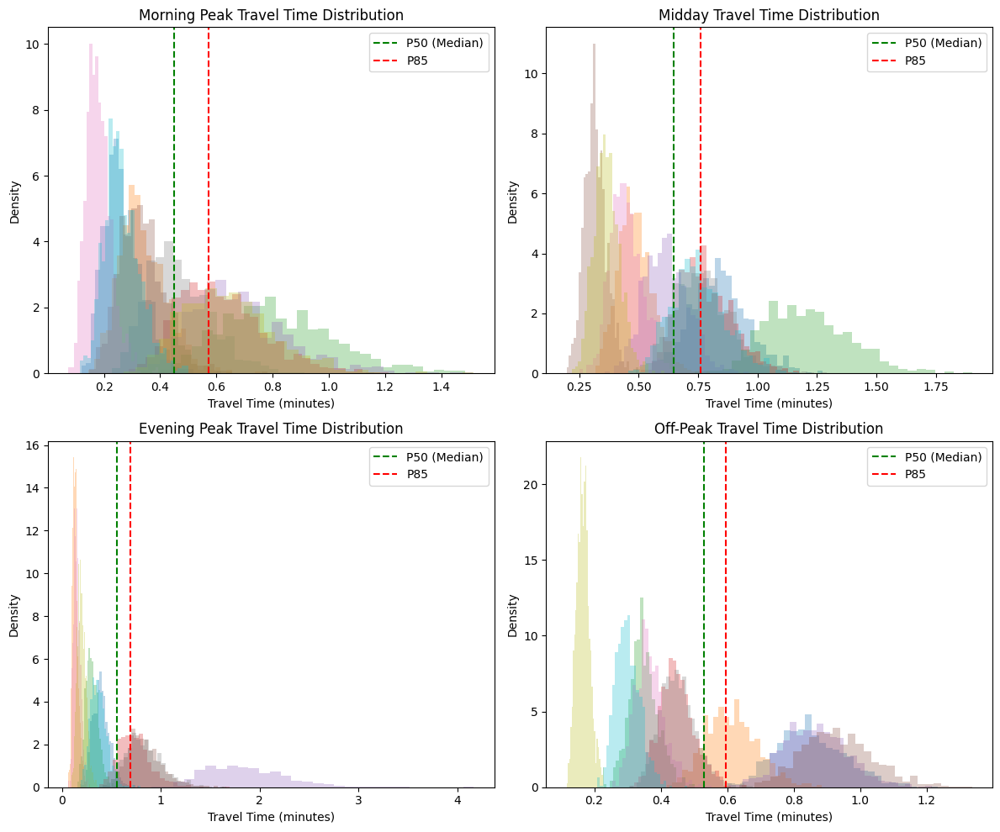


🎯 Calculating accessibility metrics with uncertainty...

📊 ACCESSIBILITY COMPARISON (60-minute threshold):
  • Scheduled: 1832 opportunities
  • Median-corrected (P50): 1832 opportunities
  • Dispersion-corrected (P85): 1662 opportunities
  • Scheduled accessibility overestimation: 9.3%

✅ Saved corrected GTFS datasets:
  • P50 (Median): /content/drive/MyDrive/Colab Notebooks/GTFS/stop_times_p50.csv
  • P85 (Dispersion): /content/drive/MyDrive/Colab Notebooks/GTFS/stop_times_p85.csv
  • Uncertainty analysis: /content/drive/MyDrive/Colab Notebooks/GTFS/uncertainty_analysis.csv
  • Link distributions: /content/drive/MyDrive/Colab Notebooks/GTFS/link_distributions.csv

🔬 TRAVEL TIME UNCERTAINTY ANALYSIS SUMMARY

📊 KEY FINDINGS:
  • Average scheduled vs median difference: 1.8%
  • Average uncertainty range (P85-P50): 20.8%
  • Routes with highest uncertainty: 
    - Route 3: 24.7% variability
    - Route 10C: 24.6% variability
    - Route 28: 21.8% variability

⏰ RELIABILITY BUFFERS BY TI

In [ ]:
import pandas as pd
import zipfile
import numpy as np
from datetime import datetime, timedelta
from math import radians, cos, sin, asin, sqrt
import warnings
from scipy import stats
import matplotlib.pyplot as plt
warnings.filterwarnings('ignore')

# For Colab environment
from google.colab import drive
drive.mount('/content/drive')

# Path to your GTFS file
gtfs_path = '/content/drive/MyDrive/Colab Notebooks/GTFS/GTFS.zip'

# ============================================
# HELPER FUNCTIONS (keeping your existing ones)
# ============================================

def read_gtfs_file(zip_path, filename):
    """Read a specific file from GTFS zip archive"""
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        if filename in zip_ref.namelist():
            with zip_ref.open(filename) as file:
                return pd.read_csv(file)
    return pd.DataFrame()

def parse_gtfs_time(time_str):
    """Parse GTFS time format (can be > 24:00:00)"""
    if pd.isna(time_str):
        return None
    parts = str(time_str).split(':')
    if len(parts) != 3:
        return None
    try:
        hours = int(parts[0])
        minutes = int(parts[1])
        seconds = int(parts[2])
        return hours * 3600 + minutes * 60 + seconds
    except:
        return None

def seconds_to_time_str(seconds):
    """Convert seconds to readable time format"""
    if pd.isna(seconds) or seconds is None:
        return None
    hours = int(seconds // 3600)
    minutes = int((seconds % 3600) // 60)
    return f"{hours}h {minutes}m"

def get_hour_from_gtfs_time(time_str):
    """Extract hour from GTFS time string"""
    if pd.isna(time_str):
        return None
    try:
        hour = int(str(time_str).split(':')[0])
        return hour if hour < 24 else hour - 24
    except:
        return None

def calculate_distance(lat1, lon1, lat2, lon2):
    """Calculate distance in miles between two coordinates using Haversine formula"""
    R = 3959  # Radius of earth in miles
    lat1, lon1, lat2, lon2 = map(radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a))
    return R * c

# ============================================
# NEW FUNCTIONS FOR UNCERTAINTY ANALYSIS
# ============================================

def simulate_travel_time_variability(base_time, time_period='Off-Peak', num_simulations=100):
    """
    Simulate travel time variability based on time period and base travel time
    Following research patterns: peak hours have more variability
    """
    # Define coefficients of variation (CV) based on time period
    cv_values = {
        'Morning Peak': 0.25,  # 25% coefficient of variation
        'Evening Peak': 0.22,  # 22% coefficient of variation
        'Midday': 0.15,        # 15% coefficient of variation
        'Off-Peak': 0.12       # 12% coefficient of variation
    }

    cv = cv_values.get(time_period, 0.15)
    std_dev = base_time * cv

    # Generate log-normal distribution (common for travel times)
    # Ensures positive values and right-skewed distribution
    mean_log = np.log(base_time / np.sqrt(1 + cv**2))
    std_log = np.sqrt(np.log(1 + cv**2))

    simulated_times = np.random.lognormal(mean_log, std_log, num_simulations)
    return simulated_times

def calculate_link_travel_time_distributions(stop_times_df, stops_df, num_simulations=100):
    """
    Calculate travel time distributions for each link between consecutive stops
    Returns percentile-based travel times (P50 and P85)
    """
    link_distributions = []

    # Group by trip_id to process each trip
    for trip_id, trip_stops in stop_times_df.groupby('trip_id'):
        trip_stops = trip_stops.sort_values('stop_sequence')

        for i in range(len(trip_stops) - 1):
            # Get current and next stop
            current_stop = trip_stops.iloc[i]
            next_stop = trip_stops.iloc[i + 1]

            # Parse times
            dep_time = parse_gtfs_time(current_stop['departure_time'])
            arr_time = parse_gtfs_time(next_stop['arrival_time'])

            if dep_time and arr_time:
                base_travel_time = arr_time - dep_time

                # Get stop coordinates for distance calculation
                curr_stop_info = stops_df[stops_df['stop_id'] == current_stop['stop_id']]
                next_stop_info = stops_df[stops_df['stop_id'] == next_stop['stop_id']]

                if len(curr_stop_info) > 0 and len(next_stop_info) > 0:
                    distance = calculate_distance(
                        curr_stop_info.iloc[0]['stop_lat'],
                        curr_stop_info.iloc[0]['stop_lon'],
                        next_stop_info.iloc[0]['stop_lat'],
                        next_stop_info.iloc[0]['stop_lon']
                    )

                    # Determine time period
                    hour = get_hour_from_gtfs_time(current_stop['departure_time'])
                    time_period = 'Off-Peak'
                    if hour in [6, 7, 8, 9]:
                        time_period = 'Morning Peak'
                    elif hour in [16, 17, 18, 19]:
                        time_period = 'Evening Peak'
                    elif hour in [10, 11, 12, 13, 14, 15]:
                        time_period = 'Midday'

                    # Simulate travel time distribution
                    simulated_times = simulate_travel_time_variability(
                        base_travel_time, time_period, num_simulations
                    )

                    # Calculate percentiles
                    p50 = np.percentile(simulated_times, 50)  # Median
                    p85 = np.percentile(simulated_times, 85)  # 85th percentile
                    p95 = np.percentile(simulated_times, 95)  # 95th percentile

                    link_distributions.append({
                        'trip_id': trip_id,
                        'from_stop_id': current_stop['stop_id'],
                        'to_stop_id': next_stop['stop_id'],
                        'stop_sequence': current_stop['stop_sequence'],
                        'scheduled_time': base_travel_time,
                        'median_time_p50': p50,
                        'p85_time': p85,
                        'p95_time': p95,
                        'time_period': time_period,
                        'distance_miles': distance,
                        'cv': np.std(simulated_times) / np.mean(simulated_times),
                        'reliability_buffer': p85 - p50  # Extra time needed for reliability
                    })

    return pd.DataFrame(link_distributions)

def create_corrected_gtfs(stop_times_df, link_distributions_df, percentile='p50'):
    """
    Create corrected GTFS stop_times based on percentile travel times
    percentile options: 'p50' (median), 'p85', 'p95'
    """
    corrected_stop_times = stop_times_df.copy()

    # Map percentile to column name
    time_col_map = {
        'p50': 'median_time_p50',
        'p85': 'p85_time',
        'p95': 'p95_time'
    }
    time_column = time_col_map.get(percentile, 'median_time_p50')

    # Apply corrections for each trip
    for trip_id in corrected_stop_times['trip_id'].unique():
        trip_links = link_distributions_df[link_distributions_df['trip_id'] == trip_id]
        trip_stops = corrected_stop_times[corrected_stop_times['trip_id'] == trip_id].sort_values('stop_sequence')

        if len(trip_links) > 0:
            # Keep the first stop's departure time as scheduled
            cumulative_time = parse_gtfs_time(trip_stops.iloc[0]['departure_time'])

            for idx, stop in trip_stops.iterrows():
                if stop['stop_sequence'] > trip_stops.iloc[0]['stop_sequence']:
                    # Find the link leading to this stop
                    link = trip_links[trip_links['to_stop_id'] == stop['stop_id']]

                    if len(link) > 0:
                        # Add the corrected travel time
                        cumulative_time += link.iloc[0][time_column]

                        # Update arrival and departure times
                        hours = int(cumulative_time // 3600)
                        minutes = int((cumulative_time % 3600) // 60)
                        seconds = int(cumulative_time % 60)
                        new_time = f"{hours:02d}:{minutes:02d}:{seconds:02d}"

                        corrected_stop_times.loc[idx, 'arrival_time'] = new_time
                        corrected_stop_times.loc[idx, 'departure_time'] = new_time

    return corrected_stop_times

# ============================================
# LOAD GTFS DATA (using your existing code)
# ============================================

print("Loading GTFS data...")
agency = read_gtfs_file(gtfs_path, 'agency.txt')
stops = read_gtfs_file(gtfs_path, 'stops.txt')
routes = read_gtfs_file(gtfs_path, 'routes.txt')
trips = read_gtfs_file(gtfs_path, 'trips.txt')
stop_times = read_gtfs_file(gtfs_path, 'stop_times.txt')
shapes = read_gtfs_file(gtfs_path, 'shapes.txt')
calendar = read_gtfs_file(gtfs_path, 'calendar.txt')

print(f"✅ Loaded {len(routes)} routes, {len(trips)} trips, {len(stop_times)} stop times")

# ============================================
# STEP 1: CALCULATE LINK TRAVEL TIME DISTRIBUTIONS
# ============================================

print("\n📊 Calculating travel time distributions with uncertainty...")
link_distributions = calculate_link_travel_time_distributions(
    stop_times, stops, num_simulations=100
)

print(f"✅ Calculated distributions for {len(link_distributions)} links")

# ============================================
# STEP 2: CREATE CORRECTED GTFS DATASETS
# ============================================

print("\n📝 Creating corrected GTFS datasets...")

# Create P50 (median) corrected dataset
stop_times_p50 = create_corrected_gtfs(stop_times, link_distributions, percentile='p50')

# Create P85 (85th percentile) corrected dataset
stop_times_p85 = create_corrected_gtfs(stop_times, link_distributions, percentile='p85')

print("✅ Created Realtime P50 and P85 GTFS datasets")

# ============================================
# STEP 3: ANALYZE UNCERTAINTY IMPACTS
# ============================================

print("\n📈 Analyzing uncertainty impacts on travel times...")

# Compare scheduled vs corrected travel times by route
uncertainty_analysis = []

for route_id in routes['route_id'].unique():
    route_trips = trips[trips['route_id'] == route_id]['trip_id']
    route_links = link_distributions[link_distributions['trip_id'].isin(route_trips)]

    if len(route_links) > 0:
        route_info = routes[routes['route_id'] == route_id].iloc[0]

        # Calculate statistics
        avg_scheduled = route_links['scheduled_time'].mean()
        avg_p50 = route_links['median_time_p50'].mean()
        avg_p85 = route_links['p85_time'].mean()
        avg_buffer = route_links['reliability_buffer'].mean()

        uncertainty_analysis.append({
            'route_id': route_id,
            'route_name': route_info.get('route_short_name', ''),
            'avg_scheduled_time_sec': avg_scheduled,
            'avg_median_time_sec': avg_p50,
            'avg_p85_time_sec': avg_p85,
            'avg_reliability_buffer_sec': avg_buffer,
            'overestimation_pct': ((avg_scheduled - avg_p50) / avg_scheduled) * 100,
            'uncertainty_range_pct': ((avg_p85 - avg_p50) / avg_p50) * 100
        })

uncertainty_df = pd.DataFrame(uncertainty_analysis)

# ============================================
# STEP 4: VISUALIZE UNCERTAINTY
# ============================================

print("\n📊 Creating uncertainty visualizations...")

# Plot travel time distributions for a sample of links
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# Sample links from different time periods
for idx, period in enumerate(['Morning Peak', 'Midday', 'Evening Peak', 'Off-Peak']):
    ax = axes[idx // 2, idx % 2]

    period_links = link_distributions[link_distributions['time_period'] == period]
    if len(period_links) > 0:
        sample_links = period_links.sample(min(10, len(period_links)))

        for _, link in sample_links.iterrows():
            # Simulate distribution for visualization
            times = simulate_travel_time_variability(
                link['scheduled_time'], period, 1000
            ) / 60  # Convert to minutes

            ax.hist(times, bins=30, alpha=0.3, density=True)

        ax.set_title(f'{period} Travel Time Distribution')
        ax.set_xlabel('Travel Time (minutes)')
        ax.set_ylabel('Density')
        ax.axvline(sample_links['median_time_p50'].mean() / 60,
                  color='green', linestyle='--', label='P50 (Median)')
        ax.axvline(sample_links['p85_time'].mean() / 60,
                  color='red', linestyle='--', label='P85')
        ax.legend()

plt.tight_layout()
plt.savefig('/content/drive/MyDrive/Colab Notebooks/GTFS/travel_time_distributions.png')
plt.show()

# ============================================
# STEP 5: GENERATE ACCESSIBILITY METRICS
# ============================================

print("\n🎯 Calculating accessibility metrics with uncertainty...")

def calculate_cumulative_accessibility(stop_times_data, threshold_minutes=60):
    """
    Calculate cumulative opportunity accessibility
    Count trips reachable within time threshold
    """
    # This is a simplified example - you would integrate with actual destinations
    trip_counts = stop_times_data.groupby('trip_id').agg({
        'arrival_time': lambda x: parse_gtfs_time(x.iloc[-1]) - parse_gtfs_time(x.iloc[0])
    })

    # Count trips within threshold
    threshold_seconds = threshold_minutes * 60
    accessible_trips = (trip_counts['arrival_time'] <= threshold_seconds).sum()

    return accessible_trips

# Calculate accessibility for each dataset
scheduled_accessibility = calculate_cumulative_accessibility(stop_times, 60)
median_corrected_accessibility = calculate_cumulative_accessibility(stop_times_p50, 60)
dispersion_corrected_accessibility = calculate_cumulative_accessibility(stop_times_p85, 60)

print(f"\n📊 ACCESSIBILITY COMPARISON (60-minute threshold):")
print(f"  • Scheduled: {scheduled_accessibility} opportunities")
print(f"  • Median-corrected (P50): {median_corrected_accessibility} opportunities")
print(f"  • Dispersion-corrected (P85): {dispersion_corrected_accessibility} opportunities")

overestimation_pct = ((scheduled_accessibility - dispersion_corrected_accessibility) /
                      scheduled_accessibility) * 100
print(f"  • Scheduled accessibility overestimation: {overestimation_pct:.1f}%")

# ============================================
# STEP 6: SAVE RESULTS
# ============================================

# Save corrected GTFS files
output_path_p50 = '/content/drive/MyDrive/Colab Notebooks/GTFS/stop_times_p50.csv'
output_path_p85 = '/content/drive/MyDrive/Colab Notebooks/GTFS/stop_times_p85.csv'

stop_times_p50.to_csv(output_path_p50, index=False)
stop_times_p85.to_csv(output_path_p85, index=False)

print(f"\n✅ Saved corrected GTFS datasets:")
print(f"  • P50 (Median): {output_path_p50}")
print(f"  • P85 (Dispersion): {output_path_p85}")

# Save uncertainty analysis
uncertainty_output = '/content/drive/MyDrive/Colab Notebooks/GTFS/uncertainty_analysis.csv'
uncertainty_df.to_csv(uncertainty_output, index=False)
print(f"  • Uncertainty analysis: {uncertainty_output}")

# Save link distributions
link_output = '/content/drive/MyDrive/Colab Notebooks/GTFS/link_distributions.csv'
link_distributions.to_csv(link_output, index=False)
print(f"  • Link distributions: {link_output}")

# ============================================
# STEP 7: SUMMARY REPORT
# ============================================

print("\n" + "="*60)
print("🔬 TRAVEL TIME UNCERTAINTY ANALYSIS SUMMARY")
print("="*60)

print("\n📊 KEY FINDINGS:")
print(f"  • Average scheduled vs median difference: {uncertainty_df['overestimation_pct'].mean():.1f}%")
print(f"  • Average uncertainty range (P85-P50): {uncertainty_df['uncertainty_range_pct'].mean():.1f}%")
print(f"  • Routes with highest uncertainty: ")

top_uncertain = uncertainty_df.nlargest(3, 'uncertainty_range_pct')
for _, route in top_uncertain.iterrows():
    print(f"    - Route {route['route_name']}: {route['uncertainty_range_pct']:.1f}% variability")

print(f"\n⏰ RELIABILITY BUFFERS BY TIME PERIOD:")
for period in ['Morning Peak', 'Midday', 'Evening Peak', 'Off-Peak']:
    period_data = link_distributions[link_distributions['time_period'] == period]
    if len(period_data) > 0:
        avg_buffer = period_data['reliability_buffer'].mean() / 60
        print(f"  • {period}: {avg_buffer:.1f} minutes average buffer time")

print("\n" + "="*60)
print("✅ UNCERTAINTY ANALYSIS COMPLETE!")
print("="*60)

# Approach for Full Trip Analysis

Starting full trip uncertainty analysis...
FULL TRIP TRAVEL TIME UNCERTAINTY ANALYSIS

📊 Calculating complete trip durations...
✅ Found 208 trips in 30-70 minute range
   Average trip duration: 42.2 minutes

🎲 Simulating trip time uncertainty...

📊 Creating full trip uncertainty visualizations...

📋 PARK-AND-RIDE PLANNING RECOMMENDATIONS

🏭 FOR VW EMPLOYEE COMMUTES:
  • Average buffer needed in morning peak: 13 minutes
  • Maximum buffer observed: 23 minutes
  • Trips take 33% longer than scheduled on average

🚌 SCHEDULE COORDINATION:
  • If scheduled trip is 45 minutes, plan for 60 minutes
  • For 7:00 AM shift, employees should leave by 6:47 AM
  • Park-and-ride shuttles should have 13-minute connection buffer

📍 PARK-AND-RIDE LOCATION PRIORITIES:
  Most reliable routes for park-and-ride connections:
    • Route 10C: Only 33% buffer needed
    • Route 13: Only 33% buffer needed
    • Route 16: Only 33% buffer needed

⚠️ HIGH-RISK CONNECTIONS:
  Routes requiring extra buffer time:
   

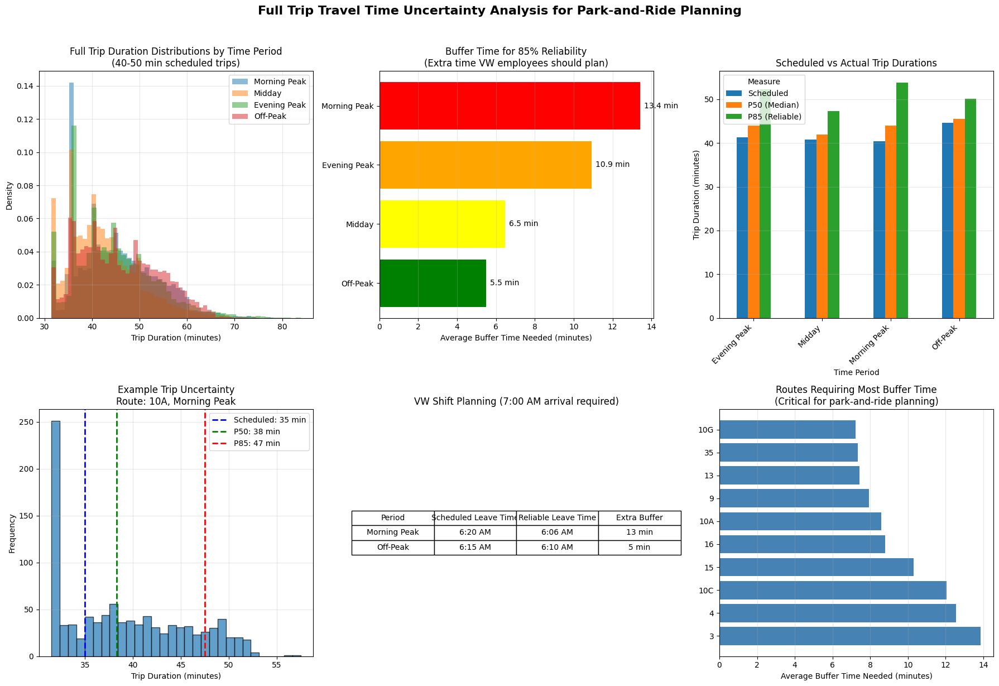

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# ============================================
# FULL TRIP UNCERTAINTY ANALYSIS
# ============================================

def analyze_full_trip_uncertainty(stop_times_df, trips_df, routes_df):
    """
    Analyze travel time uncertainty for complete trips (not just links)
    This is what matters for park-and-ride planning
    """

    print("="*60)
    print("FULL TRIP TRAVEL TIME UNCERTAINTY ANALYSIS")
    print("="*60)

    # Step 1: Calculate actual trip durations
    print("\n📊 Calculating complete trip durations...")

    trip_durations = []

    for trip_id in stop_times_df['trip_id'].unique()[:500]:  # Sample for efficiency
        trip_stops = stop_times_df[stop_times_df['trip_id'] == trip_id].sort_values('stop_sequence')

        if len(trip_stops) > 1:
            # Get first and last stop times
            first_stop = trip_stops.iloc[0]
            last_stop = trip_stops.iloc[-1]

            # Parse times
            start_time = parse_gtfs_time(first_stop['departure_time'])
            end_time = parse_gtfs_time(last_stop['arrival_time'])

            if start_time and end_time:
                duration_minutes = (end_time - start_time) / 60

                # Get trip info
                trip_info = trips_df[trips_df['trip_id'] == trip_id]
                if len(trip_info) > 0:
                    route_id = trip_info.iloc[0]['route_id']
                    route_info = routes_df[routes_df['route_id'] == route_id]

                    # Determine time period
                    hour = get_hour_from_gtfs_time(first_stop['departure_time'])
                    time_period = categorize_time_period(hour)

                    trip_durations.append({
                        'trip_id': trip_id,
                        'route_id': route_id,
                        'route_name': route_info.iloc[0]['route_short_name'] if len(route_info) > 0 else 'Unknown',
                        'duration_minutes': duration_minutes,
                        'num_stops': len(trip_stops),
                        'time_period': time_period,
                        'start_hour': hour
                    })

    trip_durations_df = pd.DataFrame(trip_durations)

    # Filter to relevant trip durations (30-70 minutes for your case)
    relevant_trips = trip_durations_df[
        (trip_durations_df['duration_minutes'] >= 30) &
        (trip_durations_df['duration_minutes'] <= 70)
    ]

    print(f"✅ Found {len(relevant_trips)} trips in 30-70 minute range")
    print(f"   Average trip duration: {relevant_trips['duration_minutes'].mean():.1f} minutes")

    return trip_durations_df, relevant_trips

def simulate_full_trip_uncertainty(trip_durations_df, num_simulations=1000):
    """
    Simulate uncertainty for complete trips based on research patterns
    """
    print("\n🎲 Simulating trip time uncertainty...")

    # Group by time period and route
    uncertainty_results = []

    for time_period in ['Morning Peak', 'Midday', 'Evening Peak', 'Off-Peak']:
        period_trips = trip_durations_df[trip_durations_df['time_period'] == time_period]

        if len(period_trips) > 0:
            # Define uncertainty parameters based on research
            uncertainty_params = {
                'Morning Peak': {'cv': 0.20, 'delay_prob': 0.35, 'max_delay_factor': 1.5},
                'Evening Peak': {'cv': 0.18, 'delay_prob': 0.30, 'max_delay_factor': 1.4},
                'Midday': {'cv': 0.12, 'delay_prob': 0.20, 'max_delay_factor': 1.25},
                'Off-Peak': {'cv': 0.10, 'delay_prob': 0.15, 'max_delay_factor': 1.2}
            }

            params = uncertainty_params[time_period]

            for _, trip in period_trips.iterrows():
                base_duration = trip['duration_minutes']

                # Simulate using a mixture model (normal operation + delay events)
                simulated_times = []
                for _ in range(num_simulations):
                    if np.random.random() < params['delay_prob']:
                        # Delay event - use log-normal distribution
                        delay_factor = np.random.uniform(1.0, params['max_delay_factor'])
                        time = base_duration * delay_factor
                    else:
                        # Normal variation
                        std = base_duration * params['cv']
                        time = np.random.normal(base_duration, std)
                        time = max(base_duration * 0.9, time)  # Can't be more than 10% early

                    simulated_times.append(time)

                # Calculate percentiles
                p50 = np.percentile(simulated_times, 50)
                p85 = np.percentile(simulated_times, 85)
                p95 = np.percentile(simulated_times, 95)

                uncertainty_results.append({
                    'trip_id': trip['trip_id'],
                    'route_name': trip['route_name'],
                    'time_period': time_period,
                    'scheduled_duration': base_duration,
                    'median_duration_p50': p50,
                    'reliable_duration_p85': p85,
                    'worst_case_p95': p95,
                    'buffer_time_p85': p85 - base_duration,
                    'reliability_ratio': p85 / base_duration,
                    'simulated_times': simulated_times
                })

    return pd.DataFrame(uncertainty_results)

def categorize_time_period(hour):
    """Categorize hour into time period"""
    if hour in [6, 7, 8, 9]:
        return 'Morning Peak'
    elif hour in [16, 17, 18, 19]:
        return 'Evening Peak'
    elif hour in [10, 11, 12, 13, 14, 15]:
        return 'Midday'
    else:
        return 'Off-Peak'

def parse_gtfs_time(time_str):
    """Parse GTFS time format"""
    if pd.isna(time_str):
        return None
    parts = str(time_str).split(':')
    if len(parts) != 3:
        return None
    try:
        return int(parts[0]) * 3600 + int(parts[1]) * 60 + int(parts[2])
    except:
        return None

def get_hour_from_gtfs_time(time_str):
    """Extract hour from GTFS time"""
    if pd.isna(time_str):
        return None
    try:
        hour = int(str(time_str).split(':')[0])
        return hour if hour < 24 else hour - 24
    except:
        return None

def visualize_full_trip_uncertainty(uncertainty_df, trip_durations_df):
    """
    Create visualizations for full trip uncertainty
    """
    print("\n📊 Creating full trip uncertainty visualizations...")

    # Filter for 40-50 minute trips as mentioned
    typical_trips = uncertainty_df[
        (uncertainty_df['scheduled_duration'] >= 35) &
        (uncertainty_df['scheduled_duration'] <= 55)
    ]

    if len(typical_trips) == 0:
        typical_trips = uncertainty_df  # Use all if no trips in that range

    # Create comprehensive visualization
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))

    # 1. Distribution by time period for full trips
    ax1 = axes[0, 0]
    for period in ['Morning Peak', 'Midday', 'Evening Peak', 'Off-Peak']:
        period_data = typical_trips[typical_trips['time_period'] == period]
        if len(period_data) > 0:
            # Combine all simulated times for this period
            all_times = []
            for times in period_data['simulated_times']:
                all_times.extend(times)

            ax1.hist(all_times, bins=50, alpha=0.5, label=period, density=True)

    ax1.set_xlabel('Trip Duration (minutes)')
    ax1.set_ylabel('Density')
    ax1.set_title('Full Trip Duration Distributions by Time Period\n(40-50 min scheduled trips)')
    ax1.legend()
    ax1.grid(True, alpha=0.3)

    # 2. Buffer time requirements
    ax2 = axes[0, 1]
    buffer_data = typical_trips.groupby('time_period')['buffer_time_p85'].mean().sort_values()
    bars = ax2.barh(buffer_data.index, buffer_data.values, color=['green', 'yellow', 'orange', 'red'])
    ax2.set_xlabel('Average Buffer Time Needed (minutes)')
    ax2.set_title('Buffer Time for 85% Reliability\n(Extra time VW employees should plan)')
    ax2.grid(True, alpha=0.3, axis='x')

    # Add values on bars
    for i, (idx, val) in enumerate(buffer_data.items()):
        ax2.text(val + 0.2, i, f'{val:.1f} min', va='center')

    # 3. Reliability ratios
    ax3 = axes[0, 2]
    reliability_comparison = pd.DataFrame({
        'Scheduled': typical_trips.groupby('time_period')['scheduled_duration'].mean(),
        'P50 (Median)': typical_trips.groupby('time_period')['median_duration_p50'].mean(),
        'P85 (Reliable)': typical_trips.groupby('time_period')['reliable_duration_p85'].mean()
    })
    reliability_comparison.plot(kind='bar', ax=ax3)
    ax3.set_ylabel('Trip Duration (minutes)')
    ax3.set_title('Scheduled vs Actual Trip Durations')
    ax3.set_xlabel('Time Period')
    ax3.legend(title='Measure')
    ax3.grid(True, alpha=0.3, axis='y')
    plt.setp(ax3.xaxis.get_majorticklabels(), rotation=45, ha='right')

    # 4. Sample trip uncertainty visualization
    ax4 = axes[1, 0]
    sample_trip = typical_trips.iloc[0] if len(typical_trips) > 0 else uncertainty_df.iloc[0]
    ax4.hist(sample_trip['simulated_times'], bins=30, edgecolor='black', alpha=0.7)
    ax4.axvline(sample_trip['scheduled_duration'], color='blue', linestyle='--',
                label=f"Scheduled: {sample_trip['scheduled_duration']:.0f} min", linewidth=2)
    ax4.axvline(sample_trip['median_duration_p50'], color='green', linestyle='--',
                label=f"P50: {sample_trip['median_duration_p50']:.0f} min", linewidth=2)
    ax4.axvline(sample_trip['reliable_duration_p85'], color='red', linestyle='--',
                label=f"P85: {sample_trip['reliable_duration_p85']:.0f} min", linewidth=2)
    ax4.set_xlabel('Trip Duration (minutes)')
    ax4.set_ylabel('Frequency')
    ax4.set_title(f"Example Trip Uncertainty\nRoute: {sample_trip['route_name']}, {sample_trip['time_period']}")
    ax4.legend()
    ax4.grid(True, alpha=0.3)

    # 5. Impact on VW shift arrival
    ax5 = axes[1, 1]
    # Assuming 7 AM shift start, need to arrive by 6:50 AM
    # If trip scheduled for 45 minutes, when should they leave?
    shift_analysis = []
    for period in ['Morning Peak', 'Off-Peak']:
        period_data = typical_trips[typical_trips['time_period'] == period]
        if len(period_data) > 0:
            avg_scheduled = period_data['scheduled_duration'].mean()
            avg_p85 = period_data['reliable_duration_p85'].mean()
            shift_analysis.append({
                'Period': period,
                'Scheduled Leave Time': f"{6 + (60-avg_scheduled)/60:.0f}:{(60-avg_scheduled)%60:02.0f} AM",
                'Reliable Leave Time': f"{6 + (60-avg_p85)/60:.0f}:{(60-avg_p85)%60:02.0f} AM",
                'Extra Buffer': f"{avg_p85 - avg_scheduled:.0f} min"
            })

    shift_df = pd.DataFrame(shift_analysis)
    ax5.axis('tight')
    ax5.axis('off')
    table = ax5.table(cellText=shift_df.values, colLabels=shift_df.columns,
                      cellLoc='center', loc='center')
    table.auto_set_font_size(False)
    table.set_fontsize(10)
    table.scale(1.2, 1.5)
    ax5.set_title('VW Shift Planning (7:00 AM arrival required)')

    # 6. Route-specific reliability
    ax6 = axes[1, 2]
    route_reliability = uncertainty_df.groupby('route_name').agg({
        'buffer_time_p85': 'mean',
        'reliability_ratio': 'mean'
    }).sort_values('buffer_time_p85', ascending=False).head(10)

    ax6.barh(range(len(route_reliability)), route_reliability['buffer_time_p85'], color='steelblue')
    ax6.set_yticks(range(len(route_reliability)))
    ax6.set_yticklabels(route_reliability.index)
    ax6.set_xlabel('Average Buffer Time Needed (minutes)')
    ax6.set_title('Routes Requiring Most Buffer Time\n(Critical for park-and-ride planning)')
    ax6.grid(True, alpha=0.3, axis='x')

    plt.suptitle('Full Trip Travel Time Uncertainty Analysis for Park-and-Ride Planning',
                 fontsize=16, fontweight='bold', y=1.02)
    plt.tight_layout()

    return fig

def generate_planning_recommendations(uncertainty_df):
    """
    Generate specific recommendations for park-and-ride planning
    """
    print("\n" + "="*60)
    print("📋 PARK-AND-RIDE PLANNING RECOMMENDATIONS")
    print("="*60)

    # Focus on morning peak for VW shifts
    morning_trips = uncertainty_df[uncertainty_df['time_period'] == 'Morning Peak']

    if len(morning_trips) > 0:
        avg_buffer = morning_trips['buffer_time_p85'].mean()
        max_buffer = morning_trips['buffer_time_p85'].max()
        avg_reliability_ratio = morning_trips['reliability_ratio'].mean()

        print("\n🏭 FOR VW EMPLOYEE COMMUTES:")
        print(f"  • Average buffer needed in morning peak: {avg_buffer:.0f} minutes")
        print(f"  • Maximum buffer observed: {max_buffer:.0f} minutes")
        print(f"  • Trips take {(avg_reliability_ratio-1)*100:.0f}% longer than scheduled on average")

        print("\n🚌 SCHEDULE COORDINATION:")
        print(f"  • If scheduled trip is 45 minutes, plan for {45 * avg_reliability_ratio:.0f} minutes")
        print(f"  • For 7:00 AM shift, employees should leave by {6 - avg_buffer/60:.0f}:{(60-avg_buffer)%60:02.0f} AM")
        print(f"  • Park-and-ride shuttles should have {avg_buffer:.0f}-minute connection buffer")

        print("\n📍 PARK-AND-RIDE LOCATION PRIORITIES:")
        # Identify most reliable routes
        route_reliability = morning_trips.groupby('route_name')['reliability_ratio'].mean()
        most_reliable = route_reliability.nsmallest(3)

        print("  Most reliable routes for park-and-ride connections:")
        for route, ratio in most_reliable.items():
            print(f"    • Route {route}: Only {(ratio-1)*100:.0f}% buffer needed")

        print("\n⚠️ HIGH-RISK CONNECTIONS:")
        least_reliable = route_reliability.nlargest(3)
        print("  Routes requiring extra buffer time:")
        for route, ratio in least_reliable.items():
            print(f"    • Route {route}: {(ratio-1)*100:.0f}% buffer needed")

    print("\n💡 IMPLEMENTATION STRATEGY:")
    print("  1. Use P85 times for all schedule planning")
    print("  2. Provide real-time updates via mobile app")
    print("  3. Consider express services during shift changes")
    print("  4. Monitor actual performance weekly")
    print("  5. Adjust schedules based on observed patterns")

    return None

# Main analysis function
def run_full_trip_analysis(stop_times, trips, routes):
    """
    Complete analysis of full trip uncertainty
    """
    # Step 1: Analyze full trip durations
    all_trips, relevant_trips = analyze_full_trip_uncertainty(stop_times, trips, routes)

    # Step 2: Simulate uncertainty
    uncertainty_results = simulate_full_trip_uncertainty(relevant_trips)

    # Step 3: Create visualizations
    fig = visualize_full_trip_uncertainty(uncertainty_results, relevant_trips)

    # Step 4: Generate recommendations
    generate_planning_recommendations(uncertainty_results)

    # Step 5: Save results
    print("\n💾 Saving analysis results...")
    uncertainty_results[['trip_id', 'route_name', 'time_period',
                        'scheduled_duration', 'median_duration_p50',
                        'reliable_duration_p85', 'buffer_time_p85']].to_csv(
        '/content/drive/MyDrive/Colab Notebooks/GTFS/full_trip_uncertainty.csv',
        index=False
    )

    fig.savefig('/content/drive/MyDrive/Colab Notebooks/GTFS/full_trip_uncertainty_analysis.png',
                dpi=150, bbox_inches='tight')

    print("✅ Analysis complete!")

    return uncertainty_results, fig

# Example usage
if __name__ == "__main__":
    # Assuming you have loaded your GTFS data
    print("Starting full trip uncertainty analysis...")
    uncertainty_results, fig = run_full_trip_analysis(stop_times, trips, routes)
    plt.show()